## CIS 580, Machine Perception, Spring 2023
### Homework 5
#### Due: Thursday April 27th 2023, 11:59pm ET

Instructions: Create a folder in your Google Drive and place inside this .ipynb file. Open the jupyter notebook with Google Colab. Refrain from using a GPU during implementing and testing the whole thing. You should switch to a GPU runtime only when performing the final training (of the 2D image or the NeRF) to avoid GPU usage runouts. 

### Part 1: Fitting a 2D Image

In [ ]:
import numpy as np
import os
import torch
import torch.nn as nn
import torch.nn.functional as F
import matplotlib.pyplot as plt
import imageio.v2 as imageio
import time
import gdown

device = torch.device("cuda" if torch.cuda.is_available() else "cpu")
print(device)

cuda


We first download the image from the web. We normalize the image so the pixels are in between the range of [0,1].

In [ ]:
url = "https://drive.google.com/file/d/1-Cugk9WiFX2CPjWG5taX3868Gdd0PEVT/view?usp=share_link"
gdown.download(url=url, output='starry_night.jpg', quiet=False, fuzzy=True)

# Load painting image
painting = imageio.imread("starry_night.jpg")
painting = torch.from_numpy(np.array(painting, dtype=np.float32)/255.).to(device)
height_painting, width_painting = painting.shape[:2]

Downloading...
From: https://drive.google.com/uc?id=1-Cugk9WiFX2CPjWG5taX3868Gdd0PEVT
To: /content/starry_night.jpg
100%|██████████| 5.65k/5.65k [00:00<00:00, 17.7MB/s]


1.1 Complete the function positional_encoding()

In [ ]:
def positional_encoding(x, num_frequencies=6, incl_input=True):
    
    """
    Apply positional encoding to the input.
    
    Args:
    x (torch.Tensor): Input tensor to be positionally encoded. 
      The dimension of x is [N, D], where N is the number of input coordinates,
      and D is the dimension of the input coordinate.
    num_frequencies (optional, int): The number of frequencies used in
     the positional encoding (default: 6).
    incl_input (optional, bool): If True, concatenate the input with the 
        computed positional encoding (default: True).

    Returns:
    (torch.Tensor): Positional encoding of the input tensor. 
    """
    
    results = []
    if incl_input:
        results.append(x)
    #############################  TODO 1(a) BEGIN  ############################
    # encode input tensor and append the encoded tensor to the list of results.
    
    # # print(x.shape,"input")
    # D=x.shape[1]
    # # print("D",D)
    # # print(num_frequencies,"freq")

    # for i in range(num_frequencies):
    #     freq = 2 ** i
    #     results.append(torch.sin(freq * torch.pi * x))
    #     results.append(torch.cos(freq * torch.pi * x))
    # # print(torch.cat(results, dim=-1).shape,"pos")


    N, D = x.shape
    exponents = torch.arange(num_frequencies,device=device).view(-1, 1, 1)  # shape: (num_frequencies, 1, 1)
    frequencies = 2 ** exponents  # shape: (num_frequencies, 1, 1)

    x_expanded = x.unsqueeze(0)  # reshape x, shape: (1, N, D)

    # Broadcasting the multiplication, result shape: (num_frequencies, N, D)
    sin_input = (frequencies * torch.pi * x_expanded)
    cos_input = (frequencies * torch.pi * x_expanded)

    # Calculate sin and cos, result shape: (num_frequencies, N, D)
    sin_results = torch.sin(sin_input)
    cos_results = torch.cos(cos_input)

    # Concatenate sin and cos results along the last dimension, result shape: (num_frequencies, N, 2 * D)
    results = torch.cat((sin_results, cos_results), dim=-1)

    # Reshape the tensor, result shape: (N, num_frequencies * 2 * D)
    results = results.permute(1, 0, 2).reshape(N, -1)

    if incl_input:
        results = torch.cat((x, results), dim=-1)

    return results

    

    #############################  TODO 1(a) END  ##############################
    return torch.cat(results, dim=-1)

1.2 Complete the class model_2d() that will be used to fit the 2D image.


In [ ]:
# class model_2d(nn.Module):
    
#     """
#     Define a 2D model comprising of three fully connected layers,
#     two relu activations and one sigmoid activation.
#     """
    
#     def __init__(self, filter_size=128, num_frequencies=6):
#         super().__init__()
#         #############################  TODO 1(b) BEGIN  ############################


#         self.num_frequencies = num_frequencies
#         self.filter_size = filter_size
#         self.layer1 = nn.Linear((2*self.num_frequencies*2)+2, filter_size)  # Initialized with dummy input size, will be updated in forward()
#         self.layer2 = nn.Linear(filter_size, filter_size)
#         self.layer3 = nn.Linear(filter_size, 3)  # Output size is 3 for RGB color
        
       


#         #############################  TODO 1(b) END  ##############################        

#     def forward(self, x):
#         #############################  TODO 1(b) BEGIN  ############################
#         x = positional_encoding(x, num_frequencies=self.num_frequencies)  # Apply positional encoding

#         if self.layer1.in_features != x.shape[1]:
#             self.layer1 = nn.Linear(x.shape[1], self.filter_size)

#         x = torch.relu(self.layer1(x))
#         x = torch.relu(self.layer2(x))
#         x = torch.sigmoid(self.layer3(x))    

     

#         #############################  TODO 1(b) END  ##############################  
#         return x  

You need to complete 1.1 and 1.2 first before completing the train_2d_model function. Don't forget to transfer the completed functions from 1.1 and 1.2 to the part1.py file and upload it to the autograder. 

Fill the gaps in the train_2d_model() function to train the model to fit the 2D image. 

In [ ]:
# def train_2d_model(test_img, num_frequencies, device, model=model_2d, positional_encoding=positional_encoding, show=True):

#     # Optimizer parameters
#     lr = 5e-4
#     iterations = 10000
#     height, width = test_img.shape[:2]

#     # Number of iters after which stats are displayed
#     display = 2000  
    
#     # Define the model and initialize its weights.
#     model2d = model(num_frequencies=num_frequencies)
#     model2d.to(device)

#     def weights_init(m):
#         if isinstance(m, nn.Linear):
#             torch.nn.init.xavier_uniform_(m.weight)

#     model2d.apply(weights_init)

#     #############################  TODO 1(c) BEGIN  ############################
#     # Define the optimizer
#     optimizer = torch.optim.Adam(model2d.parameters(), lr=lr)

#     #############################  TODO 1(c) END  ############################

#     # Seed RNG, for repeatability
#     seed = 5670
#     torch.manual_seed(seed)
#     np.random.seed(seed)

#     # Lists to log metrics etc.
#     psnrs = []
#     iternums = []

#     t = time.time()
#     t0 = time.time()

#     #############################  TODO 1(c) BEGIN  ############################
#     # Create the 2D normalized coordinates, and apply positional encoding to them
#     coords = torch.stack(torch.meshgrid(torch.linspace(-1, 1, height), torch.linspace(-1, 1, width)), dim=-1)
#     coords = coords.to(device)
#     encoded_coords = positional_encoding(coords.reshape(-1, 2), num_frequencies=num_frequencies)
   





#     #############################  TODO 1(c) END  ############################

#     for i in range(iterations+1):
#         optimizer.zero_grad()
#         #############################  TODO 1(c) BEGIN  ############################
#         # Run one iteration
#         pred = model2d(encoded_coords)
#         pred = pred.view(height, width, 3)
        

#         # Compute mean-squared error between the predicted and target images. Backprop!
#         loss = torch.mean((pred - test_img) ** 2)
#         loss.backward()
#         optimizer.step()



#         #############################  TODO 1(c) END  ############################

#         # Display images/plots/stats
#         if i % display == 0 and show:
#             #############################  TODO 1(c) BEGIN  ############################
#             # Calculate psnr
#             mse = loss.item()
#             psnr = 20 * torch.log10(1.0 / torch.sqrt(torch.tensor(mse)))

#             #############################  TODO 1(c) END  ############################

#             print("Iteration %d " % i, "Loss: %.4f " % loss.item(), "PSNR: %.2f" % psnr.item(), \
#                 "Time: %.2f secs per iter" % ((time.time() - t) / display), "%.2f secs in total" % (time.time() - t0))
#             t = time.time()

#             psnrs.append(psnr.item())
#             iternums.append(i)

#             plt.figure(figsize=(13, 4))
#             plt.subplot(131)
#             plt.imshow(pred.detach().cpu().numpy())
#             plt.title(f"Iteration {i}")
#             plt.subplot(132)
#             plt.imshow(test_img.cpu().numpy())
#             plt.title("Target image")
#             plt.subplot(133)
#             plt.plot(iternums, psnrs)
#             plt.title("PSNR")
#             plt.show()

#     print('Done!')
#     return pred.detach().cpu()

Train the model to fit the given image without applying positional encoding to the input, and by applying positional encoding of two different frequencies to the input; L = 2 and L = 6.

In [ ]:
# _ = train_2d_model(test_img=painting, num_frequencies=6, device=device)

### Part 2: Fitting a 3D Image

In [ ]:
import os
import gdown
import numpy as np
import torch
import torch.nn as nn
import matplotlib.pyplot as plt
import torch.nn.functional as F
import time

device = torch.device("cuda" if torch.cuda.is_available() else "cpu")
print(device)

cuda


In [ ]:
url = "https://drive.google.com/file/d/15W2EK8LooxTMfD0v5vo2BnBMse5ZzlVj/view?usp=share_link"
gdown.download(url=url, output='lego_data.npz', quiet=False, fuzzy=True)

Downloading...
From: https://drive.google.com/uc?id=15W2EK8LooxTMfD0v5vo2BnBMse5ZzlVj
To: /content/lego_data.npz
100%|██████████| 12.7M/12.7M [00:00<00:00, 78.7MB/s]


'lego_data.npz'

Here, we load the data that is comprised by the images, the R and T matrices of each camera position with respect to the world coordinates and the intrinsics parameters K of the camera.

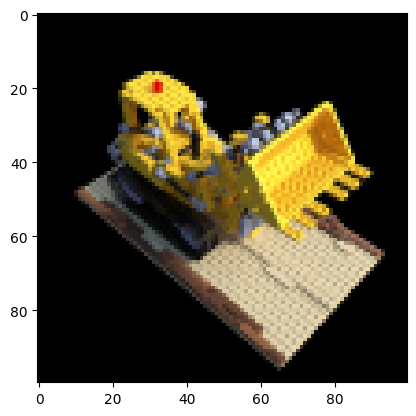

In [ ]:
# Load input images, poses, and intrinsics
data = np.load("lego_data.npz")

# Images
images = data["images"]

# Height and width of each image
height, width = images.shape[1:3]

# Camera extrinsics (poses)
poses = data["poses"]
poses = torch.from_numpy(poses).to(device)

# Camera intrinsics
intrinsics = data["intrinsics"]
intrinsics = torch.from_numpy(intrinsics).to(device)

# Hold one image out (for test).
test_image, test_pose = images[101], poses[101]
test_image = torch.from_numpy(test_image).to(device)

# Map images to device
images = torch.from_numpy(images[:100, ..., :3]).to(device)

plt.imshow(test_image.detach().cpu().numpy())
plt.show()

2.1 Complete the following function that calculates the rays that pass through all the pixels of an HxW image

In [ ]:
def get_rays(height, width, intrinsics, Rcw, Tcw):
    
    """
    Compute the origin and direction of rays passing through all pixels of an image (one ray per pixel).

    Args:
    height: the height of an image.
    width: the width of an image.
    intrinsics: camera intrinsics matrix of shape (3, 3).
    Rcw: Rotation matrix of shape (3,3) from camera to world coordinates.
    Tcw: Translation vector of shape (3,1) that transforms

    Returns:
    ray_origins (torch.Tensor): A tensor of shape (height, width, 3) denoting the centers of
      each ray. Note that desipte that all ray share the same origin, here we ask you to return 
      the ray origin for each ray as (height, width, 3).
    ray_directions (torch.Tensor): A tensor of shape (height, width, 3) denoting the
      direction of each ray.
    """

    device = intrinsics.device
    ray_directions = torch.zeros((height, width, 3), device=device)  # placeholder
    ray_origins = torch.zeros((height, width, 3), device=device)  # placeholder
    
    #############################  TODO 2.1 BEGIN  ##########################
#     v_coords, u_coords = torch.meshgrid(torch.arange(height, dtype=torch.float32),
# torch.arange(width, dtype=torch.float32))


#     # Stack coordinates to create homogeneous coordinates
#     image_coords = torch.stack([ v_coords,u_coords, torch.ones_like(u_coords)], dim=-1)
#     # print("image coords",image_coords)


#     # Reshape image coordinates for matrix multiplication
#     image_coords=image_coords.reshape(-1,3).to(device)
#     # print("image_coords",image_coords)


#     # # Compute ray directions in camera coordinates
#     cam_ray_dirs = torch.matmul(torch.inverse(intrinsics).to(device), image_coords.t()).t()
#     # print("cam_ray_dirs",cam_ray_dirs)

#     # # Compute world ray directions
#     world_ray_dirs = torch.matmul(Rcw, cam_ray_dirs.t()).t() + Tcw.view(1, 1,-1)
#     # print("torch.matmul(Rcw, cam_ray_dirs.t())",torch.matmul(Rcw, cam_ray_dirs.t()))
#     # print("torch.matmul(Rcw, cam_ray_dirs.t()).t()",torch.matmul(Rcw, cam_ray_dirs.t()).t())
#     # print("Tcw.view(1, 1,-1)",Tcw.view(1, 1,-1))
#     # print("world_ray_dirs",world_ray_dirs)




#     # # Assign ray directions and origins
#     ray_directions = world_ray_dirs.view(height, width,3)
#     # print("ray_directions",ray_directions)
#     ray_origins = Tcw.squeeze().expand(height, width,3)

#     return ray_origins, ray_directions

    inv_intrinsics = np.linalg.inv(intrinsics.cpu().numpy())
    for px in range(width):
      for py in range(height):
        ray_origins[py][px] = Tcw
        calibrated_coords = torch.tensor(inv_intrinsics @ np.array([px, py, 1]), device=Rcw.device, dtype=torch.float32)#inv_intrinsics @ np.array([px, py, 1])
        direction = Rcw @ calibrated_coords
        ray_directions[py][px] = direction

    
    #############################  TODO 2.1 END  ############################
    return ray_origins, ray_directions

In [ ]:
# import torch

# # Test values
# height, width = 4, 5
# a=torch.tensor([[ 1.00, 0.00,  0.00],
#                     [0.00,  1.00,  0.00],
#                     [0.00, 0.00,  1.00]])
# intrinsics = torch.inverse(a) #torch.tensor([[554.382712,   0.,         320.5],
#                               #  [  0.,       554.382712,  240.5],
#                               #  [  0.,         0.,          1. ]])
# Rwc = torch.inverse(a)
# Twc = torch.tensor([[ 1],
#                     [1],
#                     [ 0]])

# ray_origins, ray_directions = get_rays(height, width, intrinsics, Rwc, Twc)
# print(ray_origins.shape)  # Expected output: torch.Size([480, 640, 3])
# print(ray_directions.shape)  # Expected output: torch.Size([480, 640, 3])

Complete the next function to visualize how is the dataset created. You will be able to see from which point of view each image has been captured for the 3D object. What we want to achieve here, is to being able to interpolate between these given views and synthesize new realistic views of the 3D object.

In [ ]:
data["poses"][0]

array([[-9.9990219e-01, -4.1922452e-03,  1.3345719e-02, -1.7932774e-02],
       [-1.3988681e-02,  2.9965907e-01, -9.5394367e-01,  1.2818235e+00],
       [-4.6566129e-10, -9.5403719e-01, -2.9968831e-01,  4.0269411e-01],
       [ 0.0000000e+00, -0.0000000e+00, -0.0000000e+00,  1.0000000e+00]],
      dtype=float32)

In [ ]:
# def plot_all_poses(poses):
    
#     #############################  TODO 2.1 BEGIN  ############################

#     # Compute ray origins and directions for all camera poses
#     all_origins, all_directions = [], []
#     for pose in poses:
#         R = torch.tensor(pose[:3, :3], dtype=torch.float).to(device)
#         print(R.shape)
#         T = torch.tensor(pose[:3, 3].flatten(), dtype=torch.float).to(device)
#         ray_origins, ray_directions = get_rays(height, width, intrinsics, R, T)
#         all_origins.append(ray_origins)
#         all_directions.append(ray_directions)
    
#     origins = torch.stack(all_origins, dim=0)  # shape: (num_poses, height, width, 3)
#     directions = torch.stack(all_directions, dim=0)  # shape: (num_poses, height, width, 3)

    


    
   


#     #############################  TODO 2.1 END  ############################

#     ax = plt.figure(figsize=(12, 8)).add_subplot(projection='3d')
#     _ = ax.quiver(origins[..., 0].flatten(),
#                   origins[..., 1].flatten(),
#                   origins[..., 2].flatten(),
#                   directions[..., 0].flatten(),
#                   directions[..., 1].flatten(),
#                   directions[..., 2].flatten(), length=0.12, normalize=True)
#     ax.set_xlabel('X')
#     ax.set_ylabel('Y')
#     ax.set_zlabel('z')
#     plt.show()
    
# plot_all_poses(data['poses'])

# def plot_all_poses(poses):
    
#     #############################  TODO 2.1 BEGIN  ############################

#     # Compute ray origins and directions for all camera poses
#     all_origins, all_directions = [], []
#     for pose in poses:
#         R = torch.tensor(pose[:, :3], dtype=torch.float).to(device)
#         T = torch.tensor(pose[:, 3:4].flatten(), dtype=torch.float).to(device)
#         ray_origins, ray_directions = get_rays(height, width, intrinsics, R, T)
#         all_origins.append(ray_origins)
#         all_directions.append(ray_directions)
    
#     origins = torch.stack(all_origins, dim=0)  # shape: (num_poses, height, width, 3)
#     directions = torch.stack(all_directions, dim=0)  # shape: (num_poses, height, width, 3)
#     #############################  TODO 2.1 END  ############################

#     ax = plt.figure(figsize=(12, 8)).add_subplot(projection='3d')
#     _ = ax.quiver(origins[..., 0].flatten(),
#                   origins[..., 1].flatten(),
#                   origins[..., 2].flatten(),
#                   directions[..., 0].flatten(),
#                   directions[..., 1].flatten(),
#                   directions[..., 2].flatten(), length=0.12, normalize=True)
#     ax.set_xlabel('X')
#     ax.set_ylabel('Y')
#     ax.set_zlabel('z')
#     plt.show()
    
# plot_all_poses(data['poses'])


2.2 Complete the following function to implement the sampling of points along a given ray.

In [ ]:
def stratified_sampling(ray_origins, ray_directions, near, far, samples):

    """
    Sample 3D points on the given rays. The near and far variables indicate the bounds of sampling range.

    Args:
    ray_origins: Origin of each ray in the "bundle" as returned by the
      get_rays() function. Shape: (height, width, 3).
    ray_directions: Direction of each ray in the "bundle" as returned by the
      get_rays() function. Shape: (height, width, 3).
    near: The 'near' extent of the bounding volume.
    far:  The 'far' extent of the bounding volume.
    samples: Number of samples to be drawn along each ray.
  
    Returns:
    ray_points: Query 3D points along each ray. Shape: (height, width, samples, 3).
    depth_points: Sampled depth values along each ray. Shape: (height, width, samples).
    """

    #############################  TODO 2.2 BEGIN  ############################

    device = ray_origins.device

    # Normalize ray directions
    ray_directions = ray_directions / torch.norm(ray_directions, dim=-1, keepdim=True)

    # Compute the depth points (ti) for each ray
    depth_points = torch.linspace(near, far, samples, device=device)
    depth_points = depth_points.view(1, 1, samples).expand(ray_origins.shape[0], ray_origins.shape[1], samples)

    # Compute the 3D points along each ray
    ray_points = ray_origins[..., None, :] + depth_points[..., None] * ray_directions[..., None, :]






    #############################  TODO 2.2 END  ############################
    return ray_points, depth_points

2.3 Define the network architecture of NeRF along with a function that divided data into chunks to avoid memory leaks during training.

In [ ]:

class nerf_model(nn.Module):
    
    """
    Define a NeRF model comprising eight fully connected layers and following the
    architecture described in the NeRF paper. 
    """

    def __init__(self, filter_size=256, num_x_frequencies=10, num_d_frequencies=4):
        super().__init__()

        #############################  TODO 2.3 BEGIN  ############################
        self.num_x_frequencies = num_x_frequencies
        self.num_d_frequencies = num_d_frequencies
        self.filter_size = filter_size

        in_1=(2*self.num_x_frequencies*3)+3
        self.layer_1=nn.Linear(in_1,self.filter_size)
        self.layer_2=nn.Linear(self.filter_size,self.filter_size)
        self.layer_3=nn.Linear(self.filter_size,self.filter_size)
        self.layer_4=nn.Linear(self.filter_size,self.filter_size)
        self.layer_5=nn.Linear(self.filter_size,self.filter_size)
        in_2=self.filter_size+((2*self.num_x_frequencies*3)+3)
        self.layer_6=nn.Linear(in_2,self.filter_size)
        self.layer_7=nn.Linear(self.filter_size,self.filter_size)
        self.layer_8=nn.Linear(self.filter_size,self.filter_size)
        self.sigma_value=nn.Linear(256,1)
        self.layer_9=nn.Linear(self.filter_size,self.filter_size)
        in_3=self.filter_size+((2*self.num_d_frequencies*3)+3)
        self.layer_10=nn.Linear(in_3,128)
        self.layer_11=nn.Linear(128,3)


        # self.layer1 = nn.Linear(2*3*num_x_frequencies+3, filter_size)
        # self.layer2 = nn.Linear(filter_size, filter_size)
        # self.layer3 = nn.Linear(filter_size, filter_size)
        # self.layer4 = nn.Linear(filter_size, filter_size)
        # self.layer5 = nn.Linear(filter_size, filter_size)
        # self.layer6 = nn.Linear(filter_size + 2*3*num_x_frequencies+3, filter_size)
        # self.layer7 = nn.Linear(filter_size, filter_size)
        # self.layer8 = nn.Linear(filter_size, filter_size)
        # self.sigma_branch = nn.Linear(filter_size, 1)
        # self.layer9 = nn.Linear(filter_size, filter_size)
        # self.layer10 = nn.Linear(filter_size + 2*2*num_d_frequencies+7, 128)
        # self.layer11 = nn.Linear(128, 3)

        
            













        #############################  TODO 2.3 END  ############################


    def forward(self, x, d):
        #############################  TODO 2.3 BEGIN  ############################

        # in_1=(2*self.num_x_frequencies*3)+3
        # if in_1!=x.shape[1]:
        #     self.layer_1=nn.Linear(in_1,self.filter_size)
        out=torch.relu(self.layer_1(x))
        out=torch.relu(self.layer_2(out))
        out=torch.relu(self.layer_3(out))
        out=torch.relu(self.layer_4(out))
        out=torch.relu(self.layer_5(out))
        # print("5 layers done")
        # in_2=self.filter_size+((2*self.num_x_frequencies*3)+3)
        # if in_2!=self.filter_size+x.shape[1]:
        #     self.layer_6=nn.Linear(self.filter_size+x.shape[1],self.filter_size)
        out=torch.cat((out,x),dim=1)
        out=torch.relu(self.layer_6(out))
        # print("6 layers done")
        out=torch.relu(self.layer_7(out))
        # print("7 layers done")
        out=torch.relu(self.layer_8(out))
        # print("8 layers done")
        sigma=self.sigma_value(out)
        out=self.layer_9(out)
        # print("9 layers done")
        # in_3=self.filter_size+((2*self.num_d_frequencies*3)+3)
        # if in_3!=self.filter_size+d.shape[1]:
        #     self.layer_10=nn.Linear(self.filter_size+d.shape[1],128)
        out=torch.cat((out,d),dim=1)
        out=torch.relu(self.layer_10(out))
        # print("10 layers done")
        rgb=torch.sigmoid(self.layer_11(out))
        # print("11 layers done")

        # x_out = F.relu(self.layer1(x))
        # x_out = F.relu(self.layer2(x_out))
        # x_out = F.relu(self.layer3(x_out))
        # x_out = F.relu(self.layer4(x_out))
        # x_out = F.relu(self.layer5(x_out))
        # x_new_inp = torch.cat((x, x_out), 1)
        # x_out = F.relu(self.layer6(x_new_inp))
        # x_out = F.relu(self.layer7(x_out))
        # x_out = F.relu(self.layer8(x_out))
        # sigma = self.sigma_branch(x_out)
        # x_out = self.layer9(x_out)
        # d_new_inp = torch.cat((x_out, d), 1)
        # x_out = F.relu(self.layer10(d_new_inp))
        # rgb = F.sigmoid(self.layer11(x_out))

        













        #############################  TODO 2.3 END  ############################
        return rgb, sigma

In [ ]:
def get_batches(ray_points, ray_directions, num_x_frequencies, num_d_frequencies):
    
    def get_chunks(inputs, chunksize = 2**15):#2**15
        return [inputs[i:i + chunksize] for i in range(0, inputs.shape[0], chunksize)]
    
    """
    This function returns chunks of the ray points and directions to avoid memory errors with the
    neural network. It also applies positional encoding to the input points and directions before 
    dividing them into chunks, as well as normalizing and populating the directions.
    """
    #############################  TODO 2.3 BEGIN  ############################

    ray_directions_norm = torch.linalg.norm(ray_directions, dim=-1, keepdim=True)
    # print("get_batches:")
    # print("ray_directions.shape",ray_directions.shape)
    ray_directions_normed = ray_directions / ray_directions_norm


    ray_directions_normed = ray_directions_normed.view(ray_points.shape[0], ray_points.shape[1], 1, 3)



    # print("ray_directions_normed.shape",ray_directions_normed.shape)
    # ray_directions_populated = ray_directions_normed.repeat(1, ray_points.shape[1], ray_points.shape[2], 1)
    ray_directions_populated = ray_directions_normed.repeat(1, 1, ray_points.shape[2], 1)





    # print("ray_directions_populated.shape",ray_directions_populated.shape)
    flattened_directions = ray_directions_populated.reshape(-1,3)
    # print("flattened_directions.shape",flattened_directions.shape)
    encoded_directions = positional_encoding(flattened_directions, num_frequencies=num_d_frequencies)
    # print("num_d_frequencies",num_d_frequencies)
    # print("encoded_directions.shape",encoded_directions.shape)
    ray_directions_batches = get_chunks(encoded_directions)
    flattened_points = ray_points.reshape(-1,3)
    encoded_points = positional_encoding(flattened_points, num_frequencies=num_x_frequencies)
    # print("num_x_frequencies",num_x_frequencies)
    # print("encoded_points.shape",encoded_points.shape)
    ray_points_batches = get_chunks(encoded_points)
    # print("len p",len(ray_points_batches))
    # print("len d",len(ray_directions_batches))






    #############################  TODO 2.3 END  ############################

    return ray_points_batches, ray_directions_batches


def get_chunks(inputs, chunksize = 2**15):
        return [inputs[i:i + chunksize] for i in range(0, inputs.shape[0], chunksize)]

2.4 Compute the compositing weights of samples on camera ray and then complete the volumetric rendering procedure to reconstruct a whole RGB image from the sampled points and the outputs of the neural network. 

In [ ]:
def volumetric_rendering(rgb, s, depth_points):

    """
    Differentiably renders a radiance field, given the origin of each ray in the
    "bundle", and the sampled depth values along them.

    Args:
    rgb: RGB color at each query location (X, Y, Z). Shape: (height, width, samples, 3).
    sigma: Volume density at each query location (X, Y, Z). Shape: (height, width, samples).
    depth_points: Sampled depth values along each ray. Shape: (height, width, samples).
  
    Returns:
    rec_image: The reconstructed image after applying the volumetric rendering to every pixel.
    Shape: (height, width, 3)
    """
    
    #############################  TODO 2.4 BEGIN  ############################


    # Pass sigma through ReLU activation
    # print("s",s.shape) #s is outputting 0
    s = torch.relu(s)
    
    # Calculate the distance between adjacent sampled depth values
    # print("depth points",depth_points.shape)
    deltas = depth_points[..., 1:] - depth_points[..., :-1]
    # print("deltas without concat",deltas.shape)
    deltas = torch.cat([deltas, torch.ones_like(deltas[..., :1]) * 1e9], axis=-1)
    # print("deltas concat",deltas.shape)
    # Compute Ti values using cumprod()
    transmittance = torch.exp(-torch.cumsum(s * deltas, axis=-1))
    transmittance = torch.cat([torch.ones_like(transmittance[..., :1]), transmittance[..., :-1]], axis=-1)
    
    # Compute the compositing weights
    weights = transmittance * (1 - torch.exp(-s * deltas))
    
    # Compute the final pixel color
    rec_image = torch.sum(weights[..., None] * rgb, axis=-2)









    #############################  TODO 2.4 END  ############################

    return rec_image

In [ ]:
# import torch

# # Create random input data
# height, width, samples = 64, 64, 32
# rgb = torch.rand(height, width, samples, 3)
# s = torch.rand(height, width, samples)
# depth_points = torch.rand(height, width, samples)

# # Call the volumetric_rendering function
# rec_image = volumetric_rendering(rgb, s, depth_points)

# # Check the output shape
# assert rec_image.shape == (height, width, 3), f"Expected shape: {(height, width, 3)}, but got: {rec_image.shape}"
# print("Output shape is correct")


2.5 Combine everything together. Given the pose position of a camera, compute the camera rays and sample the 3D points along these rays. Divide those points into batches and feed them to the neural network. Concatenate them and use them for the volumetric rendering to reconstructed the final image.

In [ ]:
def one_forward_pass(height, width, intrinsics, pose, near, far, samples, model, num_x_frequencies, num_d_frequencies):
    
    #############################  TODO 2.5 BEGIN  ############################

    # Compute all the rays from the image
    ray_origins, ray_directions = get_rays(height, width, intrinsics, pose[:3,:3], pose[:3,3])
    # print("ray_origins.shape",ray_origins.shape)
    # print("ray_directions.shape",ray_directions.shape)

    # Sample the points from the rays
    ray_points, depth_points = stratified_sampling(ray_origins, ray_directions, near, far, samples)

    # print("ray_points.shape",ray_points.shape)
    # print("depth_points.shape",depth_points.shape)

    # Divide data into batches to avoid memory errors
    # batch_size = 100#2**15
    # ray_points_batches,ray_directions_batches = get_batches(ray_points.reshape(-1, 3),ray_directions.reshape(-1, 3), num_x_frequencies, num_d_frequencies)
    ray_points_batches,ray_directions_batches = get_batches(ray_points,ray_directions, num_x_frequencies, num_d_frequencies)

    # Forward pass the batches and concatenate the outputs at the end
    model = model.to(ray_points_batches[0].device)
    outputs = []
    # print("len ray points",len(ray_points_batches))
    # print("len ray directions",len(ray_directions_batches))
    for i in range(len(ray_points_batches)):
        # print("i",i)
        x=ray_points_batches[i]
        # print("x batch shape",x.shape)
        d = ray_directions_batches[i]
        # print("d batch shape",d.shape)
        output = model(x,d)
        outputs.append(output)

    rgb = torch.cat([o[0] for o in outputs], dim=0).view(height,width,samples,3)
    sigma = torch.cat([o[1] for o in outputs], dim=0).view(height,width,samples)
    # print("sigma vol",sigma.shape)

    # Apply volumetric rendering to obtain the reconstructed image
    rec_image = volumetric_rendering(rgb, sigma, depth_points)


    
    

    
    #############################  TODO 2.5 END  ############################

    return rec_image

If you manage to pass the autograder for all the previous functions, then it is time to train a NeRF! We provide the hyperparameters for you, we initialize the NeRF model and its weights, and we define a couple lists that will be needed to store results. 

In [ ]:
num_x_frequencies = 10
num_d_frequencies = 4
learning_rate  = 5e-4
iterations = 3000
samples = 64
display = 25
near = 0.667
far = 2

model = nerf_model(num_x_frequencies=num_x_frequencies,num_d_frequencies=num_d_frequencies).to(device)

def weights_init(m):
    if isinstance(m, torch.nn.Linear):
        torch.nn.init.xavier_uniform_(m.weight)
model.apply(weights_init)

optimizer = torch.optim.Adam(model.parameters(), lr=learning_rate)

psnrs = []
iternums = []

t = time.time()
t0 = time.time()

i 0
Iteration 0  Loss: 0.0534  PSNR: 8.69  Time: 0.30 secs per iter,  0.12 mins in total


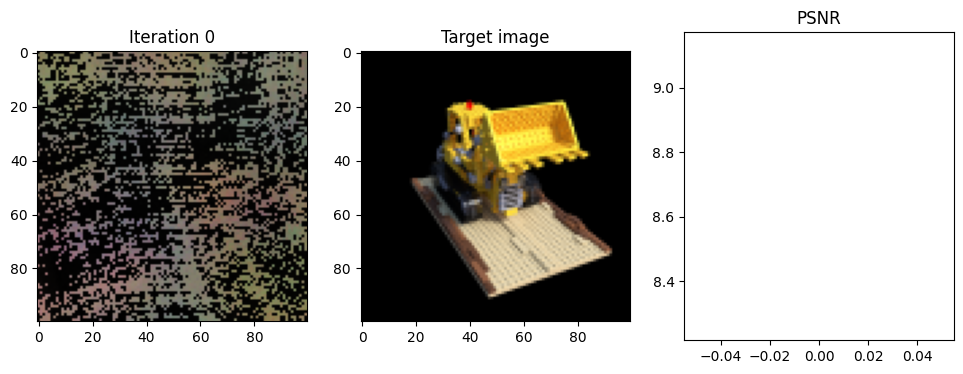

i 1
i 2
i 3
i 4
i 5
i 6
i 7
i 8
i 9
i 10
i 11
i 12
i 13
i 14
i 15
i 16
i 17
i 18
i 19
i 20
i 21
i 22
i 23
i 24
i 25
Iteration 25  Loss: 0.0751  PSNR: 10.72  Time: 2.01 secs per iter,  0.96 mins in total


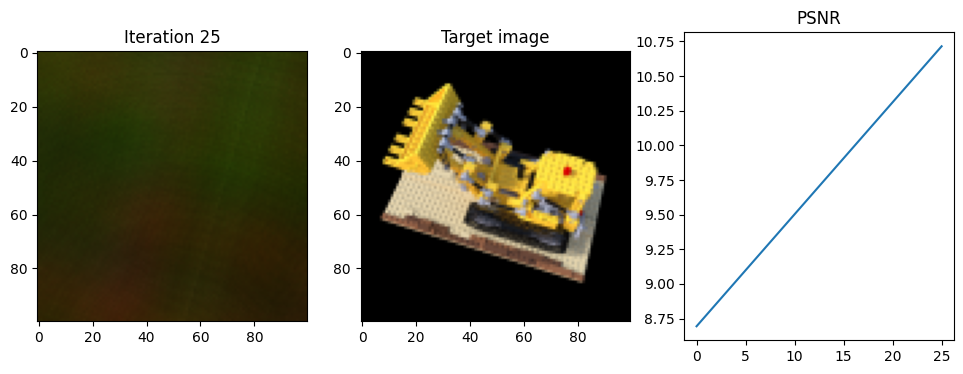

i 26
i 27
i 28
i 29
i 30
i 31
i 32
i 33
i 34
i 35
i 36
i 37
i 38
i 39
i 40
i 41
i 42
i 43
i 44
i 45
i 46
i 47
i 48
i 49
i 50
Iteration 50  Loss: 0.0606  PSNR: 11.67  Time: 2.12 secs per iter,  1.85 mins in total


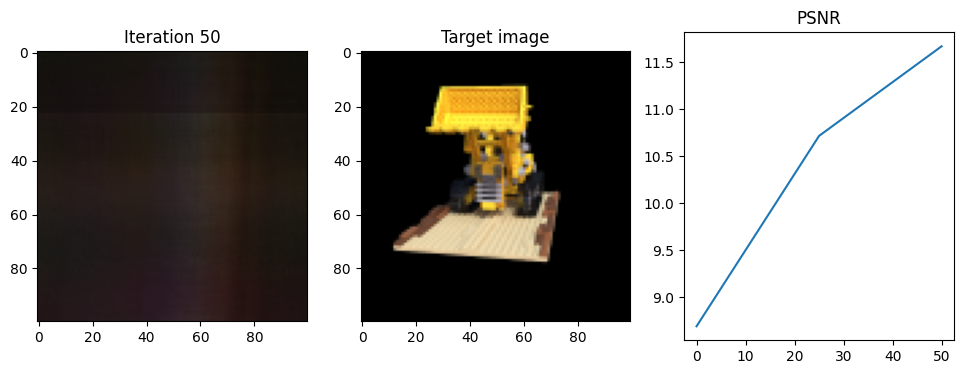

i 51
i 52
i 53
i 54
i 55
i 56
i 57
i 58
i 59
i 60
i 61
i 62
i 63
i 64
i 65
i 66
i 67
i 68
i 69
i 70
i 71
i 72
i 73
i 74
i 75
Iteration 75  Loss: 0.0533  PSNR: 12.88  Time: 2.08 secs per iter,  2.71 mins in total


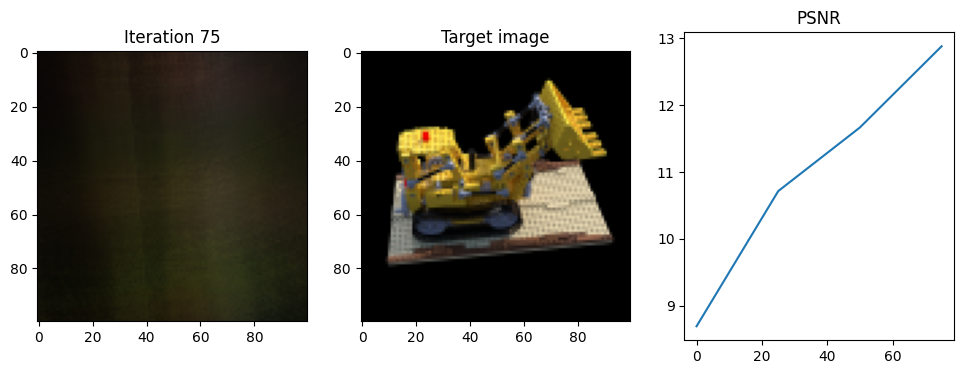

i 76
i 77
i 78
i 79
i 80
i 81
i 82
i 83
i 84
i 85
i 86
i 87
i 88
i 89
i 90
i 91
i 92
i 93
i 94
i 95
i 96
i 97
i 98
i 99
i 100
Iteration 100  Loss: 0.0204  PSNR: 15.77  Time: 2.10 secs per iter,  3.59 mins in total


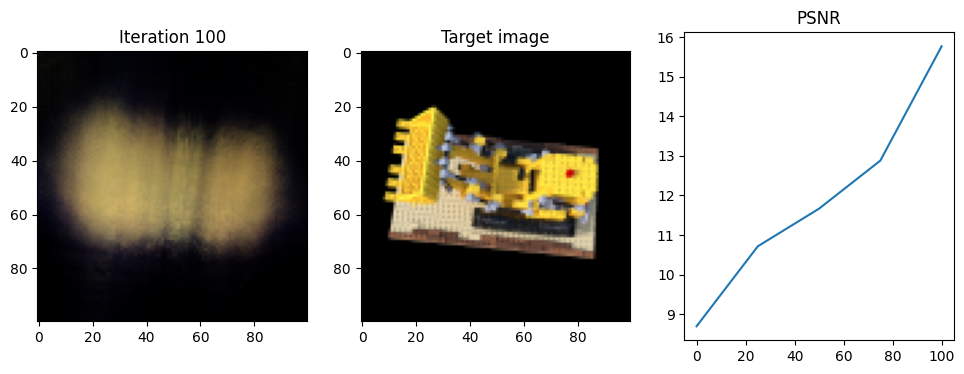

i 101
i 102
i 103
i 104
i 105
i 106
i 107
i 108
i 109
i 110
i 111
i 112
i 113
i 114
i 115
i 116
i 117
i 118
i 119
i 120
i 121
i 122
i 123
i 124
i 125
Iteration 125  Loss: 0.0223  PSNR: 15.86  Time: 2.07 secs per iter,  4.45 mins in total


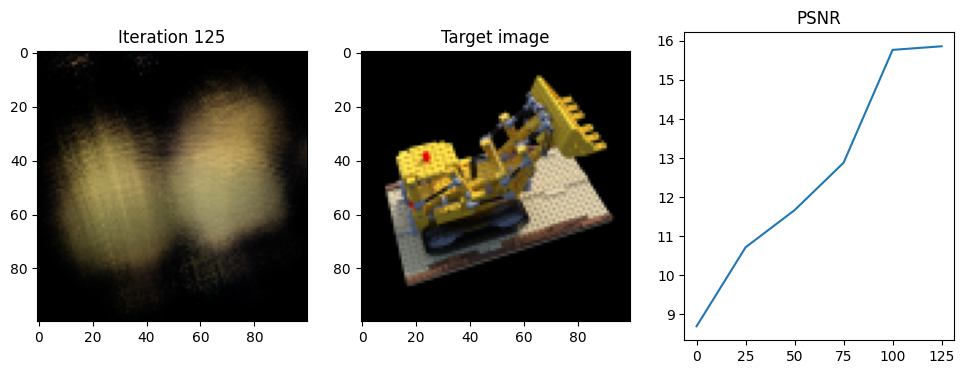

i 126
i 127
i 128
i 129
i 130
i 131
i 132
i 133
i 134
i 135
i 136
i 137
i 138
i 139
i 140
i 141
i 142
i 143
i 144
i 145
i 146
i 147
i 148
i 149
i 150
Iteration 150  Loss: 0.0237  PSNR: 16.19  Time: 2.08 secs per iter,  5.32 mins in total


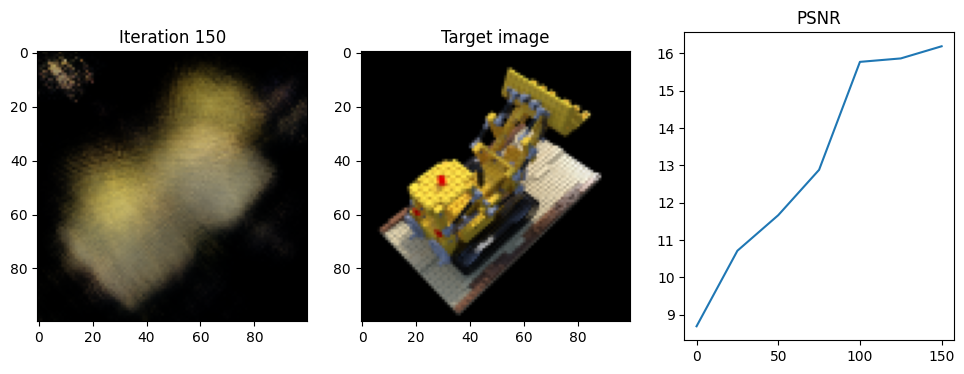

i 151
i 152
i 153
i 154
i 155
i 156
i 157
i 158
i 159
i 160
i 161
i 162
i 163
i 164
i 165
i 166
i 167
i 168
i 169
i 170
i 171
i 172
i 173
i 174
i 175
Iteration 175  Loss: 0.0194  PSNR: 17.99  Time: 2.06 secs per iter,  6.18 mins in total


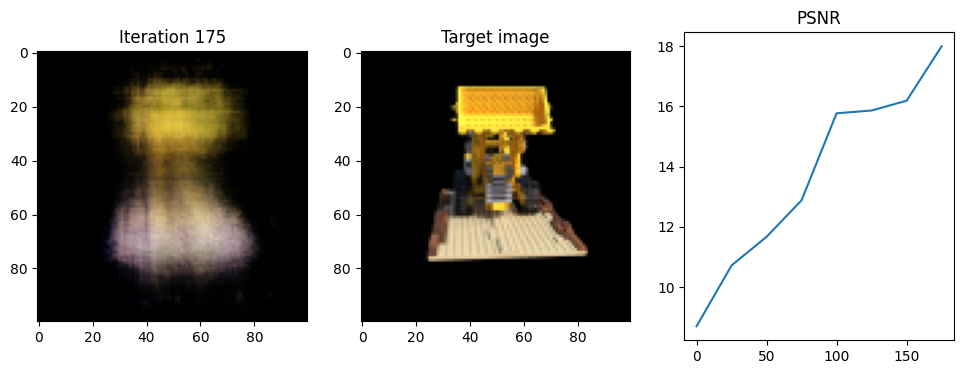

i 176
i 177
i 178
i 179
i 180
i 181
i 182
i 183
i 184
i 185
i 186
i 187
i 188
i 189
i 190
i 191
i 192
i 193
i 194
i 195
i 196
i 197
i 198
i 199
i 200
Iteration 200  Loss: 0.0246  PSNR: 16.60  Time: 2.07 secs per iter,  7.04 mins in total


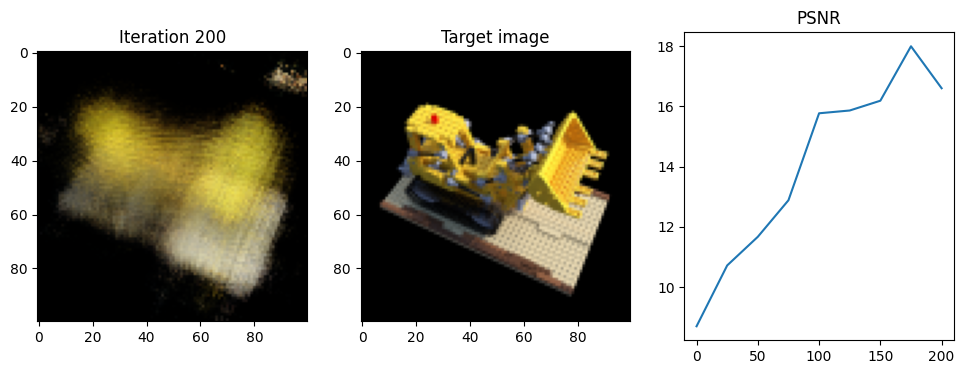

i 201
i 202
i 203
i 204
i 205
i 206
i 207
i 208
i 209
i 210
i 211
i 212
i 213
i 214
i 215
i 216
i 217
i 218
i 219
i 220
i 221
i 222
i 223
i 224
i 225
Iteration 225  Loss: 0.0081  PSNR: 18.74  Time: 2.04 secs per iter,  7.89 mins in total


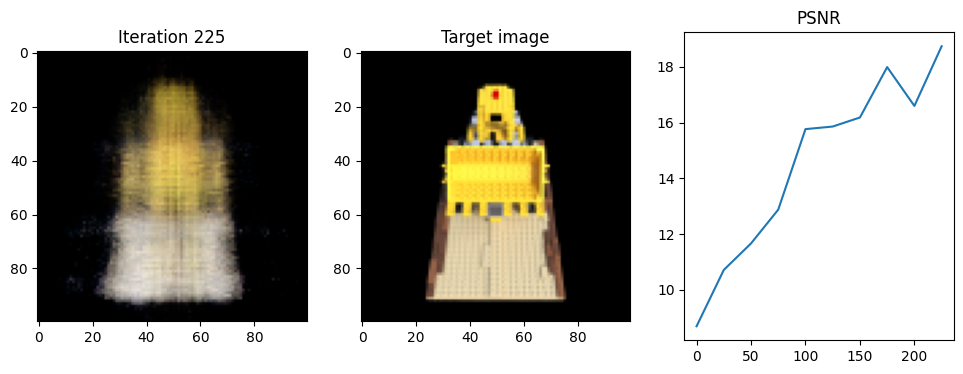

i 226
i 227
i 228
i 229
i 230
i 231
i 232
i 233
i 234
i 235
i 236
i 237
i 238
i 239
i 240
i 241
i 242
i 243
i 244
i 245
i 246
i 247
i 248
i 249
i 250
Iteration 250  Loss: 0.0163  PSNR: 17.25  Time: 2.03 secs per iter,  8.74 mins in total


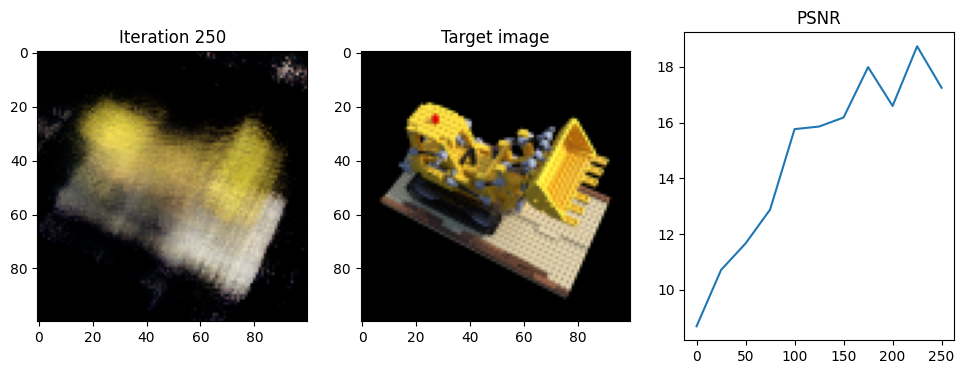

i 251
i 252
i 253
i 254
i 255
i 256
i 257
i 258
i 259
i 260
i 261
i 262
i 263
i 264
i 265
i 266
i 267
i 268
i 269
i 270
i 271
i 272
i 273
i 274
i 275
Iteration 275  Loss: 0.0131  PSNR: 19.96  Time: 2.02 secs per iter,  9.58 mins in total


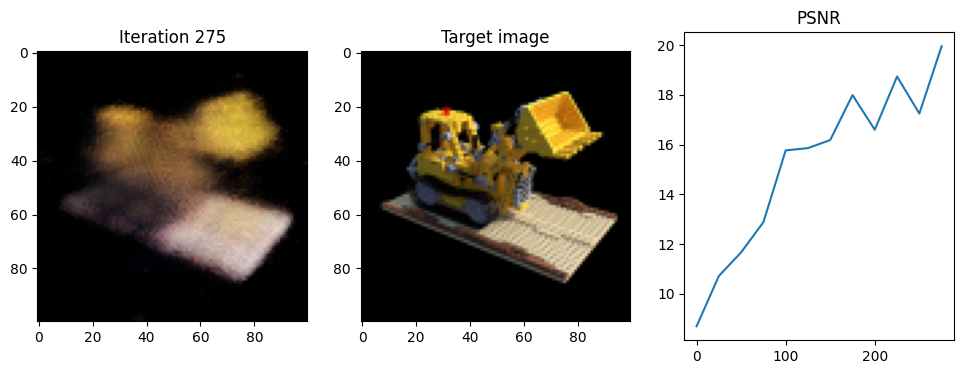

i 276
i 277
i 278
i 279
i 280
i 281
i 282
i 283
i 284
i 285
i 286
i 287
i 288
i 289
i 290
i 291
i 292
i 293
i 294
i 295
i 296
i 297
i 298
i 299
i 300
Iteration 300  Loss: 0.0162  PSNR: 17.51  Time: 2.02 secs per iter,  10.42 mins in total


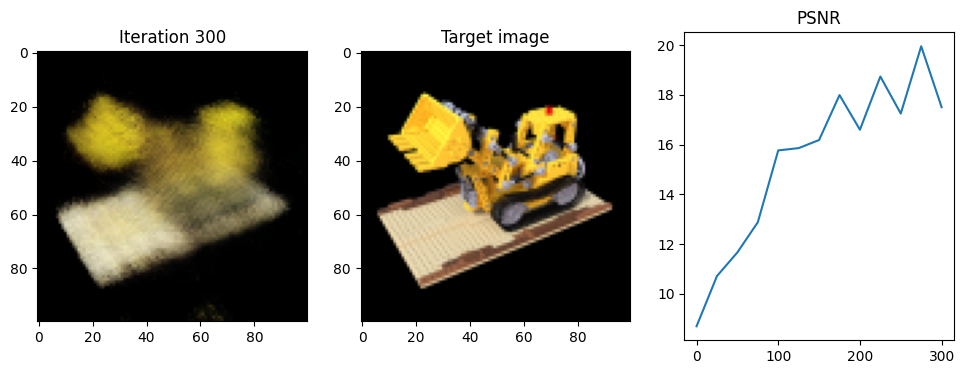

i 301
i 302
i 303
i 304
i 305
i 306
i 307
i 308
i 309
i 310
i 311
i 312
i 313
i 314
i 315
i 316
i 317
i 318
i 319
i 320
i 321
i 322
i 323
i 324
i 325
Iteration 325  Loss: 0.0094  PSNR: 20.36  Time: 2.02 secs per iter,  11.26 mins in total


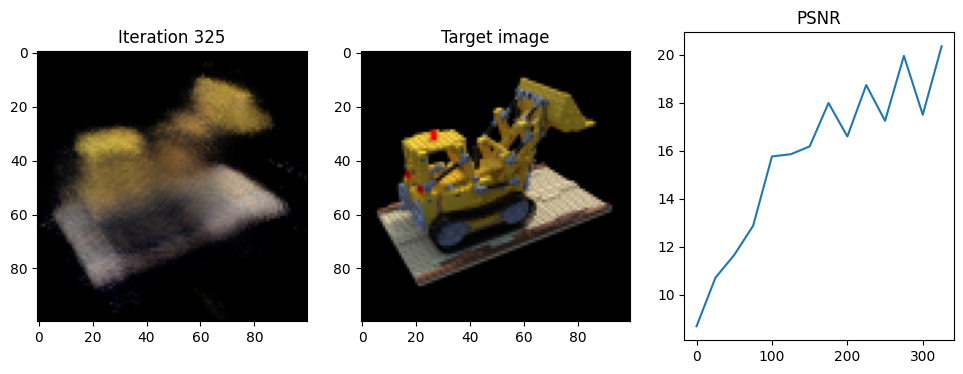

i 326
i 327
i 328
i 329
i 330
i 331
i 332
i 333
i 334
i 335
i 336
i 337
i 338
i 339
i 340
i 341
i 342
i 343
i 344
i 345
i 346
i 347
i 348
i 349
i 350
Iteration 350  Loss: 0.0083  PSNR: 21.15  Time: 2.04 secs per iter,  12.11 mins in total


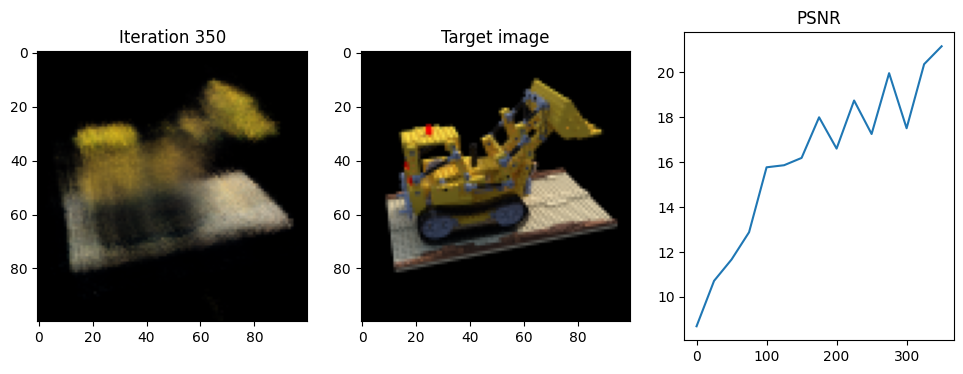

i 351
i 352
i 353
i 354
i 355
i 356
i 357
i 358
i 359
i 360
i 361
i 362
i 363
i 364
i 365
i 366
i 367
i 368
i 369
i 370
i 371
i 372
i 373
i 374
i 375
Iteration 375  Loss: 0.0125  PSNR: 21.58  Time: 2.01 secs per iter,  12.95 mins in total


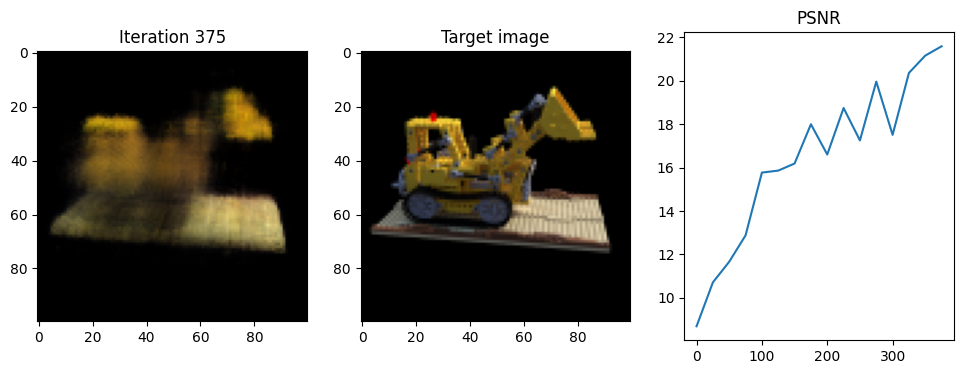

i 376
i 377
i 378
i 379
i 380
i 381
i 382
i 383
i 384
i 385
i 386
i 387
i 388
i 389
i 390
i 391
i 392
i 393
i 394
i 395
i 396
i 397
i 398
i 399
i 400
Iteration 400  Loss: 0.0115  PSNR: 20.45  Time: 2.00 secs per iter,  13.78 mins in total


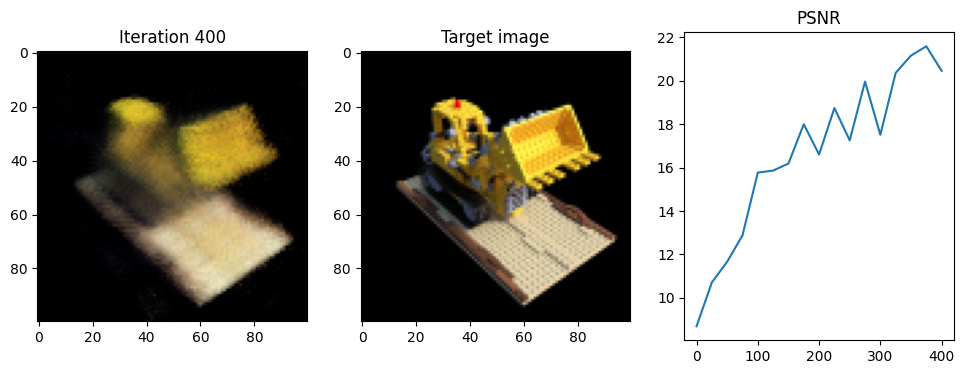

i 401
i 402
i 403
i 404
i 405
i 406
i 407
i 408
i 409
i 410
i 411
i 412
i 413
i 414
i 415
i 416
i 417
i 418
i 419
i 420
i 421
i 422
i 423
i 424
i 425
Iteration 425  Loss: 0.0070  PSNR: 18.93  Time: 2.00 secs per iter,  14.62 mins in total


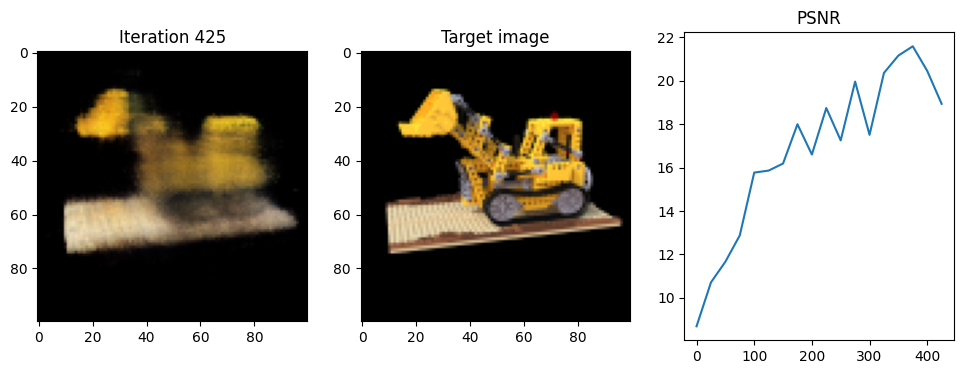

i 426
i 427
i 428
i 429
i 430
i 431
i 432
i 433
i 434
i 435
i 436
i 437
i 438
i 439
i 440
i 441
i 442
i 443
i 444
i 445
i 446
i 447
i 448
i 449
i 450
Iteration 450  Loss: 0.0042  PSNR: 20.94  Time: 1.99 secs per iter,  15.45 mins in total


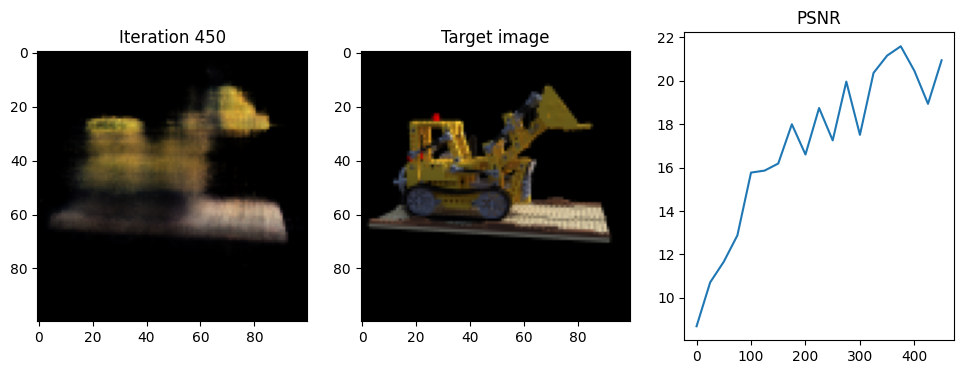

i 451
i 452
i 453
i 454
i 455
i 456
i 457
i 458
i 459
i 460
i 461
i 462
i 463
i 464
i 465
i 466
i 467
i 468
i 469
i 470
i 471
i 472
i 473
i 474
i 475
Iteration 475  Loss: 0.0120  PSNR: 20.35  Time: 1.97 secs per iter,  16.27 mins in total


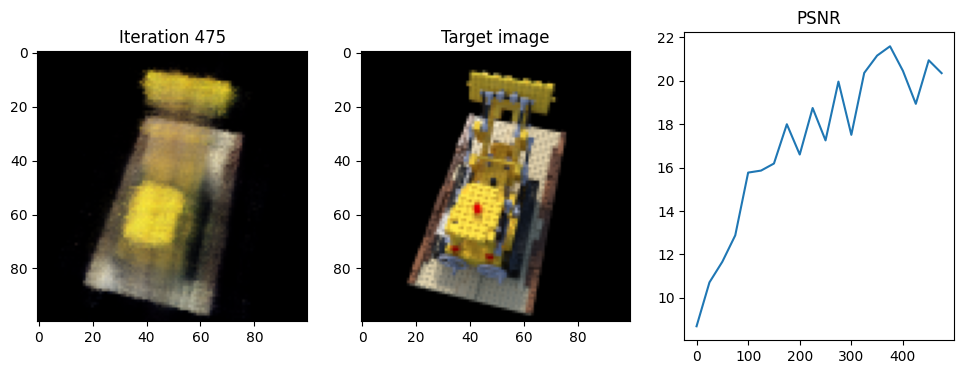

i 476
i 477
i 478
i 479
i 480
i 481
i 482
i 483
i 484
i 485
i 486
i 487
i 488
i 489
i 490
i 491
i 492
i 493
i 494
i 495
i 496
i 497
i 498
i 499
i 500
Iteration 500  Loss: 0.0086  PSNR: 21.70  Time: 1.99 secs per iter,  17.09 mins in total


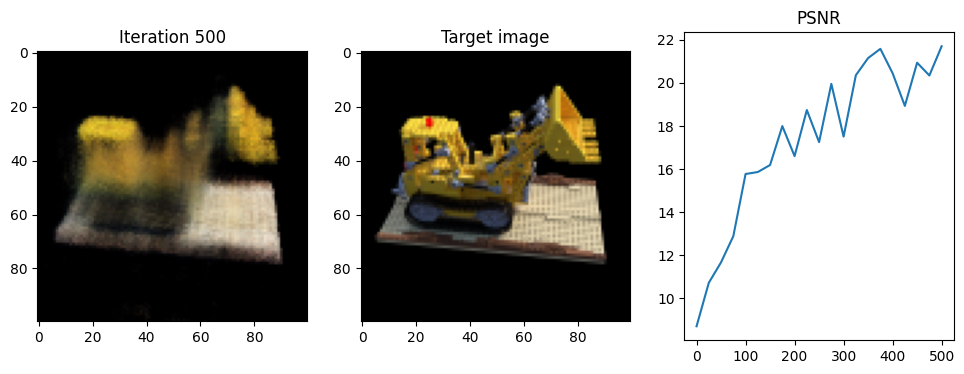

i 501
i 502
i 503
i 504
i 505
i 506
i 507
i 508
i 509
i 510
i 511
i 512
i 513
i 514
i 515
i 516
i 517
i 518
i 519
i 520
i 521
i 522
i 523
i 524
i 525
Iteration 525  Loss: 0.0056  PSNR: 20.66  Time: 1.99 secs per iter,  17.93 mins in total


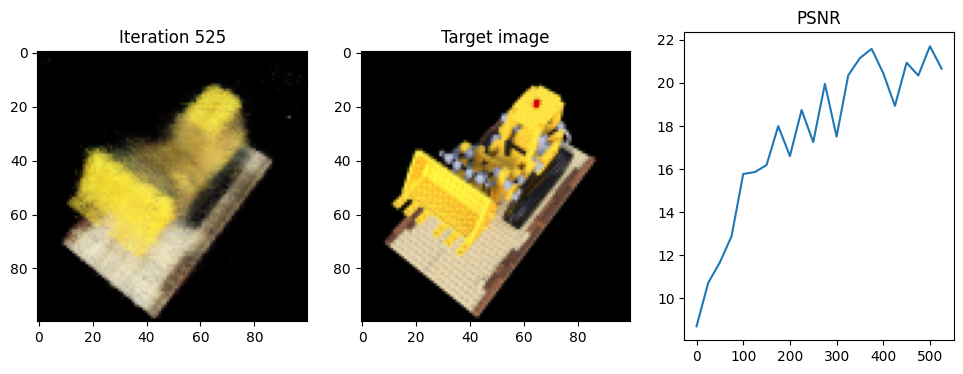

i 526
i 527
i 528
i 529
i 530
i 531
i 532
i 533
i 534
i 535
i 536
i 537
i 538
i 539
i 540
i 541
i 542
i 543
i 544
i 545
i 546
i 547
i 548
i 549
i 550
Iteration 550  Loss: 0.0049  PSNR: 20.75  Time: 1.98 secs per iter,  18.75 mins in total


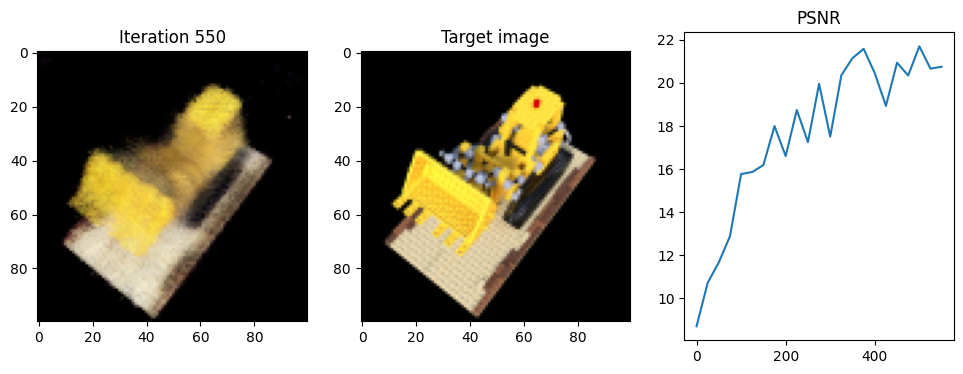

i 551
i 552
i 553
i 554
i 555
i 556
i 557
i 558
i 559
i 560
i 561
i 562
i 563
i 564
i 565
i 566
i 567
i 568
i 569
i 570
i 571
i 572
i 573
i 574
i 575
Iteration 575  Loss: 0.0059  PSNR: 19.81  Time: 1.98 secs per iter,  19.58 mins in total


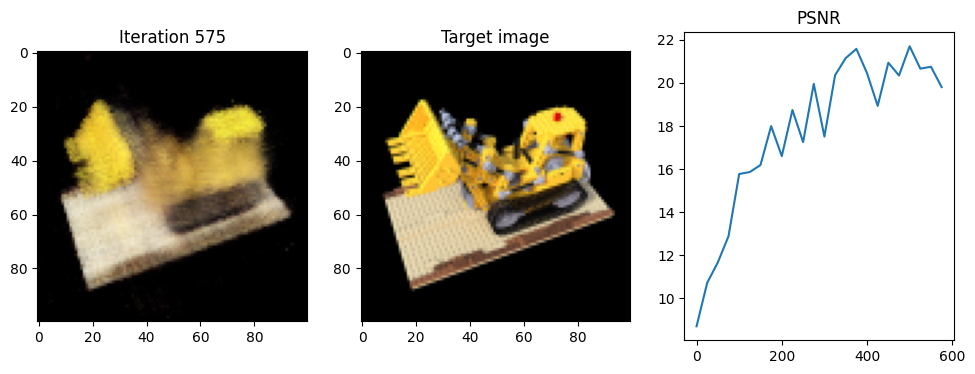

i 576
i 577
i 578
i 579
i 580
i 581
i 582
i 583
i 584
i 585
i 586
i 587
i 588
i 589
i 590
i 591
i 592
i 593
i 594
i 595
i 596
i 597
i 598
i 599
i 600
Iteration 600  Loss: 0.0084  PSNR: 21.54  Time: 1.98 secs per iter,  20.40 mins in total


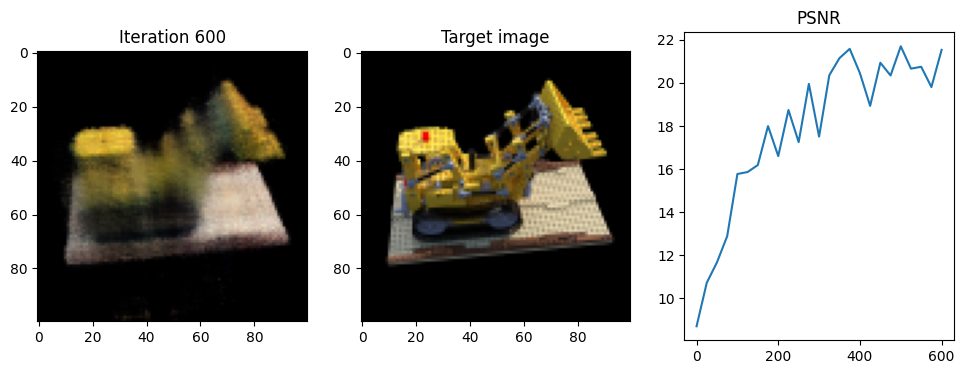

i 601
i 602
i 603
i 604
i 605
i 606
i 607
i 608
i 609
i 610
i 611
i 612
i 613
i 614
i 615
i 616
i 617
i 618
i 619
i 620
i 621
i 622
i 623
i 624
i 625
Iteration 625  Loss: 0.0091  PSNR: 20.86  Time: 1.98 secs per iter,  21.22 mins in total


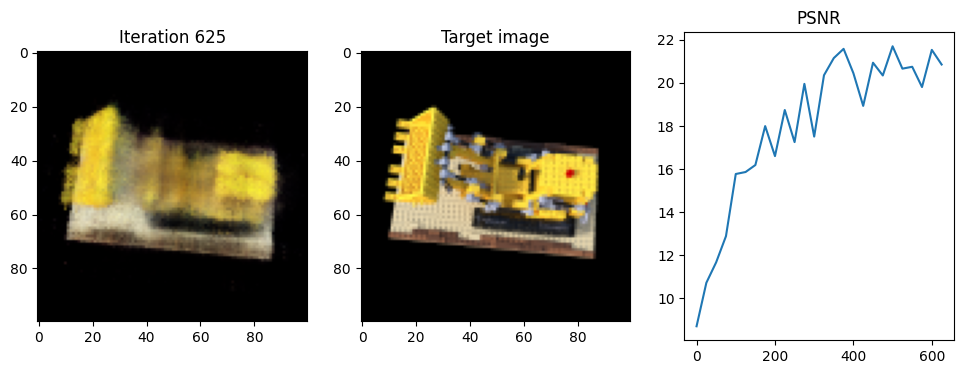

i 626
i 627
i 628
i 629
i 630
i 631
i 632
i 633
i 634
i 635
i 636
i 637
i 638
i 639
i 640
i 641
i 642
i 643
i 644
i 645
i 646
i 647
i 648
i 649
i 650
Iteration 650  Loss: 0.0048  PSNR: 22.37  Time: 1.99 secs per iter,  22.05 mins in total


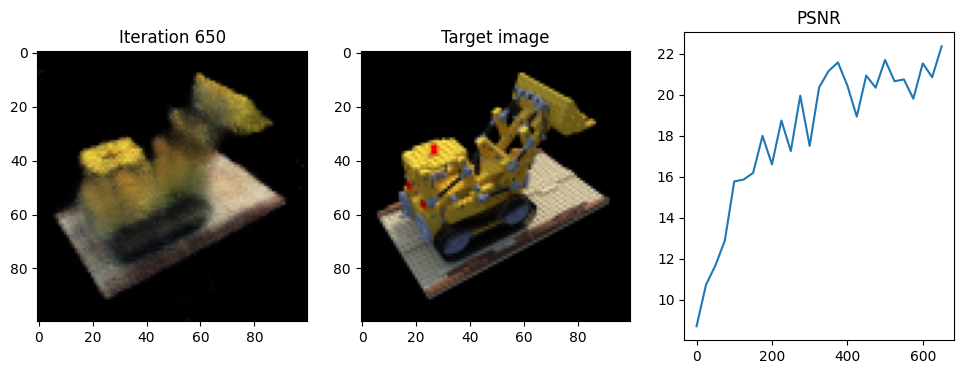

i 651
i 652
i 653
i 654
i 655
i 656
i 657
i 658
i 659
i 660
i 661
i 662
i 663
i 664
i 665
i 666
i 667
i 668
i 669
i 670
i 671
i 672
i 673
i 674
i 675
Iteration 675  Loss: 0.0052  PSNR: 21.72  Time: 2.00 secs per iter,  22.88 mins in total


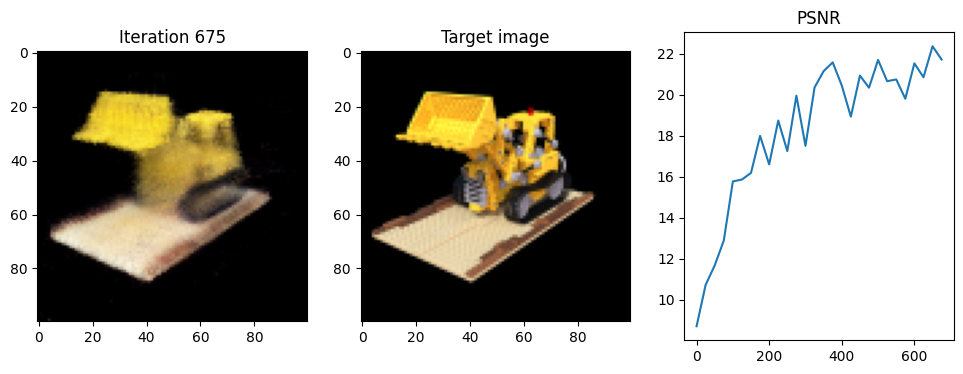

i 676
i 677
i 678
i 679
i 680
i 681
i 682
i 683
i 684
i 685
i 686
i 687
i 688
i 689
i 690
i 691
i 692
i 693
i 694
i 695
i 696
i 697
i 698
i 699
i 700
Iteration 700  Loss: 0.0076  PSNR: 20.90  Time: 2.01 secs per iter,  23.72 mins in total


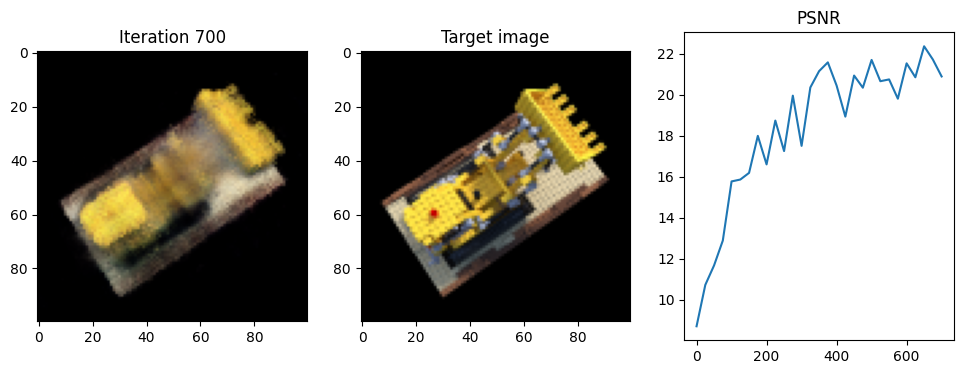

i 701
i 702
i 703
i 704
i 705
i 706
i 707
i 708
i 709
i 710
i 711
i 712
i 713
i 714
i 715
i 716
i 717
i 718
i 719
i 720
i 721
i 722
i 723
i 724
i 725
Iteration 725  Loss: 0.0060  PSNR: 20.32  Time: 1.98 secs per iter,  24.55 mins in total


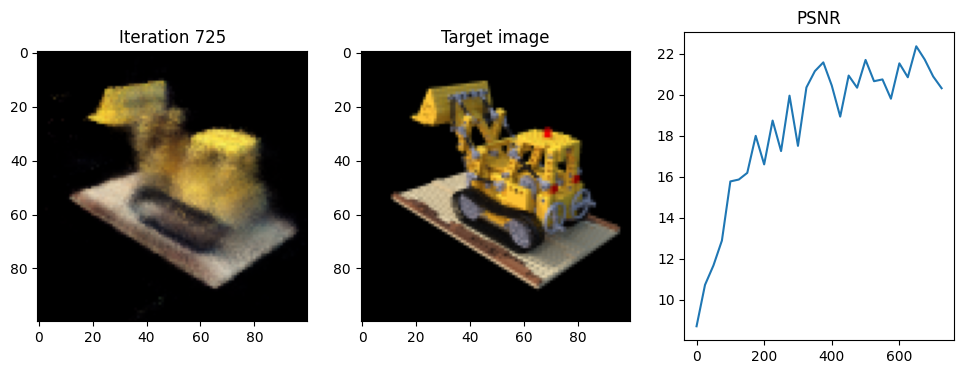

i 726
i 727
i 728
i 729
i 730
i 731
i 732
i 733
i 734
i 735
i 736
i 737
i 738
i 739
i 740
i 741
i 742
i 743
i 744
i 745
i 746
i 747
i 748
i 749
i 750
Iteration 750  Loss: 0.0085  PSNR: 21.67  Time: 1.98 secs per iter,  25.37 mins in total


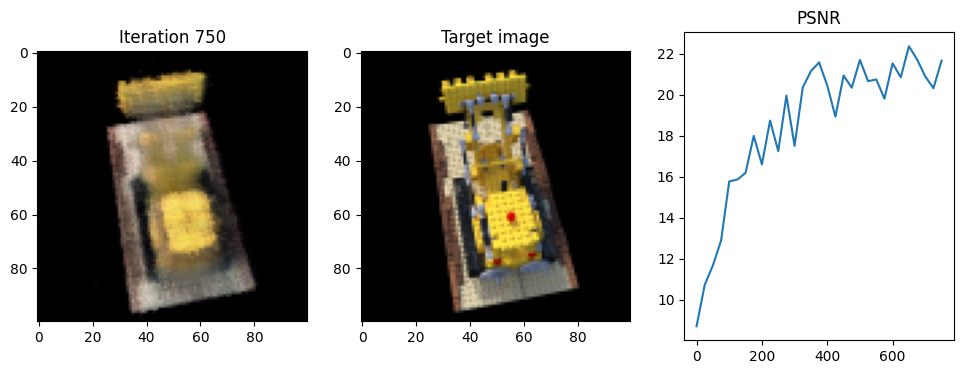

i 751
i 752
i 753
i 754
i 755
i 756
i 757
i 758
i 759
i 760
i 761
i 762
i 763
i 764
i 765
i 766
i 767
i 768
i 769
i 770
i 771
i 772
i 773
i 774
i 775
Iteration 775  Loss: 0.0060  PSNR: 23.21  Time: 1.99 secs per iter,  26.20 mins in total


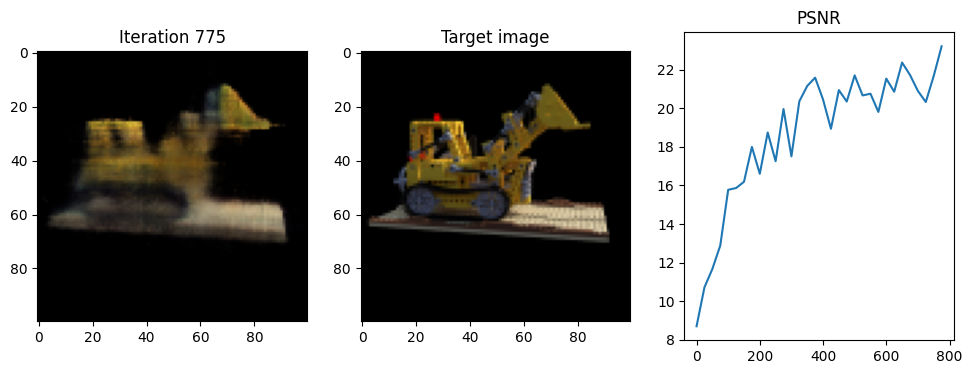

i 776
i 777
i 778
i 779
i 780
i 781
i 782
i 783
i 784
i 785
i 786
i 787
i 788
i 789
i 790
i 791
i 792
i 793
i 794
i 795
i 796
i 797
i 798
i 799
i 800
Iteration 800  Loss: 0.0061  PSNR: 20.24  Time: 1.99 secs per iter,  27.03 mins in total


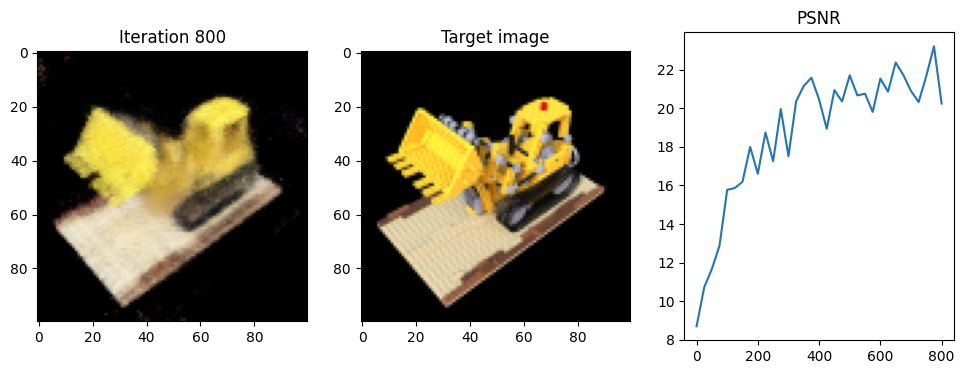

i 801
i 802
i 803
i 804
i 805
i 806
i 807
i 808
i 809
i 810
i 811
i 812
i 813
i 814
i 815
i 816
i 817
i 818
i 819
i 820
i 821
i 822
i 823
i 824
i 825
Iteration 825  Loss: 0.0049  PSNR: 22.62  Time: 1.97 secs per iter,  27.85 mins in total


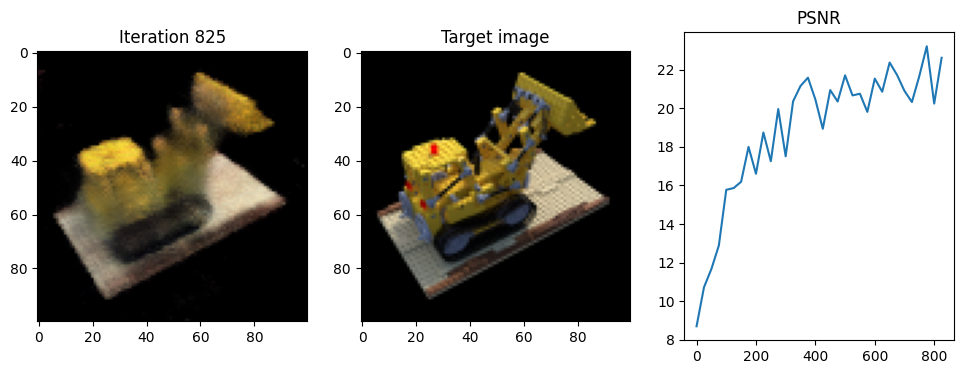

i 826
i 827
i 828
i 829
i 830
i 831
i 832
i 833
i 834
i 835
i 836
i 837
i 838
i 839
i 840
i 841
i 842
i 843
i 844
i 845
i 846
i 847
i 848
i 849
i 850
Iteration 850  Loss: 0.0051  PSNR: 21.18  Time: 1.97 secs per iter,  28.67 mins in total


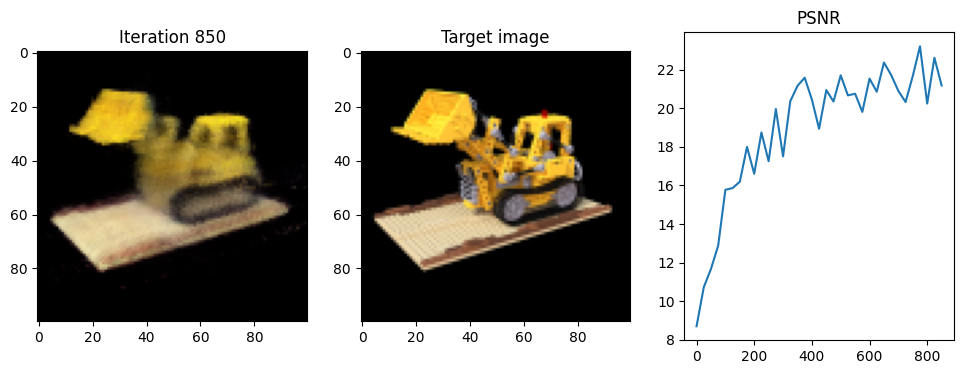

i 851
i 852
i 853
i 854
i 855
i 856
i 857
i 858
i 859
i 860
i 861
i 862
i 863
i 864
i 865
i 866
i 867
i 868
i 869
i 870
i 871
i 872
i 873
i 874
i 875
Iteration 875  Loss: 0.0061  PSNR: 20.98  Time: 1.99 secs per iter,  29.50 mins in total


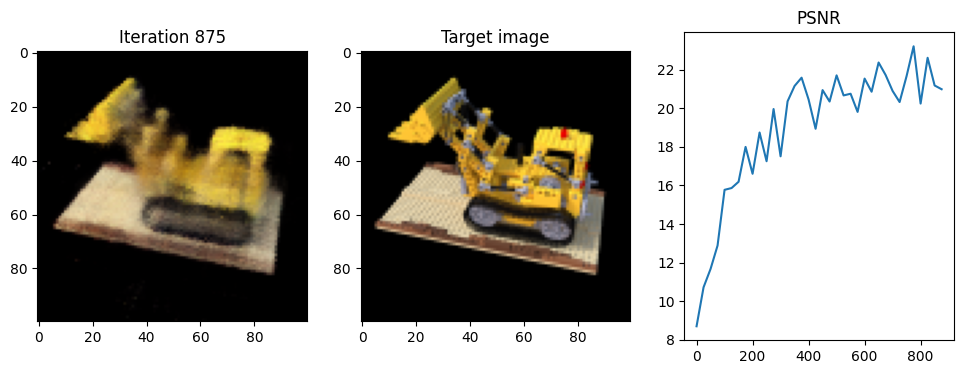

i 876
i 877
i 878
i 879
i 880
i 881
i 882
i 883
i 884
i 885
i 886
i 887
i 888
i 889
i 890
i 891
i 892
i 893
i 894
i 895
i 896
i 897
i 898
i 899
i 900
Iteration 900  Loss: 0.0026  PSNR: 22.88  Time: 1.98 secs per iter,  30.33 mins in total


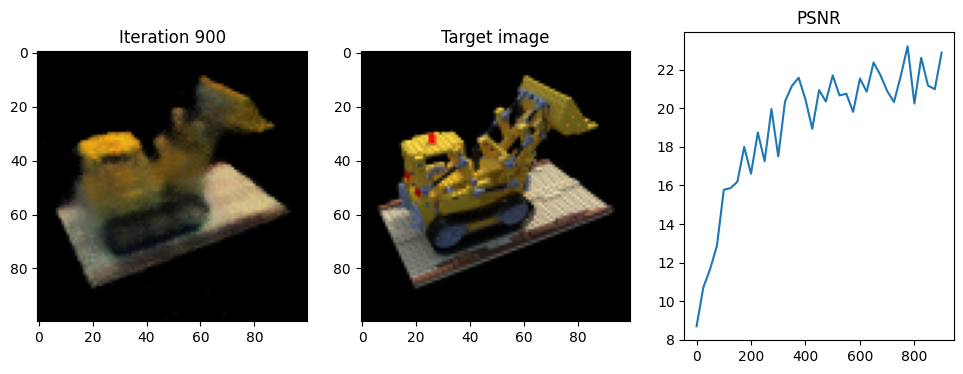

i 901
i 902
i 903
i 904
i 905
i 906
i 907
i 908
i 909
i 910
i 911
i 912
i 913
i 914
i 915
i 916
i 917
i 918
i 919
i 920
i 921
i 922
i 923
i 924
i 925
Iteration 925  Loss: 0.0044  PSNR: 23.65  Time: 1.97 secs per iter,  31.15 mins in total


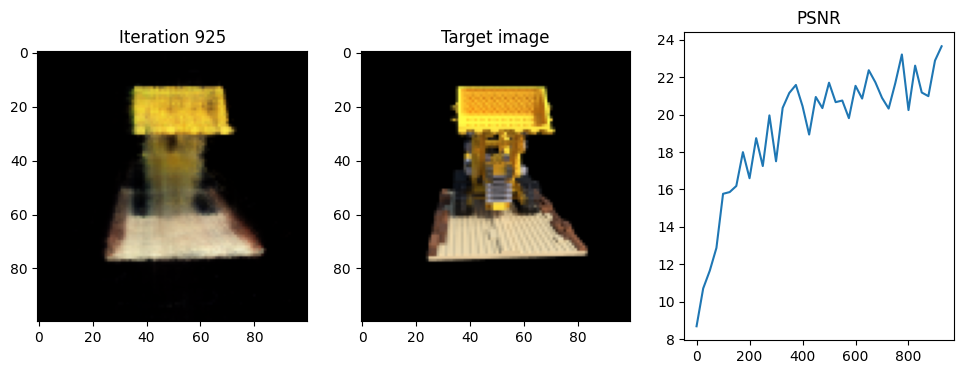

i 926
i 927
i 928
i 929
i 930
i 931
i 932
i 933
i 934
i 935
i 936
i 937
i 938
i 939
i 940
i 941
i 942
i 943
i 944
i 945
i 946
i 947
i 948
i 949
i 950
Iteration 950  Loss: 0.0032  PSNR: 22.42  Time: 2.00 secs per iter,  31.98 mins in total


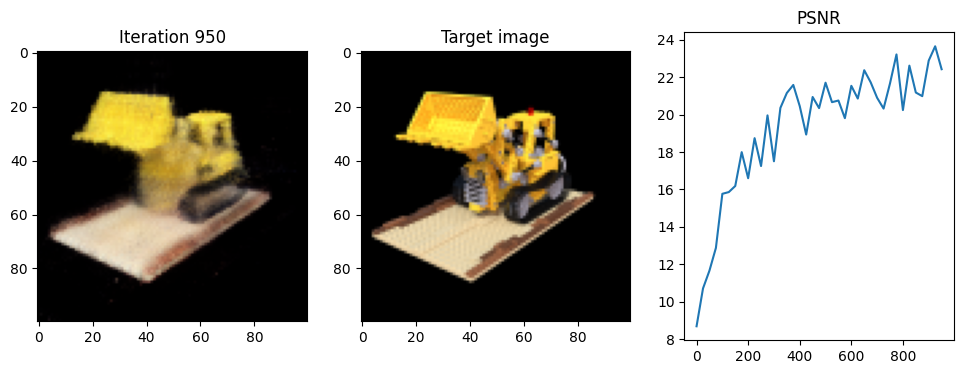

i 951
i 952
i 953
i 954
i 955
i 956
i 957
i 958
i 959
i 960
i 961
i 962
i 963
i 964
i 965
i 966
i 967
i 968
i 969
i 970
i 971
i 972
i 973
i 974
i 975
Iteration 975  Loss: 0.0049  PSNR: 24.63  Time: 1.98 secs per iter,  32.81 mins in total


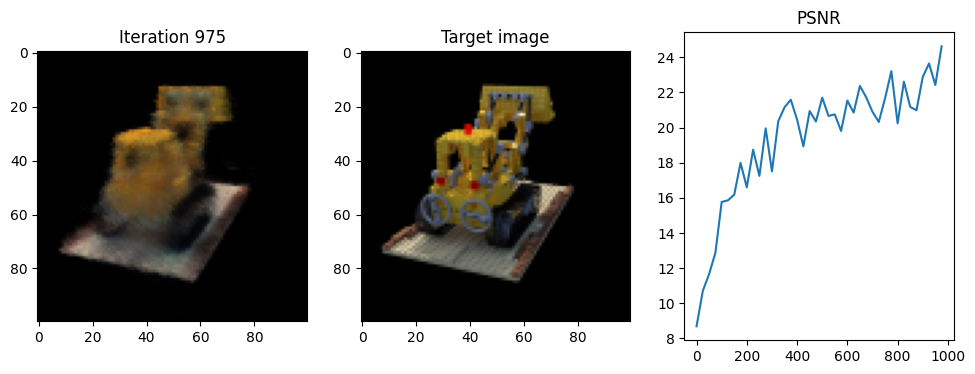

i 976
i 977
i 978
i 979
i 980
i 981
i 982
i 983
i 984
i 985
i 986
i 987
i 988
i 989
i 990
i 991
i 992
i 993
i 994
i 995
i 996
i 997
i 998
i 999
i 1000
Iteration 1000  Loss: 0.0023  PSNR: 22.57  Time: 1.98 secs per iter,  33.63 mins in total


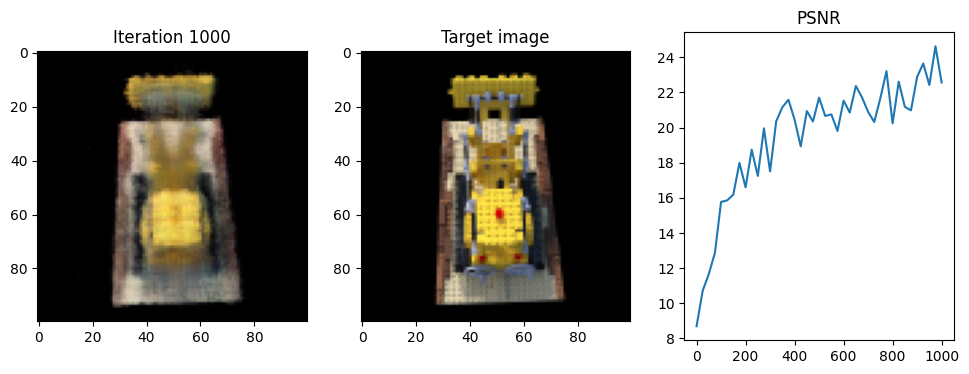

i 1001
i 1002
i 1003
i 1004
i 1005
i 1006
i 1007
i 1008
i 1009
i 1010
i 1011
i 1012
i 1013
i 1014
i 1015
i 1016
i 1017
i 1018
i 1019
i 1020
i 1021
i 1022
i 1023
i 1024
i 1025
Iteration 1025  Loss: 0.0046  PSNR: 23.40  Time: 2.00 secs per iter,  34.46 mins in total


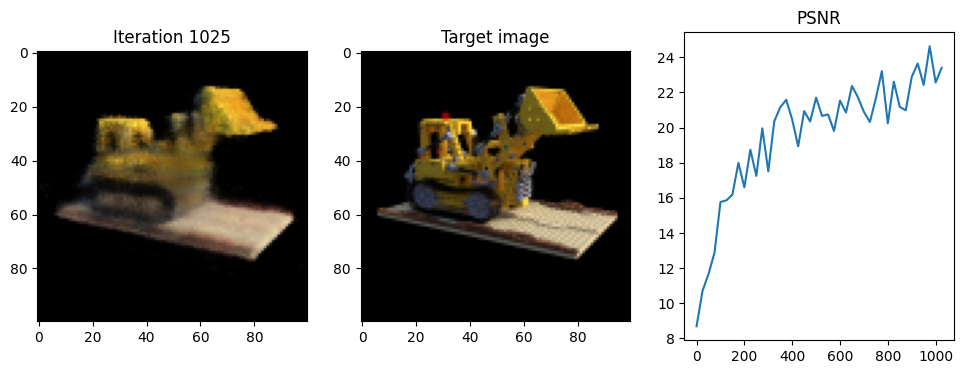

i 1026
i 1027
i 1028
i 1029
i 1030
i 1031
i 1032
i 1033
i 1034
i 1035
i 1036
i 1037
i 1038
i 1039
i 1040
i 1041
i 1042
i 1043
i 1044
i 1045
i 1046
i 1047
i 1048
i 1049
i 1050
Iteration 1050  Loss: 0.0037  PSNR: 26.00  Time: 1.98 secs per iter,  35.29 mins in total


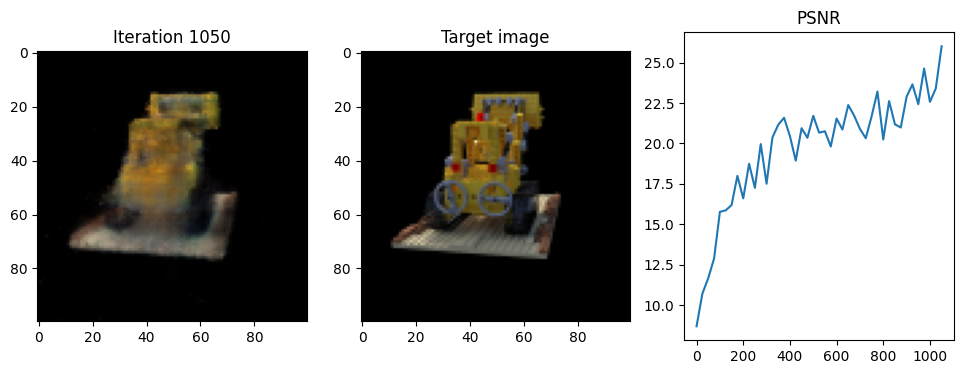

i 1051
i 1052
i 1053
i 1054
i 1055
i 1056
i 1057
i 1058
i 1059
i 1060
i 1061
i 1062
i 1063
i 1064
i 1065
i 1066
i 1067
i 1068
i 1069
i 1070
i 1071
i 1072
i 1073
i 1074
i 1075
Iteration 1075  Loss: 0.0023  PSNR: 21.61  Time: 1.98 secs per iter,  36.12 mins in total


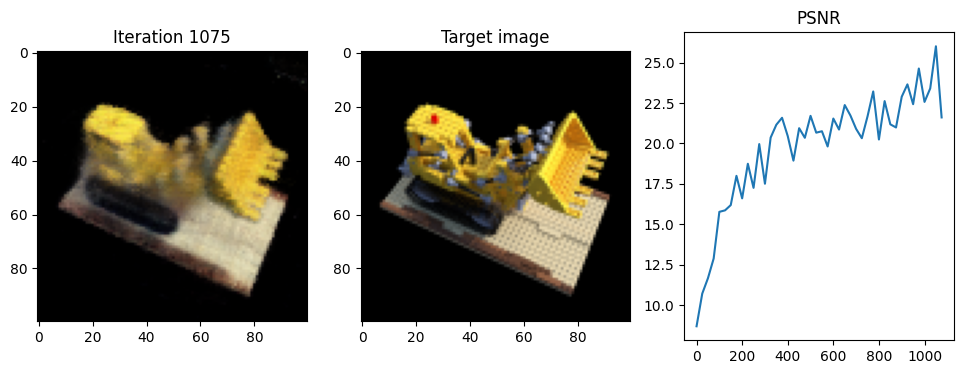

i 1076
i 1077
i 1078
i 1079
i 1080
i 1081
i 1082
i 1083
i 1084
i 1085
i 1086
i 1087
i 1088
i 1089
i 1090
i 1091
i 1092
i 1093
i 1094
i 1095
i 1096
i 1097
i 1098
i 1099
i 1100
Iteration 1100  Loss: 0.0046  PSNR: 22.91  Time: 2.00 secs per iter,  36.95 mins in total


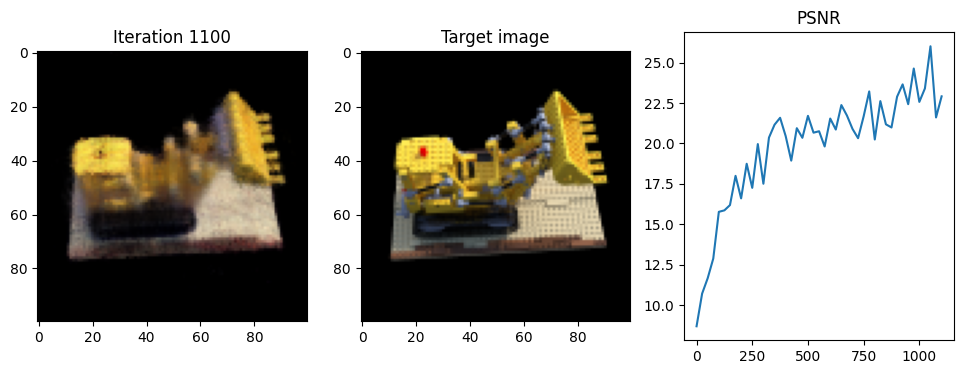

i 1101
i 1102
i 1103
i 1104
i 1105
i 1106
i 1107
i 1108
i 1109
i 1110
i 1111
i 1112
i 1113
i 1114
i 1115
i 1116
i 1117
i 1118
i 1119
i 1120
i 1121
i 1122
i 1123
i 1124
i 1125
Iteration 1125  Loss: 0.0059  PSNR: 25.06  Time: 1.98 secs per iter,  37.78 mins in total


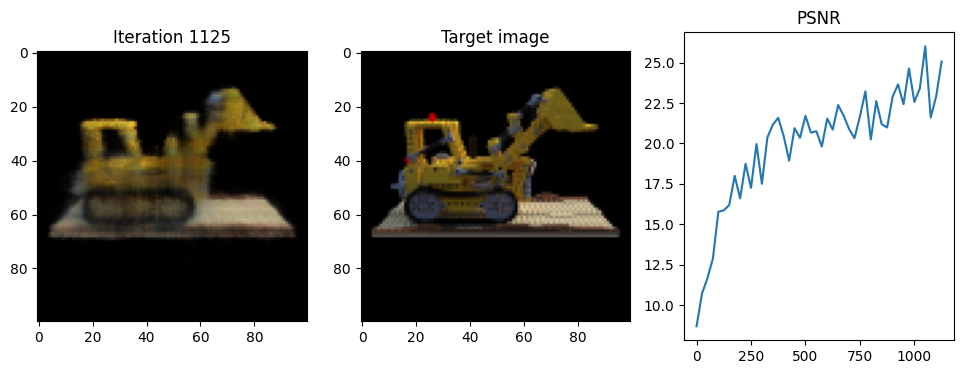

i 1126
i 1127
i 1128
i 1129
i 1130
i 1131
i 1132
i 1133
i 1134
i 1135
i 1136
i 1137
i 1138
i 1139
i 1140
i 1141
i 1142
i 1143
i 1144
i 1145
i 1146
i 1147
i 1148
i 1149
i 1150
Iteration 1150  Loss: 0.0037  PSNR: 22.89  Time: 1.97 secs per iter,  38.60 mins in total


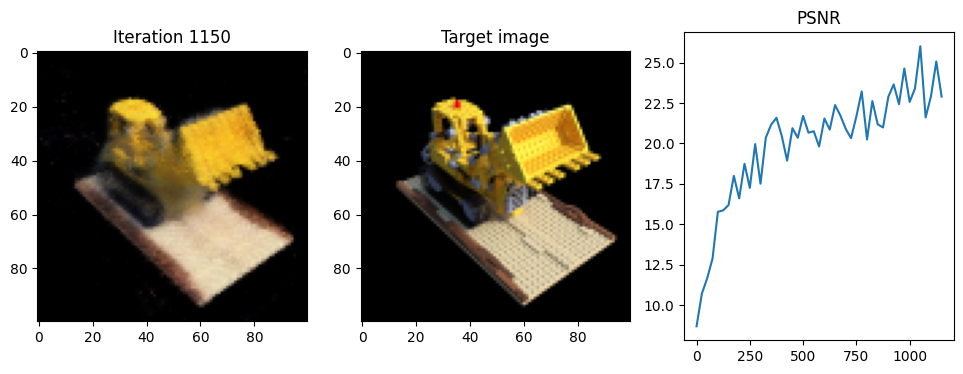

i 1151
i 1152
i 1153
i 1154
i 1155
i 1156
i 1157
i 1158
i 1159
i 1160
i 1161
i 1162
i 1163
i 1164
i 1165
i 1166
i 1167
i 1168
i 1169
i 1170
i 1171
i 1172
i 1173
i 1174
i 1175
Iteration 1175  Loss: 0.0028  PSNR: 22.11  Time: 2.00 secs per iter,  39.43 mins in total


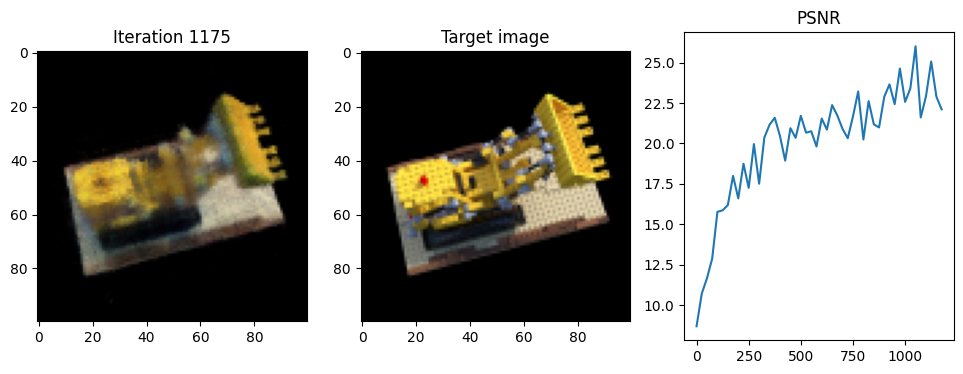

i 1176
i 1177
i 1178
i 1179
i 1180
i 1181
i 1182
i 1183
i 1184
i 1185
i 1186
i 1187
i 1188
i 1189
i 1190
i 1191
i 1192
i 1193
i 1194
i 1195
i 1196
i 1197
i 1198
i 1199
i 1200
Iteration 1200  Loss: 0.0050  PSNR: 21.72  Time: 1.99 secs per iter,  40.26 mins in total


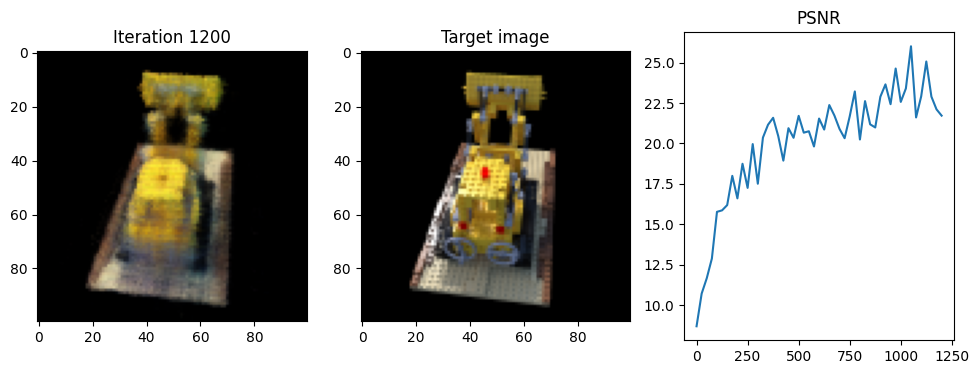

i 1201
i 1202
i 1203
i 1204
i 1205
i 1206
i 1207
i 1208
i 1209
i 1210
i 1211
i 1212
i 1213
i 1214
i 1215
i 1216
i 1217
i 1218
i 1219
i 1220
i 1221
i 1222
i 1223
i 1224
i 1225
Iteration 1225  Loss: 0.0023  PSNR: 22.73  Time: 1.97 secs per iter,  41.08 mins in total


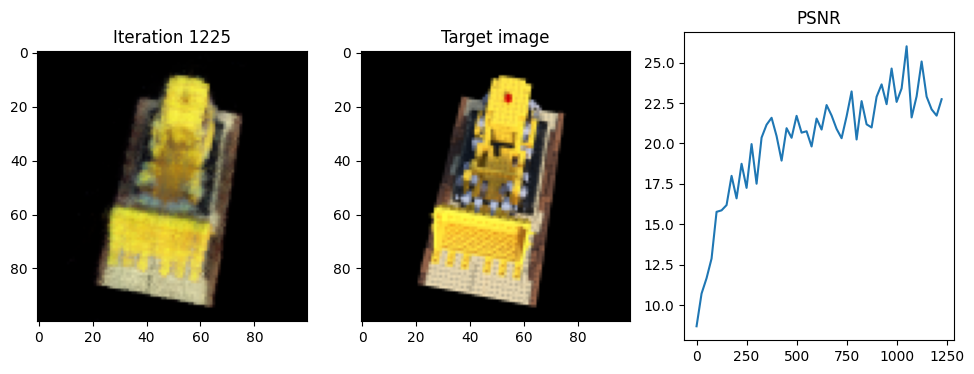

i 1226
i 1227
i 1228
i 1229
i 1230
i 1231
i 1232
i 1233
i 1234
i 1235
i 1236
i 1237
i 1238
i 1239
i 1240
i 1241
i 1242
i 1243
i 1244
i 1245
i 1246
i 1247
i 1248
i 1249
i 1250
Iteration 1250  Loss: 0.0060  PSNR: 22.98  Time: 2.00 secs per iter,  41.91 mins in total


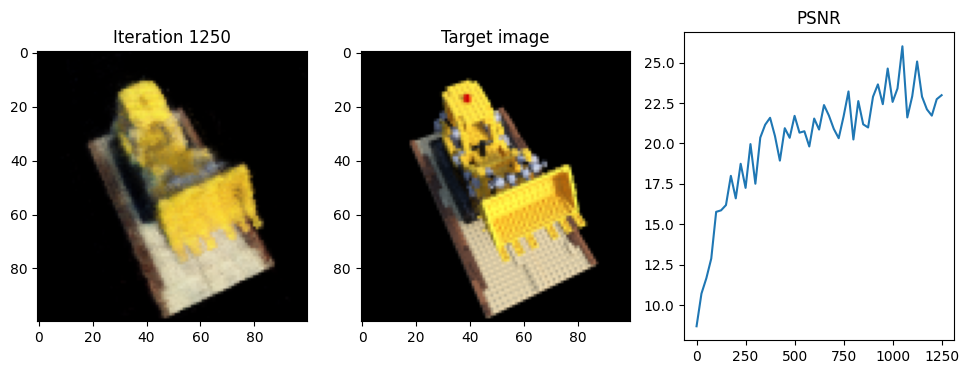

i 1251
i 1252
i 1253
i 1254
i 1255
i 1256
i 1257
i 1258
i 1259
i 1260
i 1261
i 1262
i 1263
i 1264
i 1265
i 1266
i 1267
i 1268
i 1269
i 1270
i 1271
i 1272
i 1273
i 1274
i 1275
Iteration 1275  Loss: 0.0070  PSNR: 24.56  Time: 1.99 secs per iter,  42.74 mins in total


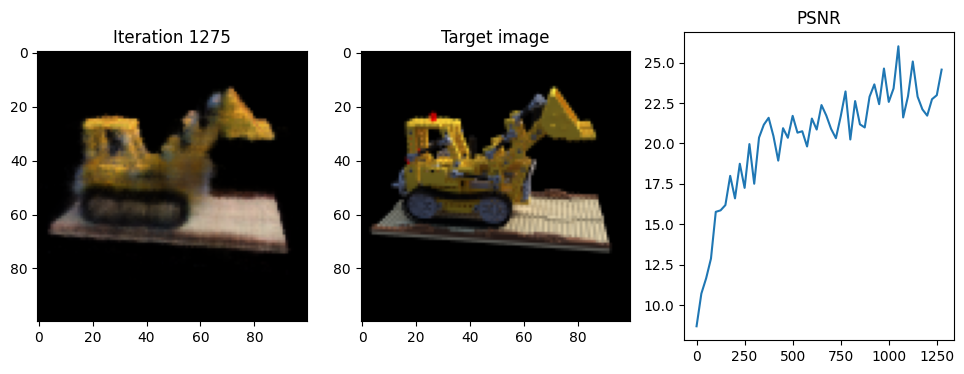

i 1276
i 1277
i 1278
i 1279
i 1280
i 1281
i 1282
i 1283
i 1284
i 1285
i 1286
i 1287
i 1288
i 1289
i 1290
i 1291
i 1292
i 1293
i 1294
i 1295
i 1296
i 1297
i 1298
i 1299
i 1300
Iteration 1300  Loss: 0.0029  PSNR: 22.92  Time: 1.97 secs per iter,  43.57 mins in total


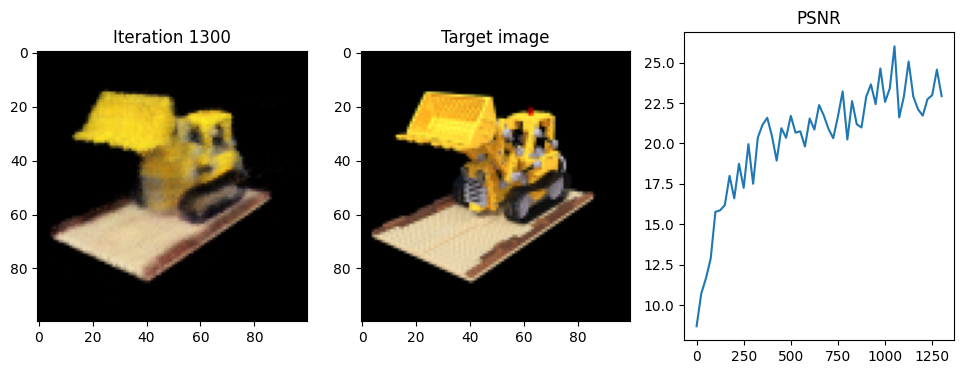

i 1301
i 1302
i 1303
i 1304
i 1305
i 1306
i 1307
i 1308
i 1309
i 1310
i 1311
i 1312
i 1313
i 1314
i 1315
i 1316
i 1317
i 1318
i 1319
i 1320
i 1321
i 1322
i 1323
i 1324
i 1325
Iteration 1325  Loss: 0.0044  PSNR: 21.94  Time: 2.01 secs per iter,  44.40 mins in total


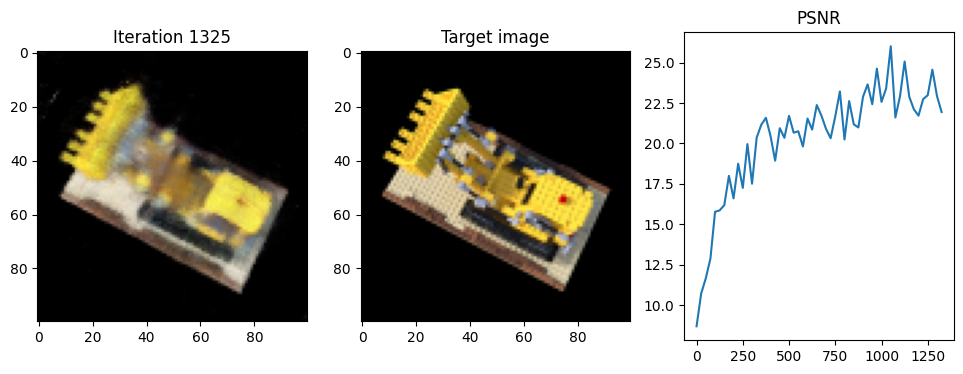

i 1326
i 1327
i 1328
i 1329
i 1330
i 1331
i 1332
i 1333
i 1334
i 1335
i 1336
i 1337
i 1338
i 1339
i 1340
i 1341
i 1342
i 1343
i 1344
i 1345
i 1346
i 1347
i 1348
i 1349
i 1350
Iteration 1350  Loss: 0.0034  PSNR: 22.06  Time: 1.98 secs per iter,  45.23 mins in total


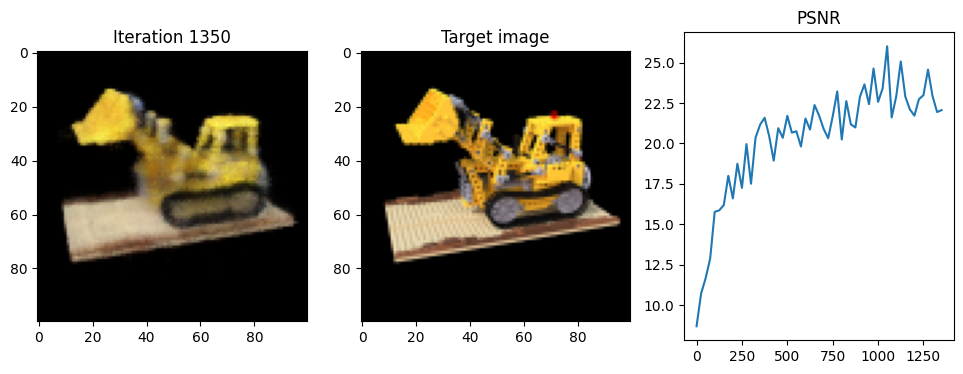

i 1351
i 1352
i 1353
i 1354
i 1355
i 1356
i 1357
i 1358
i 1359
i 1360
i 1361
i 1362
i 1363
i 1364
i 1365
i 1366
i 1367
i 1368
i 1369
i 1370
i 1371
i 1372
i 1373
i 1374
i 1375
Iteration 1375  Loss: 0.0048  PSNR: 22.78  Time: 1.98 secs per iter,  46.05 mins in total


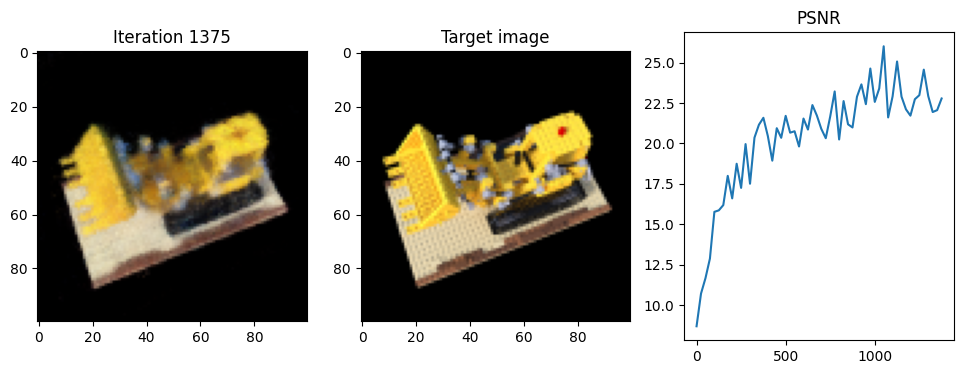

i 1376
i 1377
i 1378
i 1379
i 1380
i 1381
i 1382
i 1383
i 1384
i 1385
i 1386
i 1387
i 1388
i 1389
i 1390
i 1391
i 1392
i 1393
i 1394
i 1395
i 1396
i 1397
i 1398
i 1399
i 1400
Iteration 1400  Loss: 0.0034  PSNR: 22.69  Time: 2.01 secs per iter,  46.89 mins in total


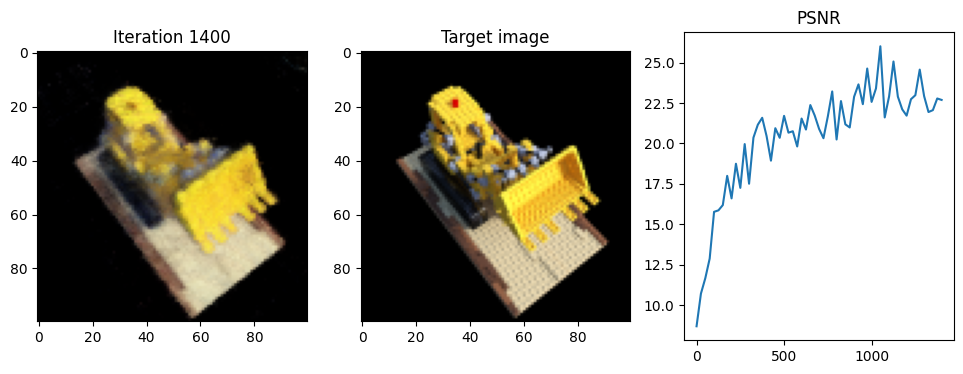

i 1401
i 1402
i 1403
i 1404
i 1405
i 1406
i 1407
i 1408
i 1409
i 1410
i 1411
i 1412
i 1413
i 1414
i 1415
i 1416
i 1417
i 1418
i 1419
i 1420
i 1421
i 1422
i 1423
i 1424
i 1425
Iteration 1425  Loss: 0.0054  PSNR: 24.26  Time: 1.98 secs per iter,  47.72 mins in total


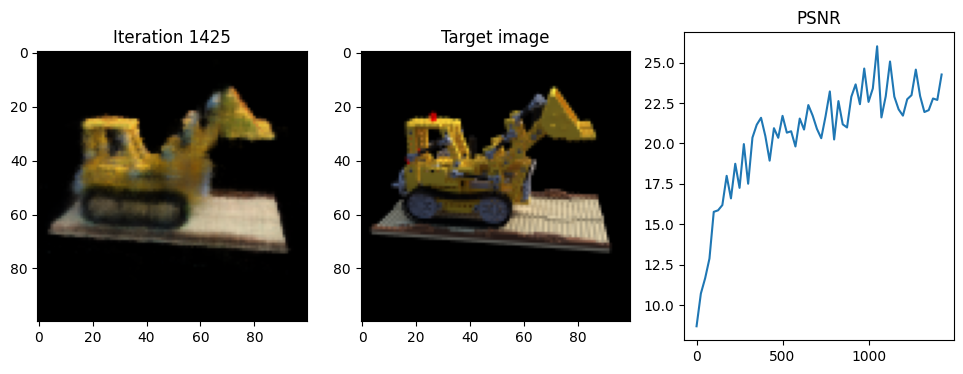

i 1426
i 1427
i 1428
i 1429
i 1430
i 1431
i 1432
i 1433
i 1434
i 1435
i 1436
i 1437
i 1438
i 1439
i 1440
i 1441
i 1442
i 1443
i 1444
i 1445
i 1446
i 1447
i 1448
i 1449
i 1450
Iteration 1450  Loss: 0.0050  PSNR: 22.82  Time: 1.99 secs per iter,  48.55 mins in total


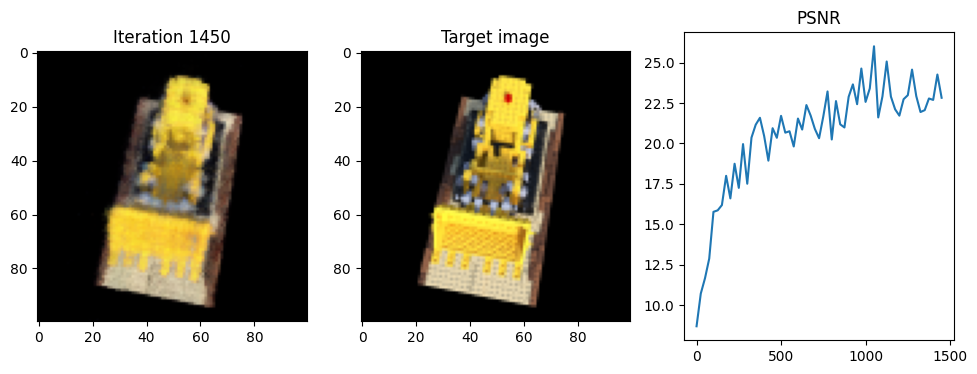

i 1451
i 1452
i 1453
i 1454
i 1455
i 1456
i 1457
i 1458
i 1459
i 1460
i 1461
i 1462
i 1463
i 1464
i 1465
i 1466
i 1467
i 1468
i 1469
i 1470
i 1471
i 1472
i 1473
i 1474
i 1475
Iteration 1475  Loss: 0.0038  PSNR: 24.85  Time: 2.00 secs per iter,  49.38 mins in total


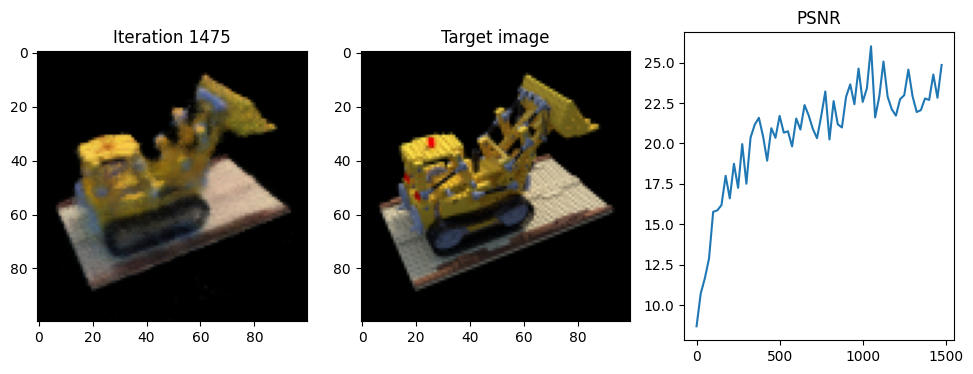

i 1476
i 1477
i 1478
i 1479
i 1480
i 1481
i 1482
i 1483
i 1484
i 1485
i 1486
i 1487
i 1488
i 1489
i 1490
i 1491
i 1492
i 1493
i 1494
i 1495
i 1496
i 1497
i 1498
i 1499
i 1500
Iteration 1500  Loss: 0.0056  PSNR: 25.77  Time: 1.98 secs per iter,  50.21 mins in total


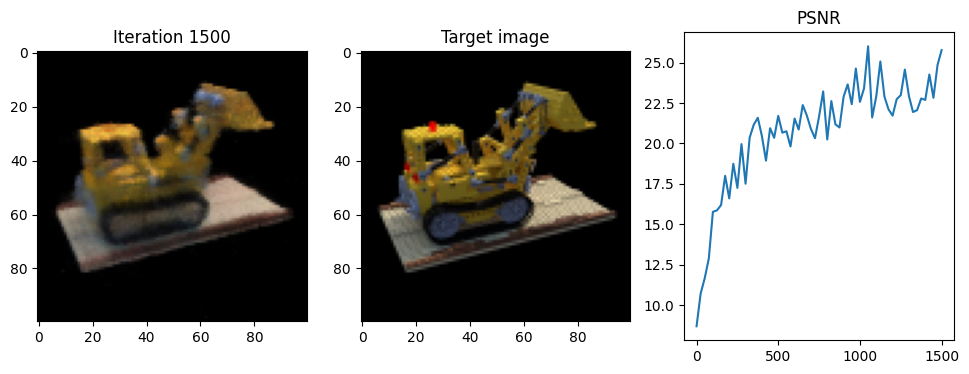

i 1501
i 1502
i 1503
i 1504
i 1505
i 1506
i 1507
i 1508
i 1509
i 1510
i 1511
i 1512
i 1513
i 1514
i 1515
i 1516
i 1517
i 1518
i 1519
i 1520
i 1521
i 1522
i 1523
i 1524
i 1525
Iteration 1525  Loss: 0.0031  PSNR: 23.51  Time: 1.98 secs per iter,  51.03 mins in total


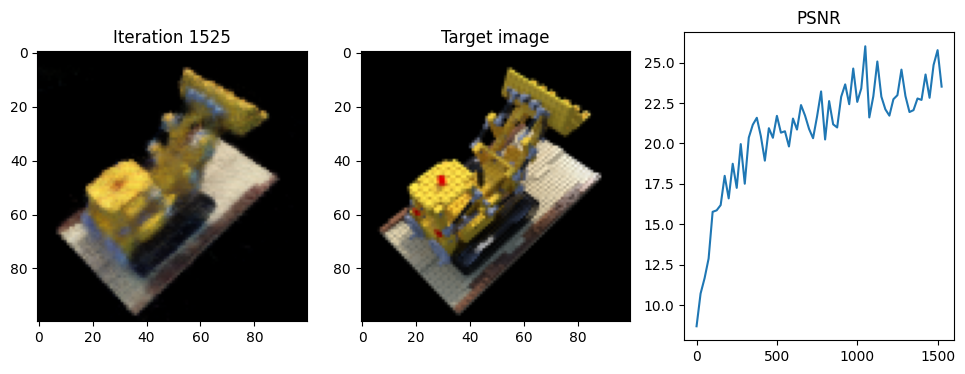

i 1526
i 1527
i 1528
i 1529
i 1530
i 1531
i 1532
i 1533
i 1534
i 1535
i 1536
i 1537
i 1538
i 1539
i 1540
i 1541
i 1542
i 1543
i 1544
i 1545
i 1546
i 1547
i 1548
i 1549
i 1550
Iteration 1550  Loss: 0.0038  PSNR: 23.87  Time: 1.97 secs per iter,  51.85 mins in total


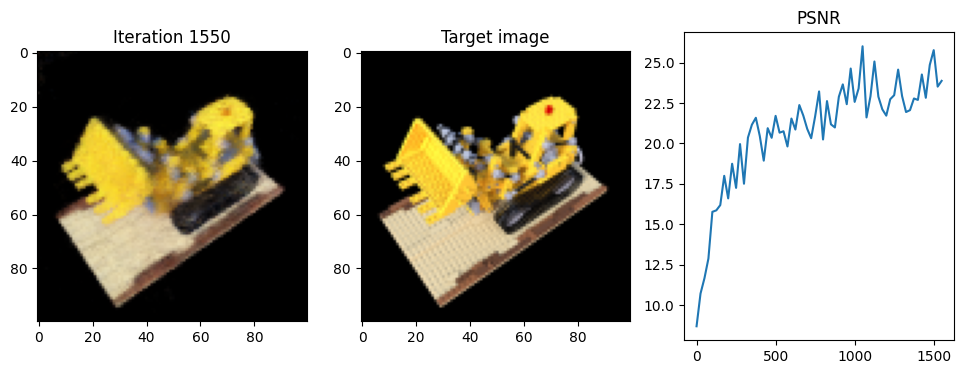

i 1551
i 1552
i 1553
i 1554
i 1555
i 1556
i 1557
i 1558
i 1559
i 1560
i 1561
i 1562
i 1563
i 1564
i 1565
i 1566
i 1567
i 1568
i 1569
i 1570
i 1571
i 1572
i 1573
i 1574
i 1575
Iteration 1575  Loss: 0.0044  PSNR: 23.78  Time: 1.95 secs per iter,  52.66 mins in total


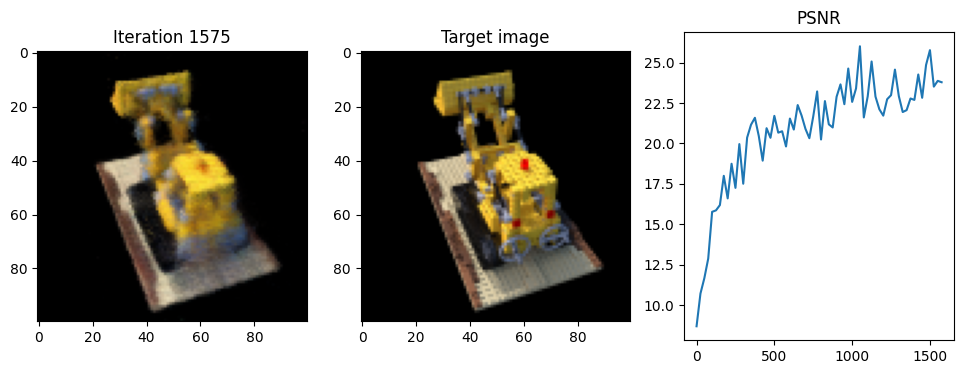

i 1576
i 1577
i 1578
i 1579
i 1580
i 1581
i 1582
i 1583
i 1584
i 1585
i 1586
i 1587
i 1588
i 1589
i 1590
i 1591
i 1592
i 1593
i 1594
i 1595
i 1596
i 1597
i 1598
i 1599
i 1600
Iteration 1600  Loss: 0.0035  PSNR: 23.37  Time: 1.98 secs per iter,  53.49 mins in total


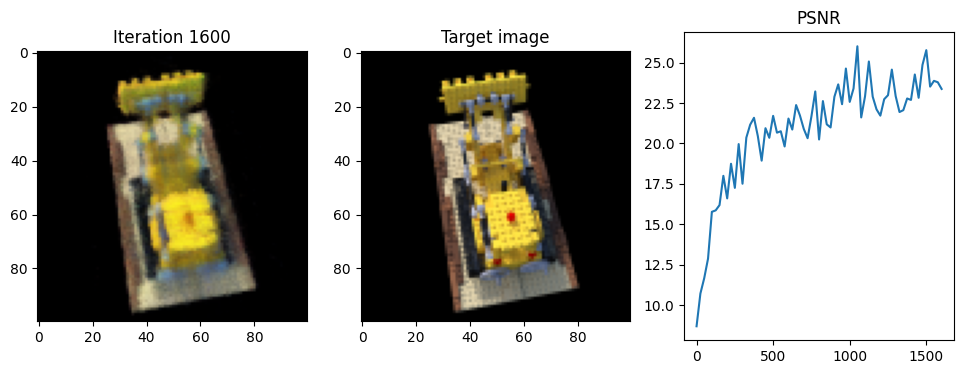

i 1601
i 1602
i 1603
i 1604
i 1605
i 1606
i 1607
i 1608
i 1609
i 1610
i 1611
i 1612
i 1613
i 1614
i 1615
i 1616
i 1617
i 1618
i 1619
i 1620
i 1621
i 1622
i 1623
i 1624
i 1625
Iteration 1625  Loss: 0.0043  PSNR: 24.78  Time: 1.99 secs per iter,  54.32 mins in total


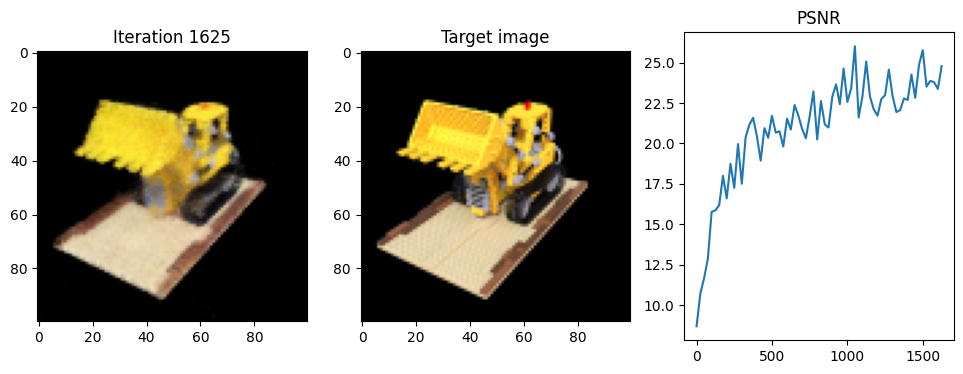

i 1626
i 1627
i 1628
i 1629
i 1630
i 1631
i 1632
i 1633
i 1634
i 1635
i 1636
i 1637
i 1638
i 1639
i 1640
i 1641
i 1642
i 1643
i 1644
i 1645
i 1646
i 1647
i 1648
i 1649
i 1650
Iteration 1650  Loss: 0.0050  PSNR: 23.58  Time: 1.98 secs per iter,  55.14 mins in total


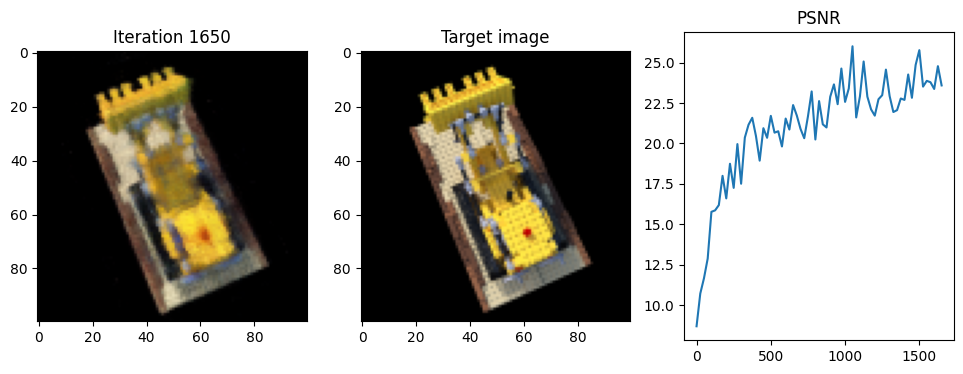

i 1651
i 1652
i 1653
i 1654
i 1655
i 1656
i 1657
i 1658
i 1659
i 1660
i 1661
i 1662
i 1663
i 1664
i 1665
i 1666
i 1667
i 1668
i 1669
i 1670
i 1671
i 1672
i 1673
i 1674
i 1675
Iteration 1675  Loss: 0.0053  PSNR: 25.29  Time: 1.99 secs per iter,  55.97 mins in total


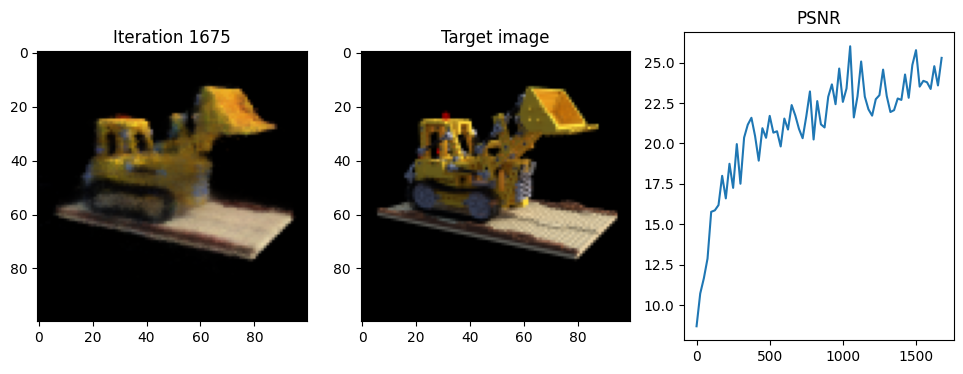

i 1676
i 1677
i 1678
i 1679
i 1680
i 1681
i 1682
i 1683
i 1684
i 1685
i 1686
i 1687
i 1688
i 1689
i 1690
i 1691
i 1692
i 1693
i 1694
i 1695
i 1696
i 1697
i 1698
i 1699
i 1700
Iteration 1700  Loss: 0.0035  PSNR: 23.37  Time: 2.00 secs per iter,  56.80 mins in total


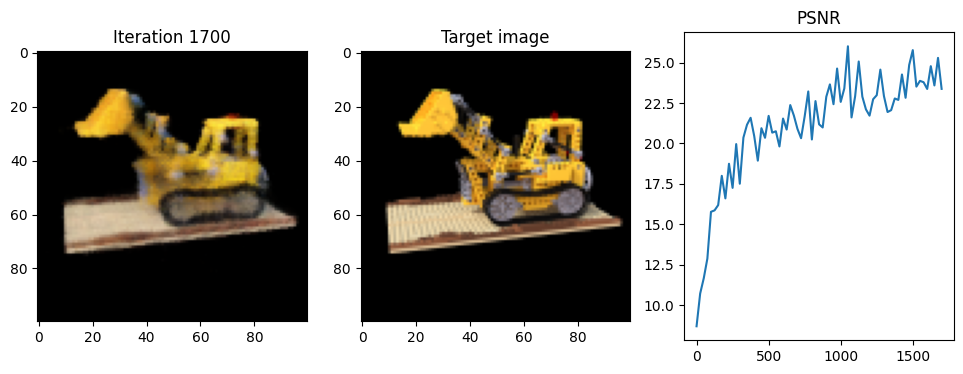

i 1701
i 1702
i 1703
i 1704
i 1705
i 1706
i 1707
i 1708
i 1709
i 1710
i 1711
i 1712
i 1713
i 1714
i 1715
i 1716
i 1717
i 1718
i 1719
i 1720
i 1721
i 1722
i 1723
i 1724
i 1725
Iteration 1725  Loss: 0.0062  PSNR: 24.65  Time: 1.97 secs per iter,  57.63 mins in total


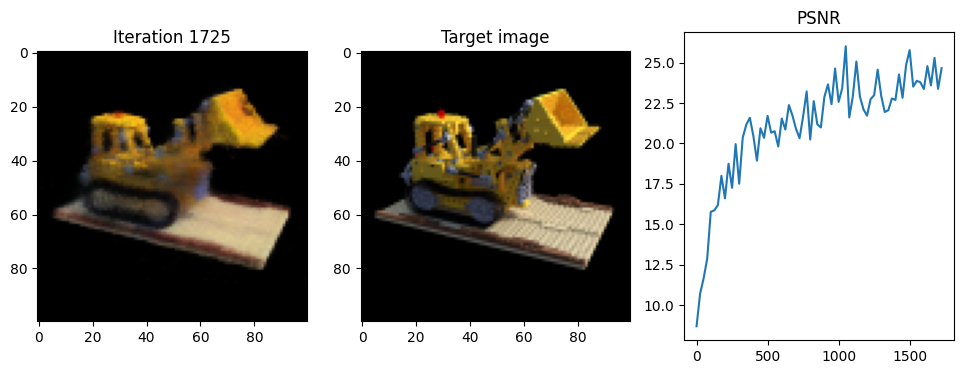

i 1726
i 1727
i 1728
i 1729
i 1730
i 1731
i 1732
i 1733
i 1734
i 1735
i 1736
i 1737
i 1738
i 1739
i 1740
i 1741
i 1742
i 1743
i 1744
i 1745
i 1746
i 1747
i 1748
i 1749
i 1750
Iteration 1750  Loss: 0.0041  PSNR: 23.97  Time: 1.99 secs per iter,  58.46 mins in total


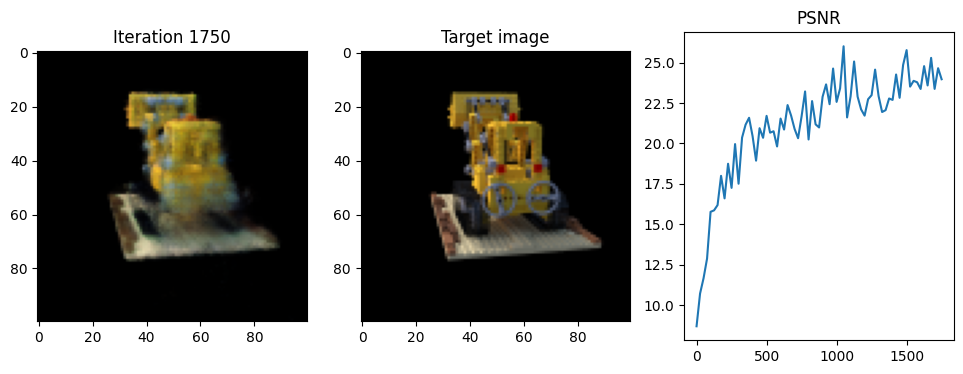

i 1751
i 1752
i 1753
i 1754
i 1755
i 1756
i 1757
i 1758
i 1759
i 1760
i 1761
i 1762
i 1763
i 1764
i 1765
i 1766
i 1767
i 1768
i 1769
i 1770
i 1771
i 1772
i 1773
i 1774
i 1775
Iteration 1775  Loss: 0.0033  PSNR: 25.79  Time: 1.94 secs per iter,  59.26 mins in total


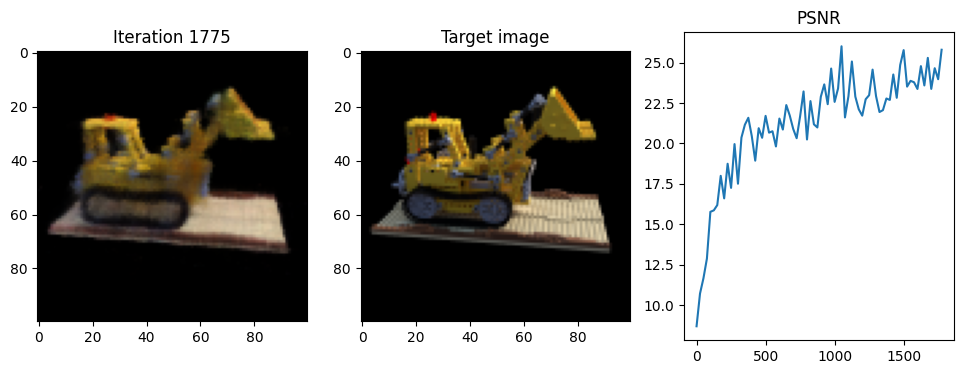

i 1776
i 1777
i 1778
i 1779
i 1780
i 1781
i 1782
i 1783
i 1784
i 1785
i 1786
i 1787
i 1788
i 1789
i 1790
i 1791
i 1792
i 1793
i 1794
i 1795
i 1796
i 1797
i 1798
i 1799
i 1800
Iteration 1800  Loss: 0.0048  PSNR: 22.92  Time: 1.95 secs per iter,  60.08 mins in total


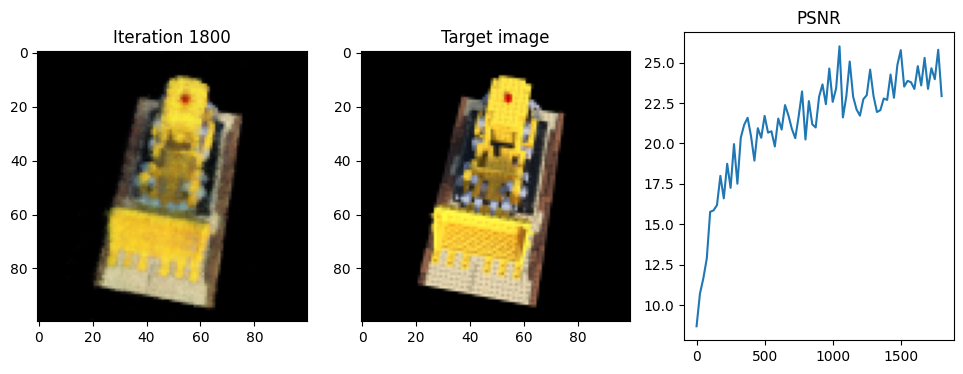

i 1801
i 1802
i 1803
i 1804
i 1805
i 1806
i 1807
i 1808
i 1809
i 1810
i 1811
i 1812
i 1813
i 1814
i 1815
i 1816
i 1817
i 1818
i 1819
i 1820
i 1821
i 1822
i 1823
i 1824
i 1825
Iteration 1825  Loss: 0.0029  PSNR: 24.85  Time: 1.92 secs per iter,  60.88 mins in total


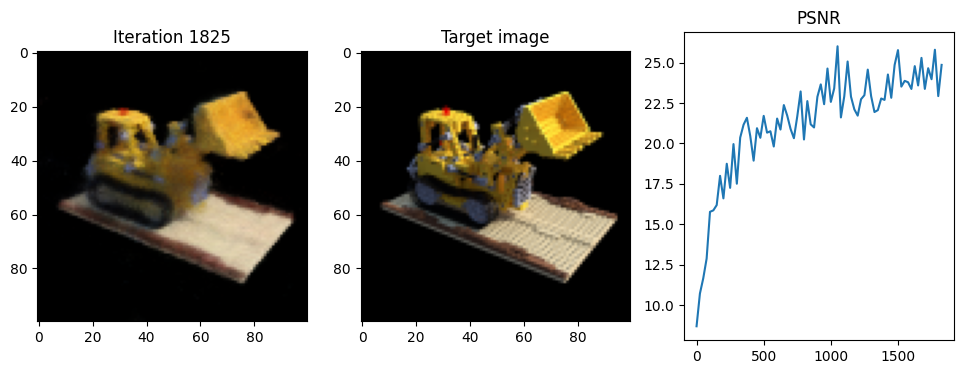

i 1826
i 1827
i 1828
i 1829
i 1830
i 1831
i 1832
i 1833
i 1834
i 1835
i 1836
i 1837
i 1838
i 1839
i 1840
i 1841
i 1842
i 1843
i 1844
i 1845
i 1846
i 1847
i 1848
i 1849
i 1850
Iteration 1850  Loss: 0.0025  PSNR: 23.77  Time: 1.93 secs per iter,  61.68 mins in total


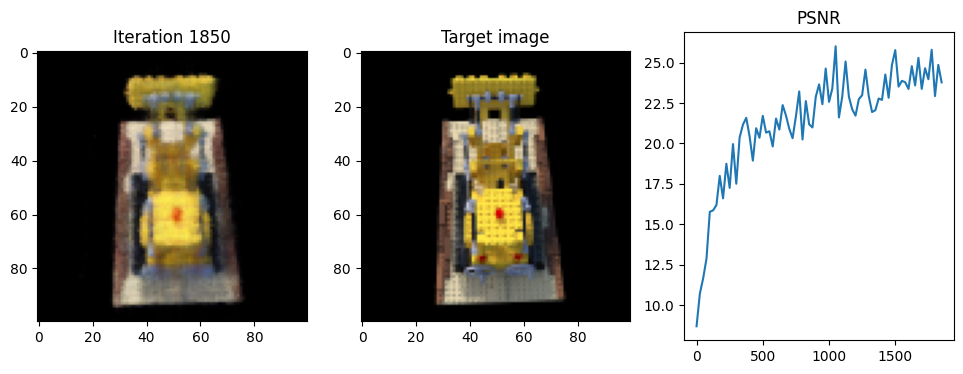

i 1851
i 1852
i 1853
i 1854
i 1855
i 1856
i 1857
i 1858
i 1859
i 1860
i 1861
i 1862
i 1863
i 1864
i 1865
i 1866
i 1867
i 1868
i 1869
i 1870
i 1871
i 1872
i 1873
i 1874
i 1875
Iteration 1875  Loss: 0.0043  PSNR: 23.36  Time: 1.99 secs per iter,  62.51 mins in total


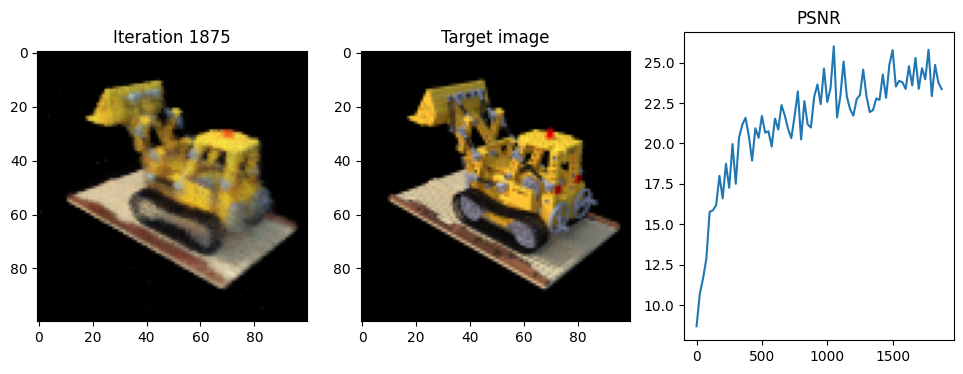

i 1876
i 1877
i 1878
i 1879
i 1880
i 1881
i 1882
i 1883
i 1884
i 1885
i 1886
i 1887
i 1888
i 1889
i 1890
i 1891
i 1892
i 1893
i 1894
i 1895
i 1896
i 1897
i 1898
i 1899
i 1900
Iteration 1900  Loss: 0.0030  PSNR: 23.24  Time: 2.01 secs per iter,  63.35 mins in total


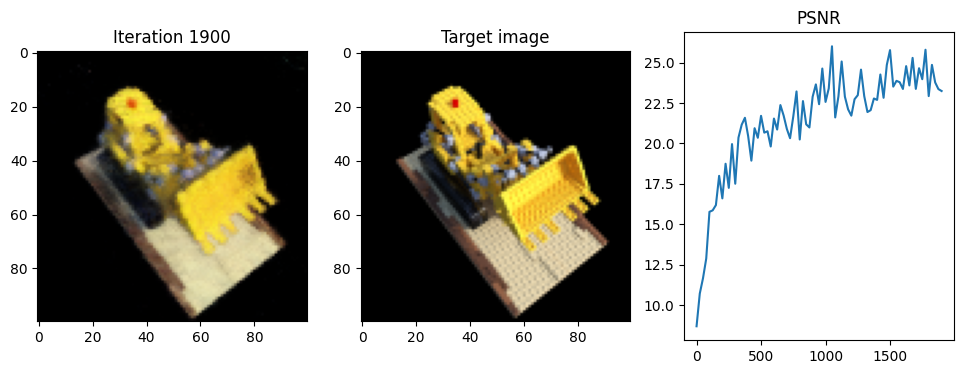

i 1901
i 1902
i 1903
i 1904
i 1905
i 1906
i 1907
i 1908
i 1909
i 1910
i 1911
i 1912
i 1913
i 1914
i 1915
i 1916
i 1917
i 1918
i 1919
i 1920
i 1921
i 1922
i 1923
i 1924
i 1925
Iteration 1925  Loss: 0.0044  PSNR: 25.61  Time: 2.00 secs per iter,  64.18 mins in total


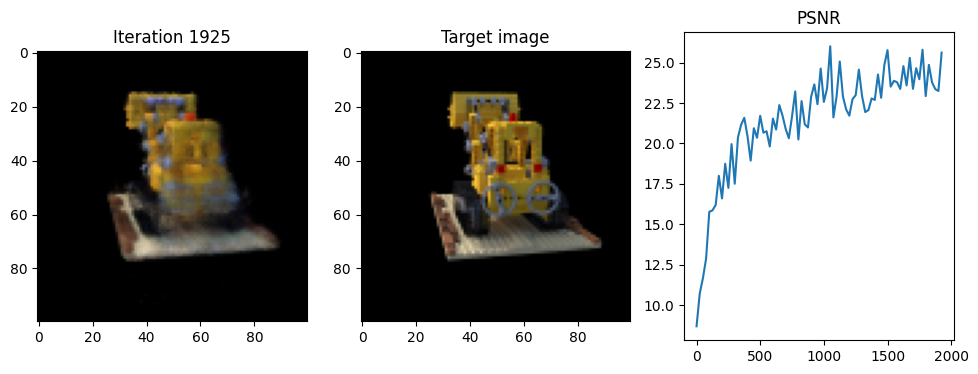

i 1926
i 1927
i 1928
i 1929
i 1930
i 1931
i 1932
i 1933
i 1934
i 1935
i 1936
i 1937
i 1938
i 1939
i 1940
i 1941
i 1942
i 1943
i 1944
i 1945
i 1946
i 1947
i 1948
i 1949
i 1950
Iteration 1950  Loss: 0.0036  PSNR: 23.76  Time: 1.99 secs per iter,  65.01 mins in total


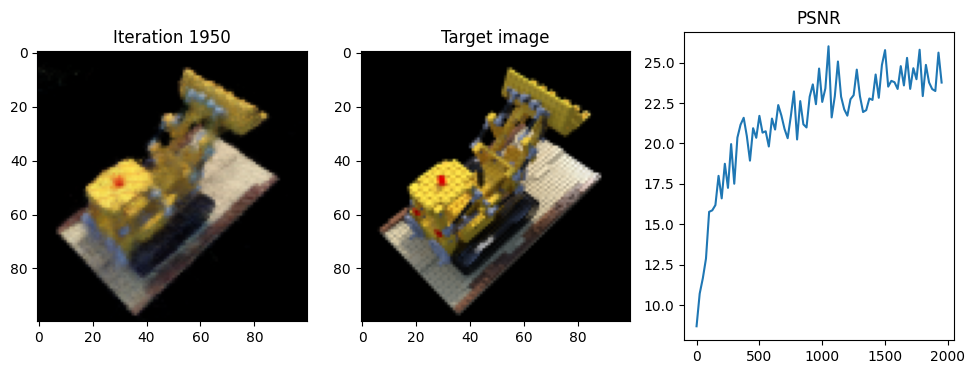

i 1951
i 1952
i 1953
i 1954
i 1955
i 1956
i 1957
i 1958
i 1959
i 1960
i 1961
i 1962
i 1963
i 1964
i 1965
i 1966
i 1967
i 1968
i 1969
i 1970
i 1971
i 1972
i 1973
i 1974
i 1975
Iteration 1975  Loss: 0.0035  PSNR: 25.39  Time: 2.01 secs per iter,  65.85 mins in total


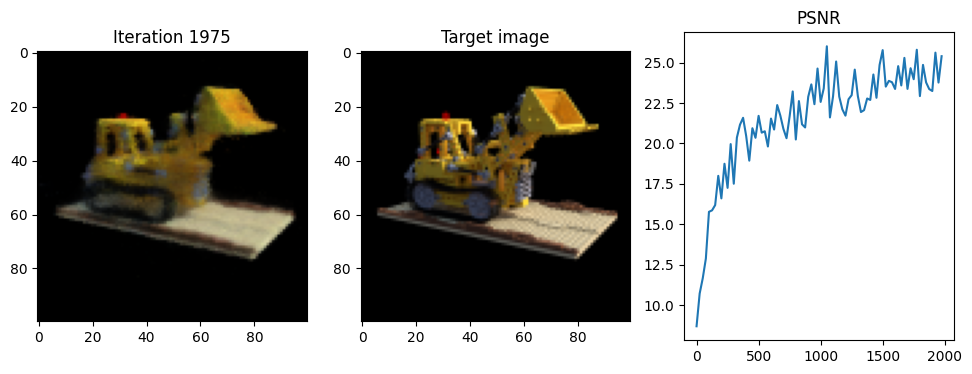

i 1976
i 1977
i 1978
i 1979
i 1980
i 1981
i 1982
i 1983
i 1984
i 1985
i 1986
i 1987
i 1988
i 1989
i 1990
i 1991
i 1992
i 1993
i 1994
i 1995
i 1996
i 1997
i 1998
i 1999
i 2000
Iteration 2000  Loss: 0.0032  PSNR: 23.11  Time: 1.98 secs per iter,  66.68 mins in total


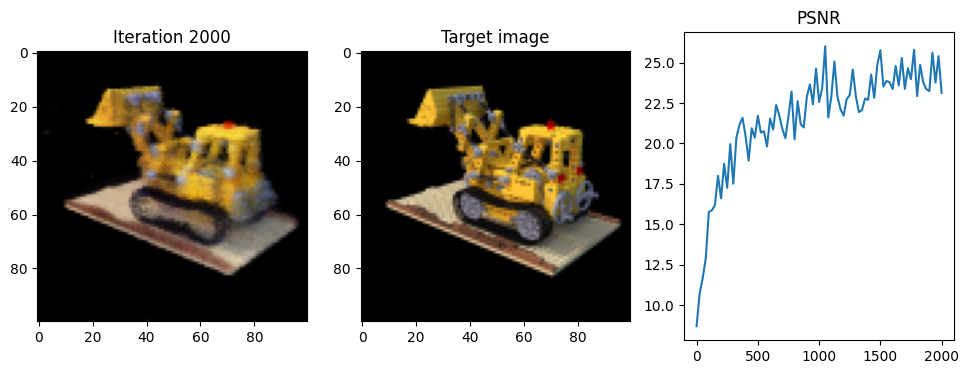

i 2001
i 2002
i 2003
i 2004
i 2005
i 2006
i 2007
i 2008
i 2009
i 2010
i 2011
i 2012
i 2013
i 2014
i 2015
i 2016
i 2017
i 2018
i 2019
i 2020
i 2021
i 2022
i 2023
i 2024
i 2025
Iteration 2025  Loss: 0.0034  PSNR: 25.17  Time: 1.99 secs per iter,  67.51 mins in total


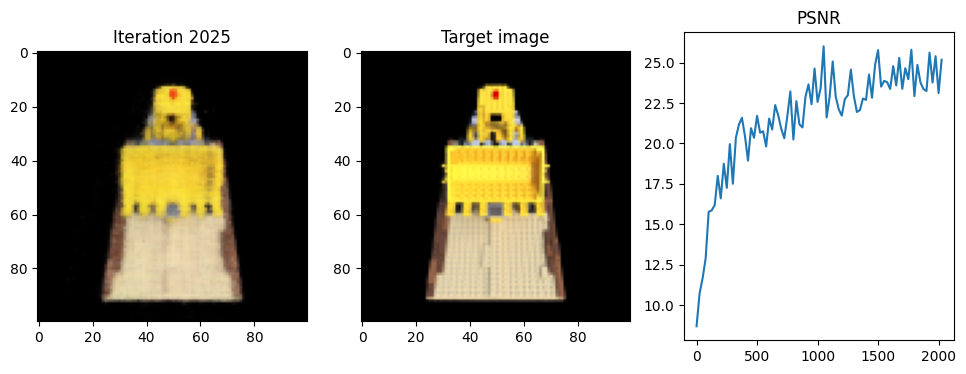

i 2026
i 2027
i 2028
i 2029
i 2030
i 2031
i 2032
i 2033
i 2034
i 2035
i 2036
i 2037
i 2038
i 2039
i 2040
i 2041
i 2042
i 2043
i 2044
i 2045
i 2046
i 2047
i 2048
i 2049
i 2050
Iteration 2050  Loss: 0.0036  PSNR: 23.59  Time: 2.00 secs per iter,  68.34 mins in total


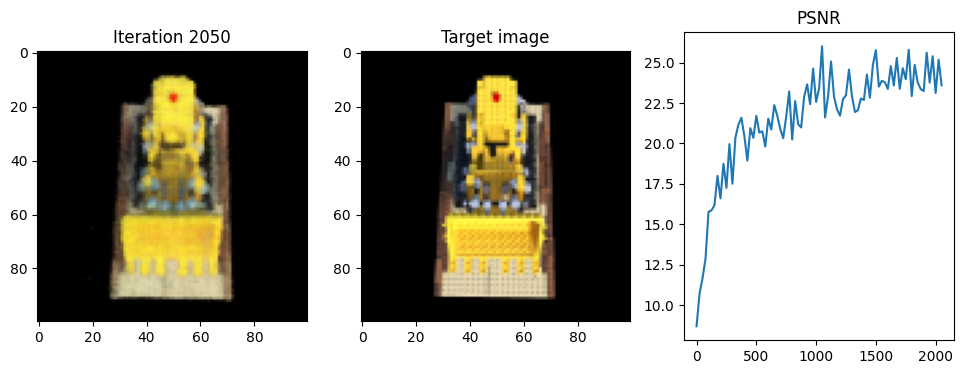

i 2051
i 2052
i 2053
i 2054
i 2055
i 2056
i 2057
i 2058
i 2059
i 2060
i 2061
i 2062
i 2063
i 2064
i 2065
i 2066
i 2067
i 2068
i 2069
i 2070
i 2071
i 2072
i 2073
i 2074
i 2075
Iteration 2075  Loss: 0.0024  PSNR: 23.07  Time: 2.00 secs per iter,  69.17 mins in total


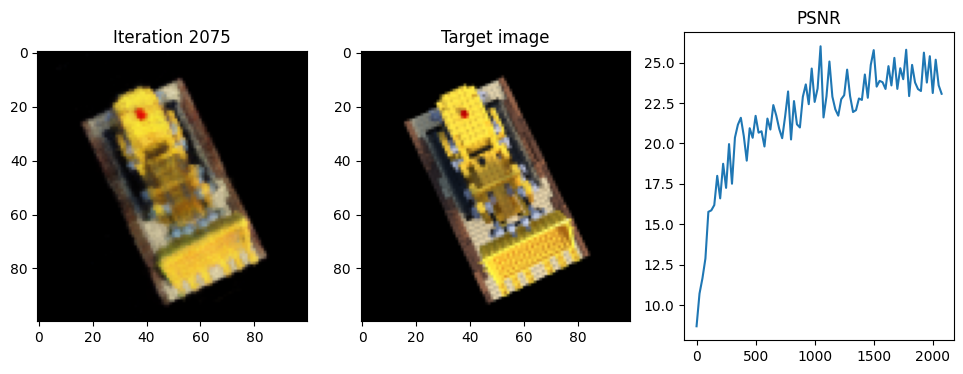

i 2076
i 2077
i 2078
i 2079
i 2080
i 2081
i 2082
i 2083
i 2084
i 2085
i 2086
i 2087
i 2088
i 2089
i 2090
i 2091
i 2092
i 2093
i 2094
i 2095
i 2096
i 2097
i 2098
i 2099
i 2100
Iteration 2100  Loss: 0.0027  PSNR: 25.04  Time: 1.98 secs per iter,  70.00 mins in total


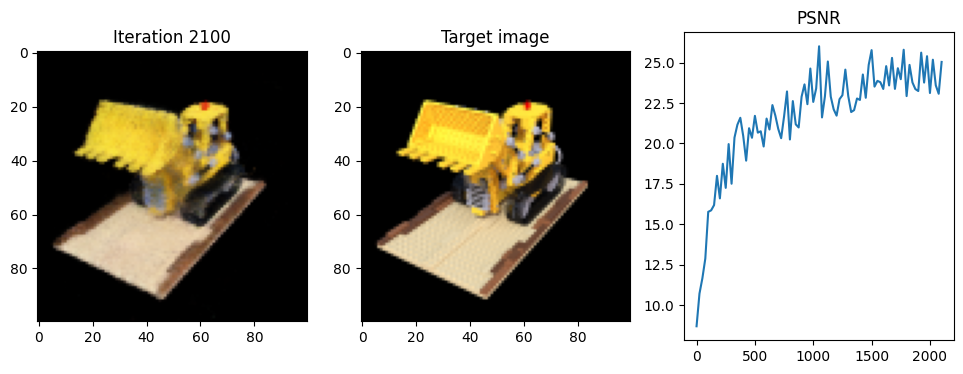

i 2101
i 2102
i 2103
i 2104
i 2105
i 2106
i 2107
i 2108
i 2109
i 2110
i 2111
i 2112
i 2113
i 2114
i 2115
i 2116
i 2117
i 2118
i 2119
i 2120
i 2121
i 2122
i 2123
i 2124
i 2125
Iteration 2125  Loss: 0.0029  PSNR: 23.77  Time: 2.01 secs per iter,  70.83 mins in total


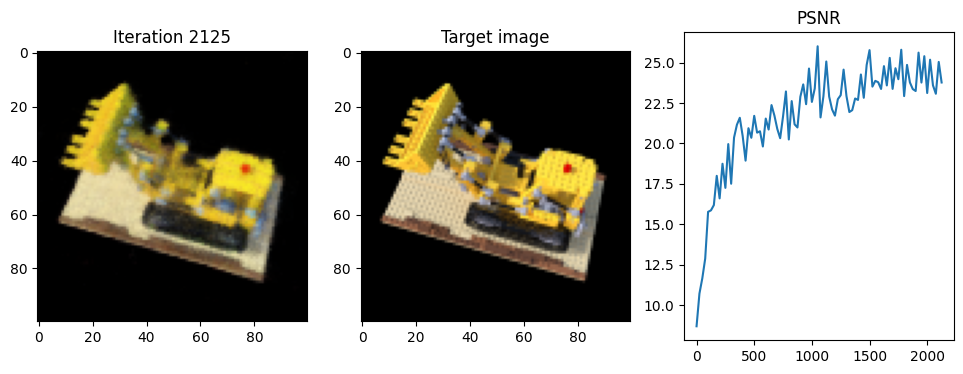

i 2126
i 2127
i 2128
i 2129
i 2130
i 2131
i 2132
i 2133
i 2134
i 2135
i 2136
i 2137
i 2138
i 2139
i 2140
i 2141
i 2142
i 2143
i 2144
i 2145
i 2146
i 2147
i 2148
i 2149
i 2150
Iteration 2150  Loss: 0.0040  PSNR: 25.15  Time: 1.99 secs per iter,  71.66 mins in total


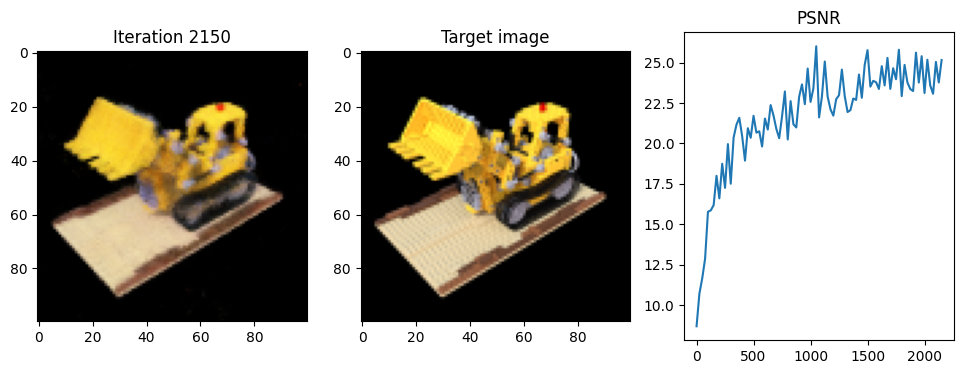

i 2151
i 2152
i 2153
i 2154
i 2155
i 2156
i 2157
i 2158
i 2159
i 2160
i 2161
i 2162
i 2163
i 2164
i 2165
i 2166
i 2167
i 2168
i 2169
i 2170
i 2171
i 2172
i 2173
i 2174
i 2175
Iteration 2175  Loss: 0.0042  PSNR: 24.99  Time: 1.98 secs per iter,  72.49 mins in total


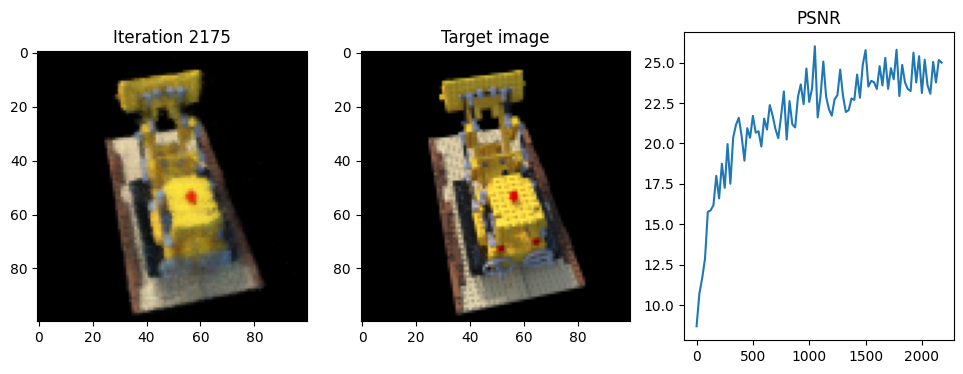

i 2176
i 2177
i 2178
i 2179
i 2180
i 2181
i 2182
i 2183
i 2184
i 2185
i 2186
i 2187
i 2188
i 2189
i 2190
i 2191
i 2192
i 2193
i 2194
i 2195
i 2196
i 2197
i 2198
i 2199
i 2200
Iteration 2200  Loss: 0.0041  PSNR: 25.97  Time: 2.01 secs per iter,  73.33 mins in total


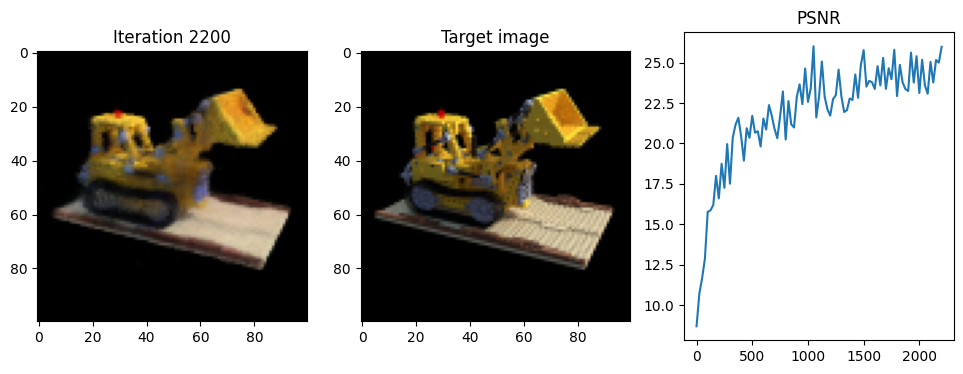

i 2201
i 2202
i 2203
i 2204
i 2205
i 2206
i 2207
i 2208
i 2209
i 2210
i 2211
i 2212
i 2213
i 2214
i 2215
i 2216
i 2217
i 2218
i 2219
i 2220
i 2221
i 2222
i 2223
i 2224
i 2225
Iteration 2225  Loss: 0.0034  PSNR: 27.89  Time: 2.00 secs per iter,  74.16 mins in total


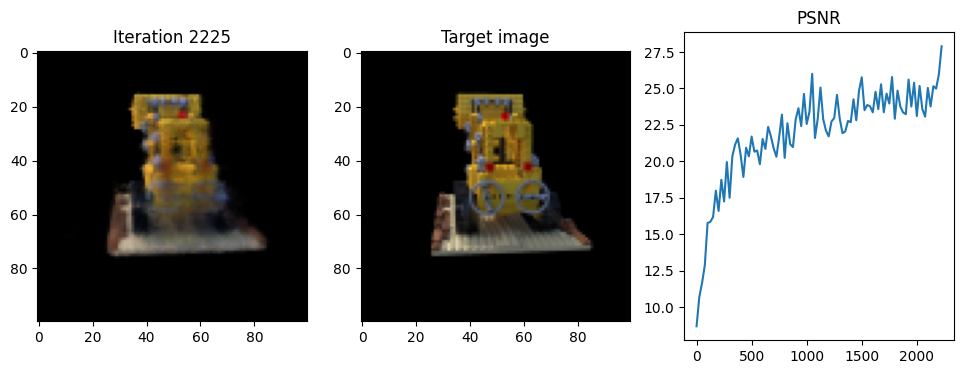

i 2226
i 2227
i 2228
i 2229
i 2230
i 2231
i 2232
i 2233
i 2234
i 2235
i 2236
i 2237
i 2238
i 2239
i 2240
i 2241
i 2242
i 2243
i 2244
i 2245
i 2246
i 2247
i 2248
i 2249
i 2250
Iteration 2250  Loss: 0.0030  PSNR: 27.15  Time: 1.98 secs per iter,  74.99 mins in total


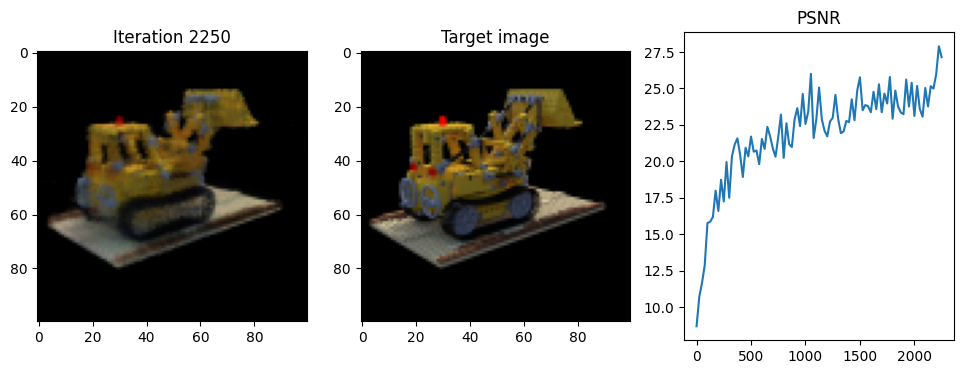

i 2251
i 2252
i 2253
i 2254
i 2255
i 2256
i 2257
i 2258
i 2259
i 2260
i 2261
i 2262
i 2263
i 2264
i 2265
i 2266
i 2267
i 2268
i 2269
i 2270
i 2271
i 2272
i 2273
i 2274
i 2275
Iteration 2275  Loss: 0.0044  PSNR: 26.68  Time: 2.01 secs per iter,  75.82 mins in total


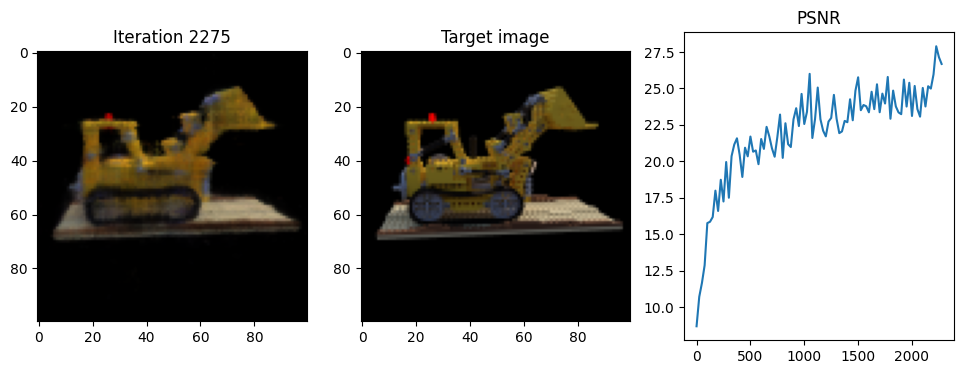

i 2276
i 2277
i 2278
i 2279
i 2280
i 2281
i 2282
i 2283
i 2284
i 2285
i 2286
i 2287
i 2288
i 2289
i 2290
i 2291
i 2292
i 2293
i 2294
i 2295
i 2296
i 2297
i 2298
i 2299
i 2300
Iteration 2300  Loss: 0.0038  PSNR: 26.71  Time: 1.99 secs per iter,  76.65 mins in total


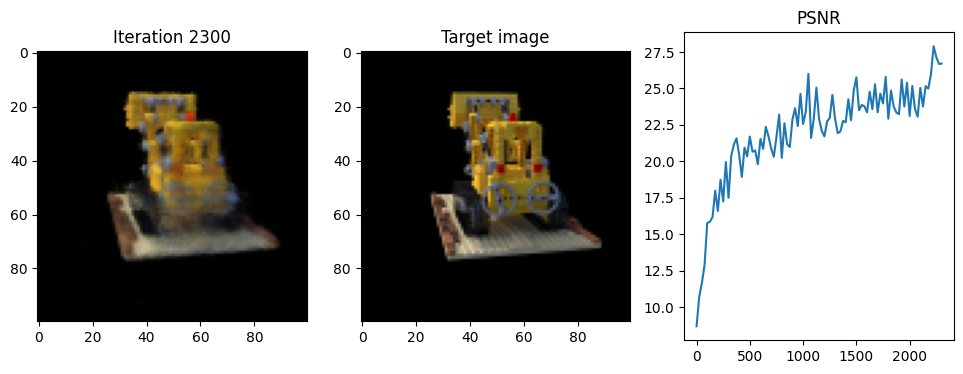

i 2301
i 2302
i 2303
i 2304
i 2305
i 2306
i 2307
i 2308
i 2309
i 2310
i 2311
i 2312
i 2313
i 2314
i 2315
i 2316
i 2317
i 2318
i 2319
i 2320
i 2321
i 2322
i 2323
i 2324
i 2325
Iteration 2325  Loss: 0.0022  PSNR: 26.49  Time: 1.98 secs per iter,  77.48 mins in total


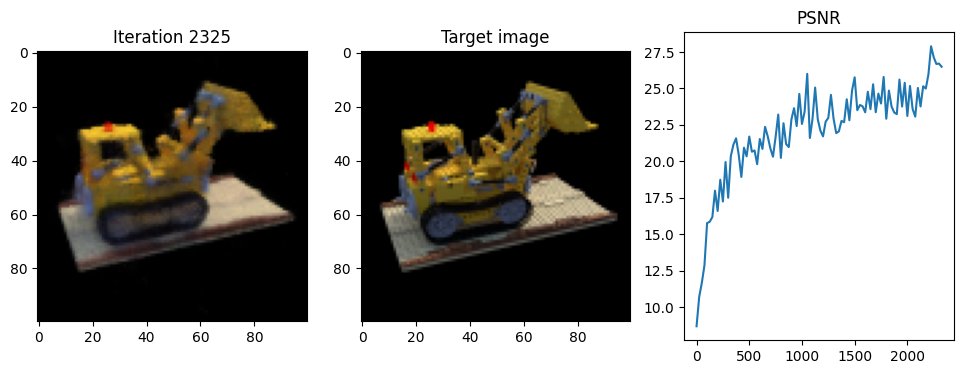

i 2326
i 2327
i 2328
i 2329
i 2330
i 2331
i 2332
i 2333
i 2334
i 2335
i 2336
i 2337
i 2338
i 2339
i 2340
i 2341
i 2342
i 2343
i 2344
i 2345
i 2346
i 2347
i 2348
i 2349
i 2350
Iteration 2350  Loss: 0.0024  PSNR: 25.26  Time: 2.02 secs per iter,  78.32 mins in total


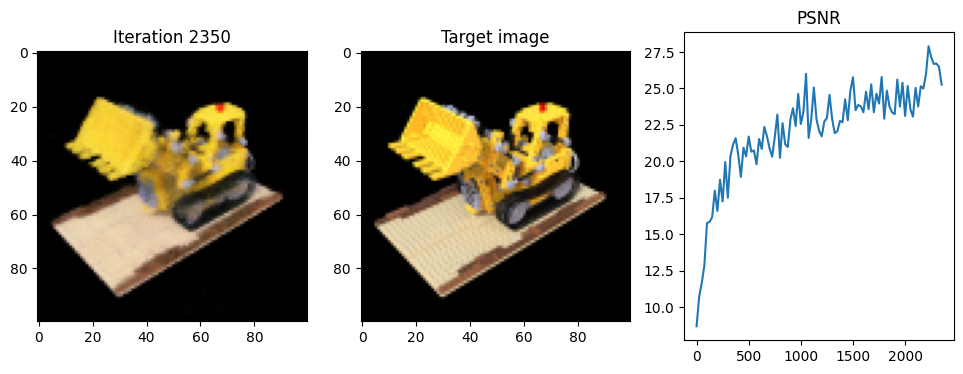

i 2351
i 2352
i 2353
i 2354
i 2355
i 2356
i 2357
i 2358
i 2359
i 2360
i 2361
i 2362
i 2363
i 2364
i 2365
i 2366
i 2367
i 2368
i 2369
i 2370
i 2371
i 2372
i 2373
i 2374
i 2375
Iteration 2375  Loss: 0.0019  PSNR: 23.04  Time: 2.00 secs per iter,  79.15 mins in total


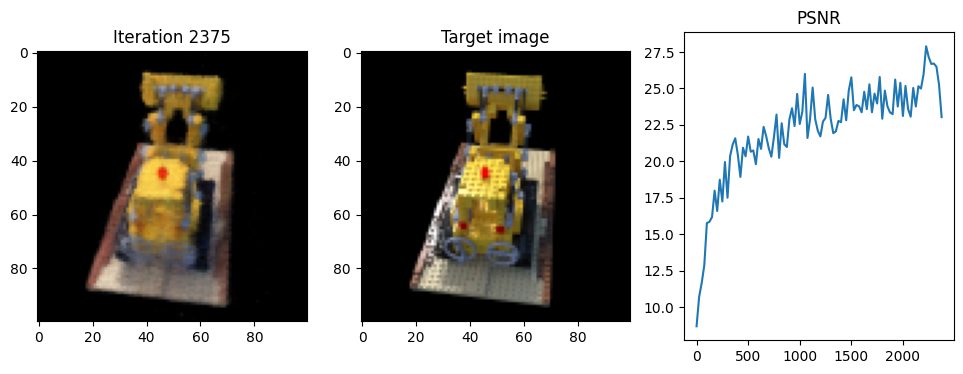

i 2376
i 2377
i 2378
i 2379
i 2380
i 2381
i 2382
i 2383
i 2384
i 2385
i 2386
i 2387
i 2388
i 2389
i 2390
i 2391
i 2392
i 2393
i 2394
i 2395
i 2396
i 2397
i 2398
i 2399
i 2400
Iteration 2400  Loss: 0.0029  PSNR: 22.96  Time: 2.01 secs per iter,  79.99 mins in total


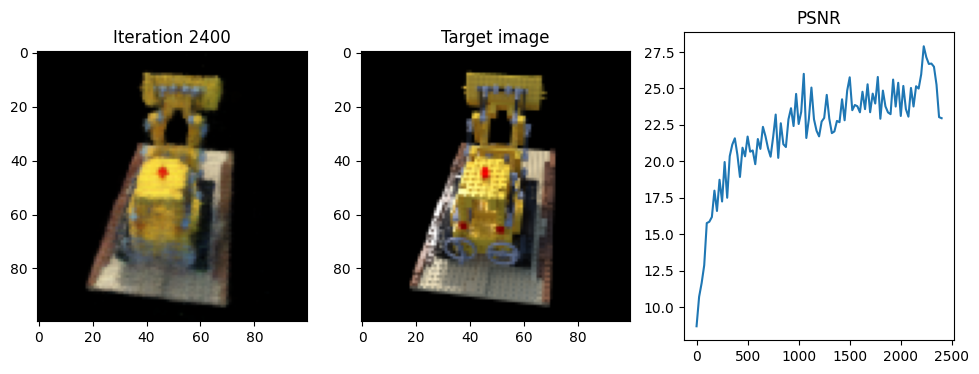

i 2401
i 2402
i 2403
i 2404
i 2405
i 2406
i 2407
i 2408
i 2409
i 2410
i 2411
i 2412
i 2413
i 2414
i 2415
i 2416
i 2417
i 2418
i 2419
i 2420
i 2421
i 2422
i 2423
i 2424
i 2425
Iteration 2425  Loss: 0.0027  PSNR: 24.26  Time: 2.05 secs per iter,  80.85 mins in total


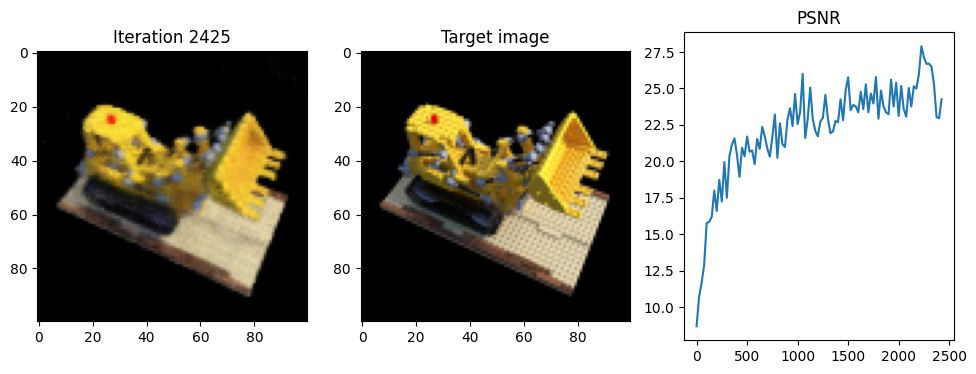

i 2426
i 2427
i 2428
i 2429
i 2430
i 2431
i 2432
i 2433
i 2434
i 2435
i 2436
i 2437
i 2438
i 2439
i 2440
i 2441
i 2442
i 2443
i 2444
i 2445
i 2446
i 2447
i 2448
i 2449
i 2450
Iteration 2450  Loss: 0.0016  PSNR: 27.53  Time: 2.00 secs per iter,  81.68 mins in total


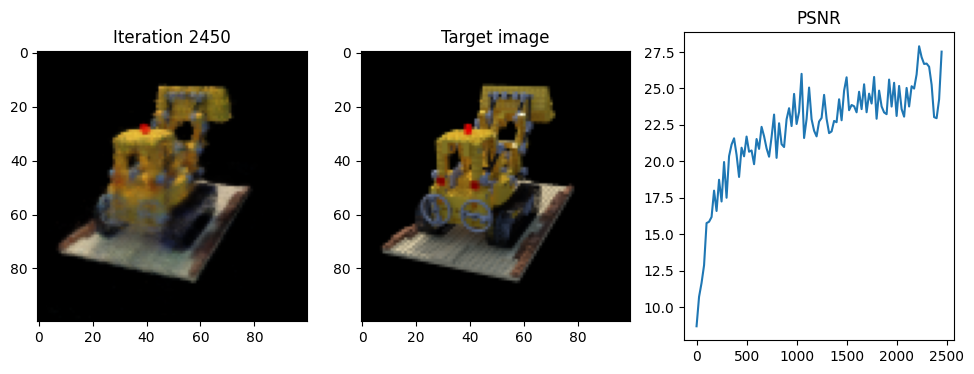

i 2451
i 2452
i 2453
i 2454
i 2455
i 2456
i 2457
i 2458
i 2459
i 2460
i 2461
i 2462
i 2463
i 2464
i 2465
i 2466
i 2467
i 2468
i 2469
i 2470
i 2471
i 2472
i 2473
i 2474
i 2475
Iteration 2475  Loss: 0.0020  PSNR: 24.78  Time: 2.00 secs per iter,  82.51 mins in total


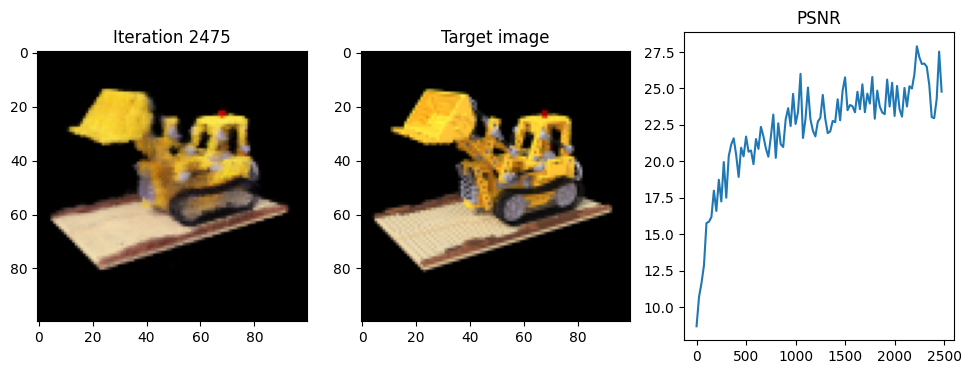

i 2476
i 2477
i 2478
i 2479
i 2480
i 2481
i 2482
i 2483
i 2484
i 2485
i 2486
i 2487
i 2488
i 2489
i 2490
i 2491
i 2492
i 2493
i 2494
i 2495
i 2496
i 2497
i 2498
i 2499
i 2500
Iteration 2500  Loss: 0.0041  PSNR: 25.50  Time: 2.02 secs per iter,  83.35 mins in total


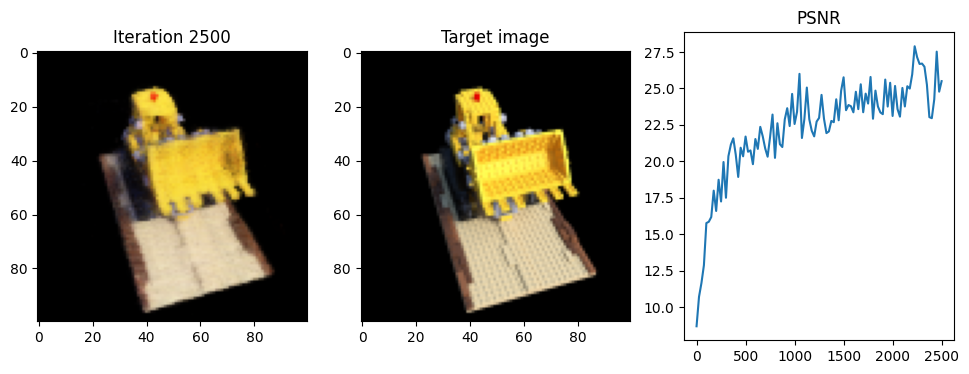

i 2501
i 2502
i 2503
i 2504
i 2505
i 2506
i 2507
i 2508
i 2509
i 2510
i 2511
i 2512
i 2513
i 2514
i 2515
i 2516
i 2517
i 2518
i 2519
i 2520
i 2521
i 2522
i 2523
i 2524
i 2525
Iteration 2525  Loss: 0.0021  PSNR: 26.32  Time: 2.00 secs per iter,  84.18 mins in total


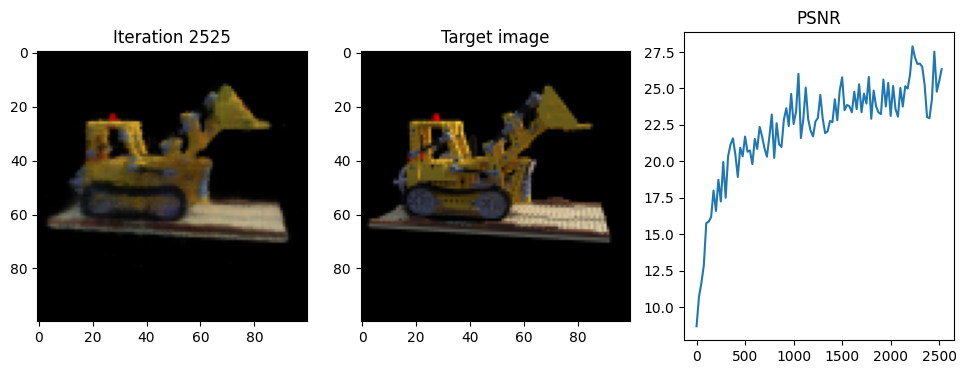

i 2526
i 2527
i 2528
i 2529
i 2530
i 2531
i 2532
i 2533
i 2534
i 2535
i 2536
i 2537
i 2538
i 2539
i 2540
i 2541
i 2542
i 2543
i 2544
i 2545
i 2546
i 2547
i 2548
i 2549
i 2550
Iteration 2550  Loss: 0.0023  PSNR: 26.60  Time: 2.00 secs per iter,  85.02 mins in total


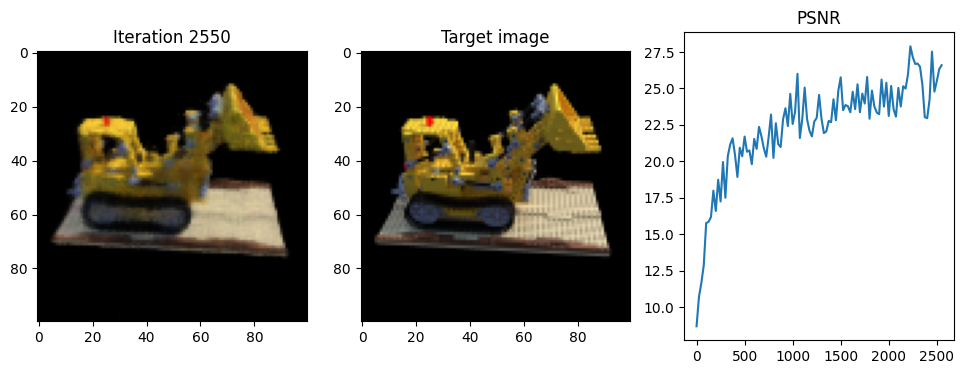

i 2551
i 2552
i 2553
i 2554
i 2555
i 2556
i 2557
i 2558
i 2559
i 2560
i 2561
i 2562
i 2563
i 2564
i 2565
i 2566
i 2567
i 2568
i 2569
i 2570
i 2571
i 2572
i 2573
i 2574
i 2575
Iteration 2575  Loss: 0.0020  PSNR: 26.31  Time: 2.02 secs per iter,  85.86 mins in total


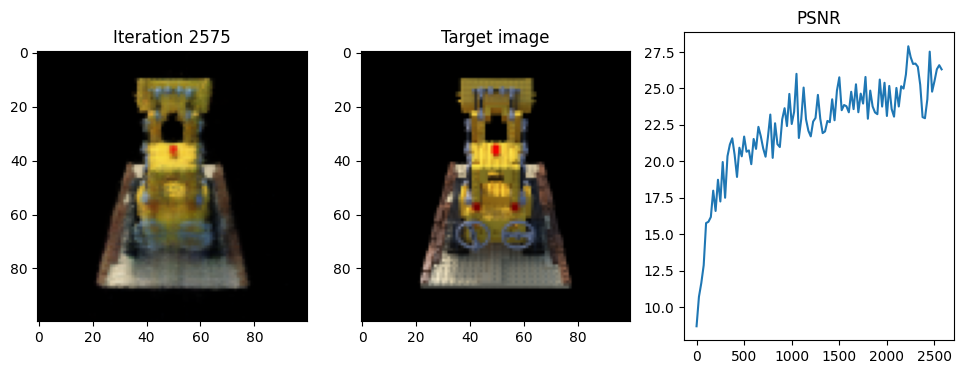

i 2576
i 2577
i 2578
i 2579
i 2580
i 2581
i 2582
i 2583
i 2584
i 2585
i 2586
i 2587
i 2588
i 2589
i 2590
i 2591
i 2592
i 2593
i 2594
i 2595
i 2596
i 2597
i 2598
i 2599
i 2600
Iteration 2600  Loss: 0.0034  PSNR: 27.62  Time: 2.00 secs per iter,  86.69 mins in total


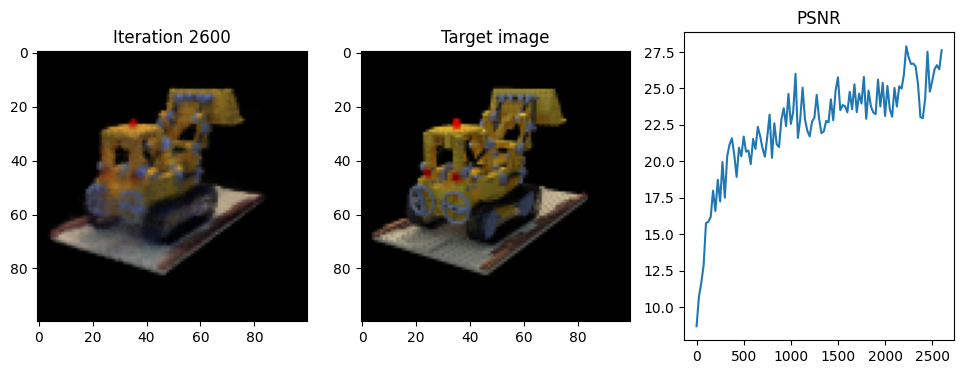

i 2601
i 2602
i 2603
i 2604
i 2605
i 2606
i 2607
i 2608
i 2609
i 2610
i 2611
i 2612
i 2613
i 2614
i 2615
i 2616
i 2617
i 2618
i 2619
i 2620
i 2621
i 2622
i 2623
i 2624
i 2625
Iteration 2625  Loss: 0.0027  PSNR: 25.72  Time: 2.00 secs per iter,  87.52 mins in total


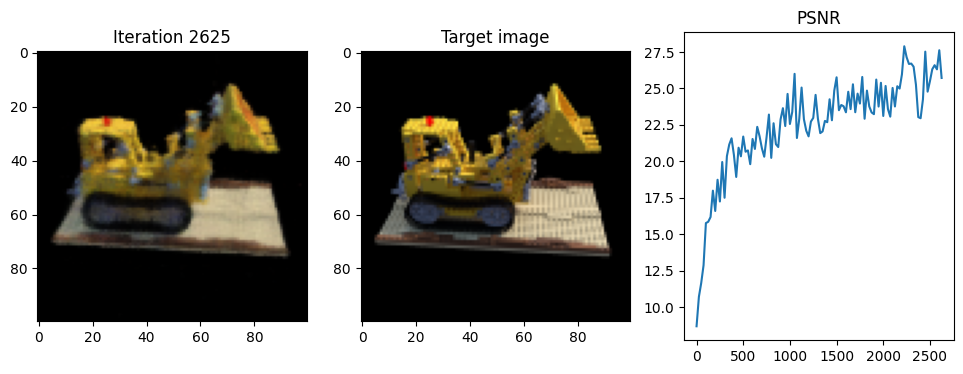

i 2626
i 2627
i 2628
i 2629
i 2630
i 2631
i 2632
i 2633
i 2634
i 2635
i 2636
i 2637
i 2638
i 2639
i 2640
i 2641
i 2642
i 2643
i 2644
i 2645
i 2646
i 2647
i 2648
i 2649
i 2650
Iteration 2650  Loss: 0.0031  PSNR: 24.87  Time: 2.01 secs per iter,  88.36 mins in total


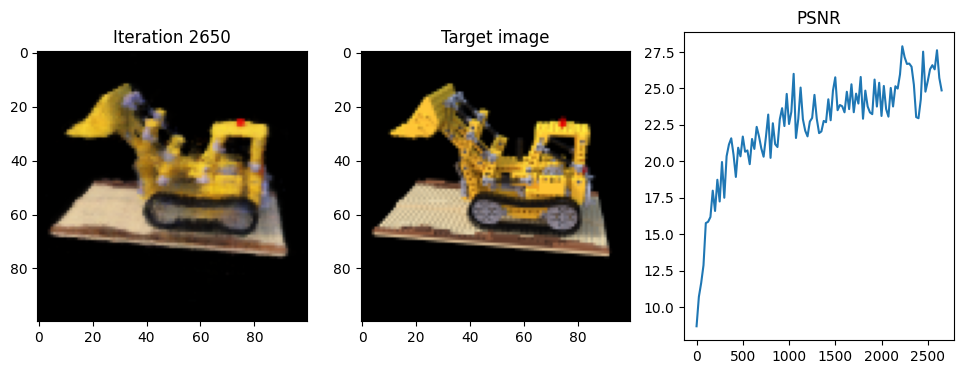

i 2651
i 2652
i 2653
i 2654
i 2655
i 2656
i 2657
i 2658
i 2659
i 2660
i 2661
i 2662
i 2663
i 2664
i 2665
i 2666
i 2667
i 2668
i 2669
i 2670
i 2671
i 2672
i 2673
i 2674
i 2675
Iteration 2675  Loss: 0.0029  PSNR: 28.24  Time: 2.00 secs per iter,  89.20 mins in total


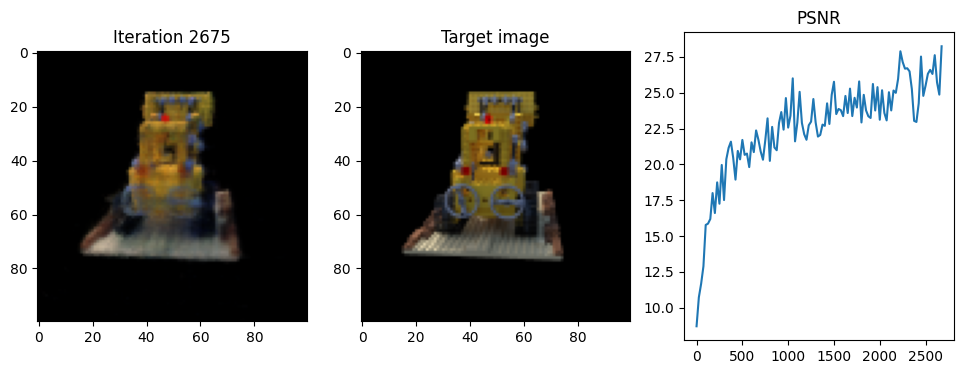

i 2676
i 2677
i 2678
i 2679
i 2680
i 2681
i 2682
i 2683
i 2684
i 2685
i 2686
i 2687
i 2688
i 2689
i 2690
i 2691
i 2692
i 2693
i 2694
i 2695
i 2696
i 2697
i 2698
i 2699
i 2700
Iteration 2700  Loss: 0.0034  PSNR: 25.59  Time: 2.00 secs per iter,  90.03 mins in total


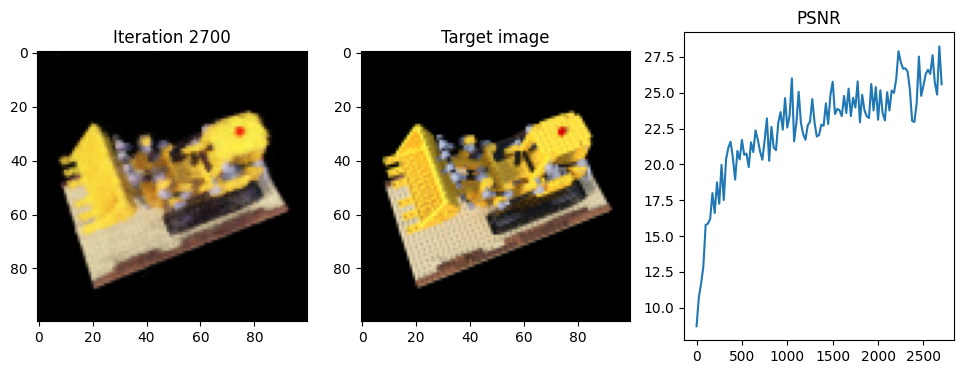

i 2701
i 2702
i 2703
i 2704
i 2705
i 2706
i 2707
i 2708
i 2709
i 2710
i 2711
i 2712
i 2713
i 2714
i 2715
i 2716
i 2717
i 2718
i 2719
i 2720
i 2721
i 2722
i 2723
i 2724
i 2725
Iteration 2725  Loss: 0.0023  PSNR: 24.80  Time: 2.02 secs per iter,  90.87 mins in total


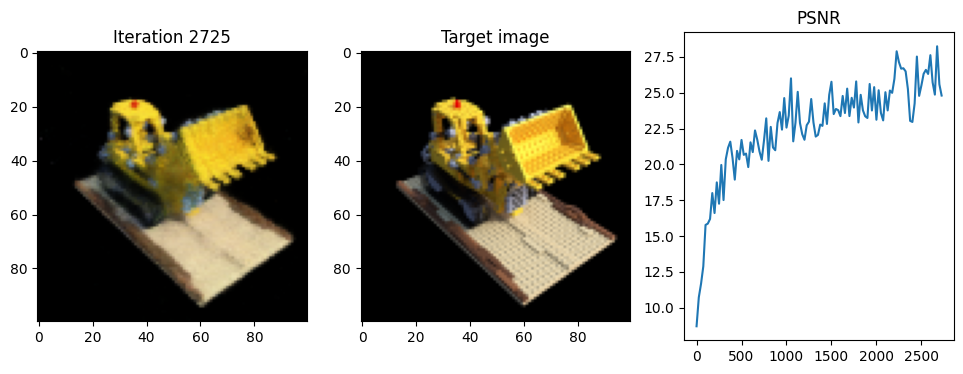

i 2726
i 2727
i 2728
i 2729
i 2730
i 2731
i 2732
i 2733
i 2734
i 2735
i 2736
i 2737
i 2738
i 2739
i 2740
i 2741
i 2742
i 2743
i 2744
i 2745
i 2746
i 2747
i 2748
i 2749
i 2750
Iteration 2750  Loss: 0.0030  PSNR: 24.92  Time: 2.00 secs per iter,  91.70 mins in total


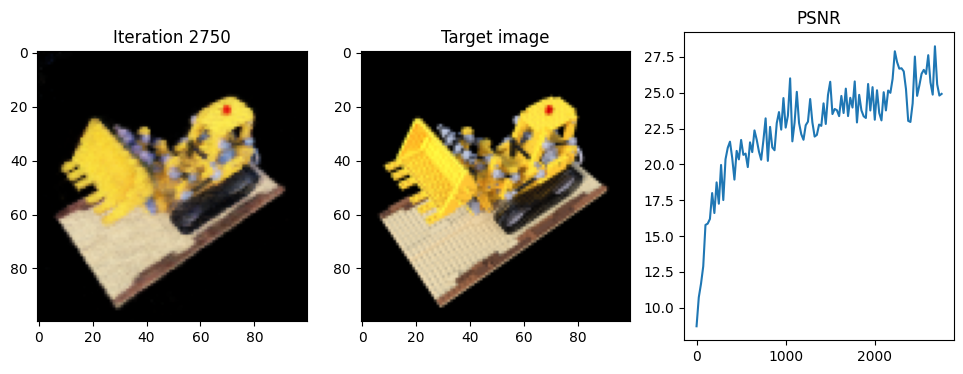

i 2751
i 2752
i 2753
i 2754
i 2755
i 2756
i 2757
i 2758
i 2759
i 2760
i 2761
i 2762
i 2763
i 2764
i 2765
i 2766
i 2767
i 2768
i 2769
i 2770
i 2771
i 2772
i 2773
i 2774
i 2775
Iteration 2775  Loss: 0.0026  PSNR: 25.72  Time: 2.00 secs per iter,  92.53 mins in total


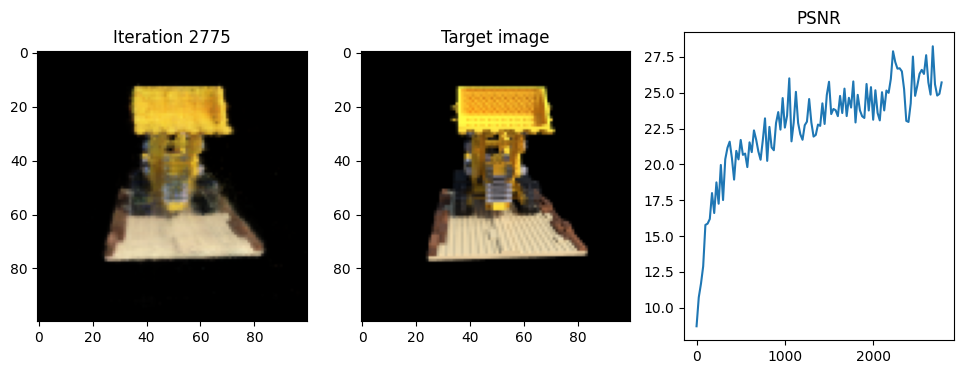

i 2776
i 2777
i 2778
i 2779
i 2780
i 2781
i 2782
i 2783
i 2784
i 2785
i 2786
i 2787
i 2788
i 2789
i 2790
i 2791
i 2792
i 2793
i 2794
i 2795
i 2796
i 2797
i 2798
i 2799
i 2800
Iteration 2800  Loss: 0.0035  PSNR: 25.17  Time: 2.02 secs per iter,  93.37 mins in total


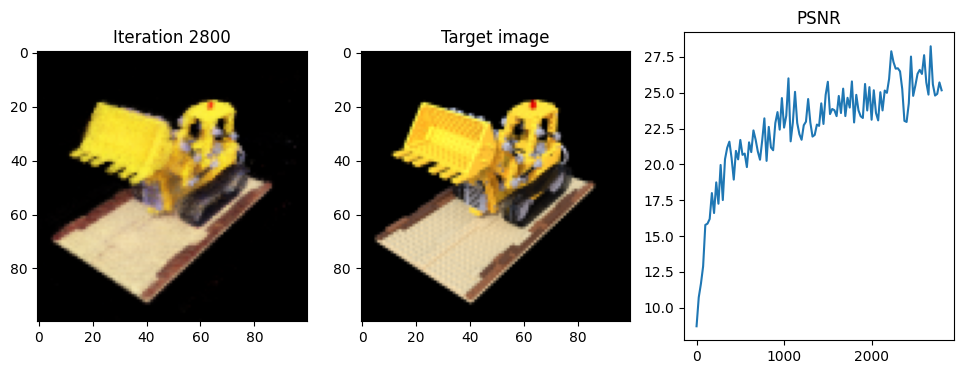

i 2801
i 2802
i 2803
i 2804
i 2805
i 2806
i 2807
i 2808
i 2809
i 2810
i 2811
i 2812
i 2813
i 2814
i 2815
i 2816
i 2817
i 2818
i 2819
i 2820
i 2821
i 2822
i 2823
i 2824
i 2825
Iteration 2825  Loss: 0.0015  PSNR: 24.00  Time: 1.99 secs per iter,  94.20 mins in total


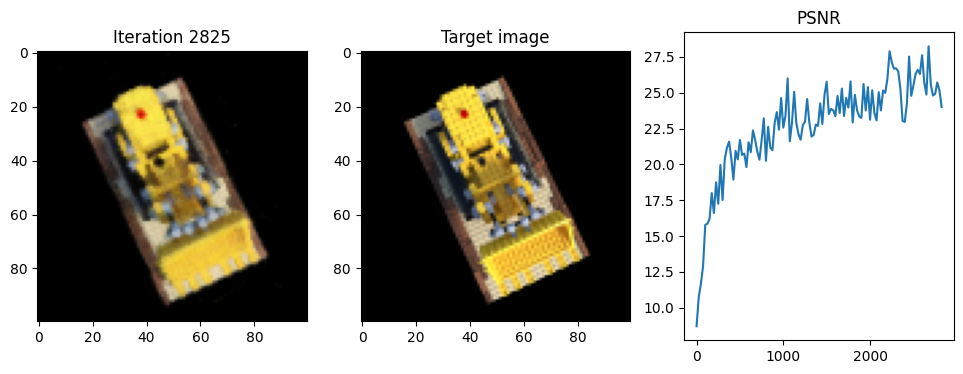

i 2826
i 2827
i 2828
i 2829
i 2830
i 2831
i 2832
i 2833
i 2834
i 2835
i 2836
i 2837
i 2838
i 2839
i 2840
i 2841
i 2842
i 2843
i 2844
i 2845
i 2846
i 2847
i 2848
i 2849
i 2850
Iteration 2850  Loss: 0.0046  PSNR: 27.77  Time: 2.00 secs per iter,  95.04 mins in total


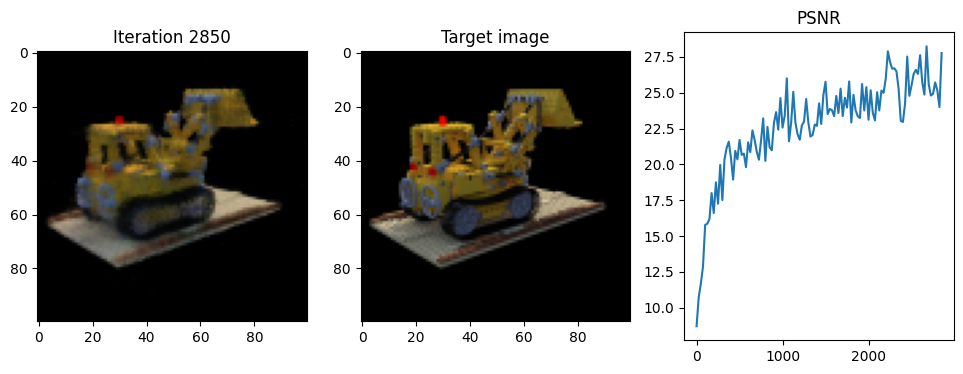

i 2851
i 2852
i 2853
i 2854
i 2855
i 2856
i 2857
i 2858
i 2859
i 2860
i 2861
i 2862
i 2863
i 2864
i 2865
i 2866
i 2867
i 2868
i 2869
i 2870
i 2871
i 2872
i 2873
i 2874
i 2875
Iteration 2875  Loss: 0.0042  PSNR: 23.52  Time: 2.00 secs per iter,  95.87 mins in total


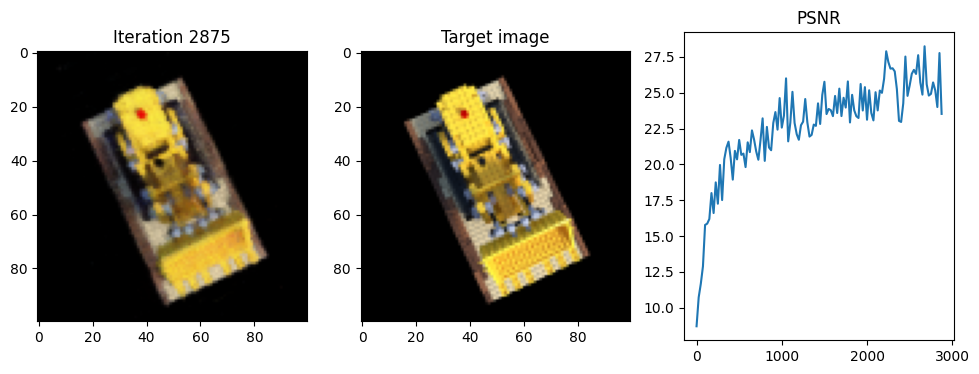

i 2876
i 2877
i 2878
i 2879
i 2880
i 2881
i 2882
i 2883
i 2884
i 2885
i 2886
i 2887
i 2888
i 2889
i 2890
i 2891
i 2892
i 2893
i 2894
i 2895
i 2896
i 2897
i 2898
i 2899
i 2900
Iteration 2900  Loss: 0.0033  PSNR: 26.78  Time: 1.99 secs per iter,  96.70 mins in total


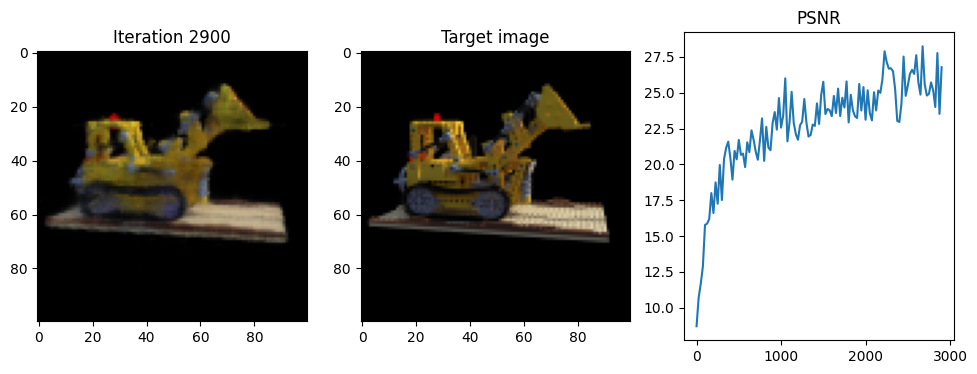

i 2901
i 2902
i 2903
i 2904
i 2905
i 2906
i 2907
i 2908
i 2909
i 2910
i 2911
i 2912
i 2913
i 2914
i 2915
i 2916
i 2917
i 2918
i 2919
i 2920
i 2921
i 2922
i 2923
i 2924
i 2925
Iteration 2925  Loss: 0.0021  PSNR: 27.15  Time: 2.00 secs per iter,  97.53 mins in total


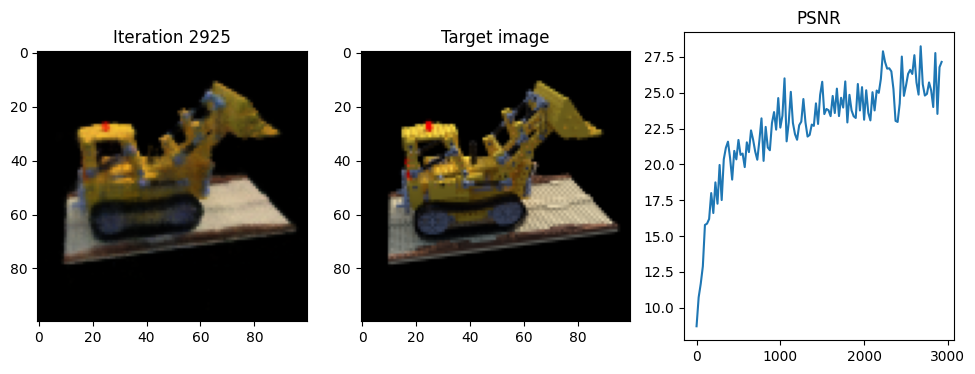

i 2926
i 2927
i 2928
i 2929
i 2930
i 2931
i 2932
i 2933
i 2934
i 2935
i 2936
i 2937
i 2938
i 2939
i 2940
i 2941
i 2942
i 2943
i 2944
i 2945
i 2946
i 2947
i 2948
i 2949
i 2950
Iteration 2950  Loss: 0.0016  PSNR: 24.05  Time: 2.00 secs per iter,  98.37 mins in total


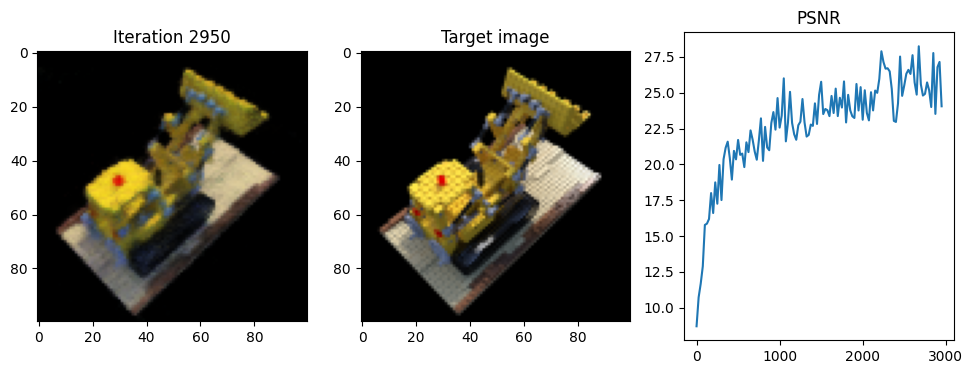

i 2951
i 2952
i 2953
i 2954
i 2955
i 2956
i 2957
i 2958
i 2959
i 2960
i 2961
i 2962
i 2963
i 2964
i 2965
i 2966
i 2967
i 2968
i 2969
i 2970
i 2971
i 2972
i 2973
i 2974
i 2975
Iteration 2975  Loss: 0.0019  PSNR: 24.23  Time: 2.00 secs per iter,  99.20 mins in total


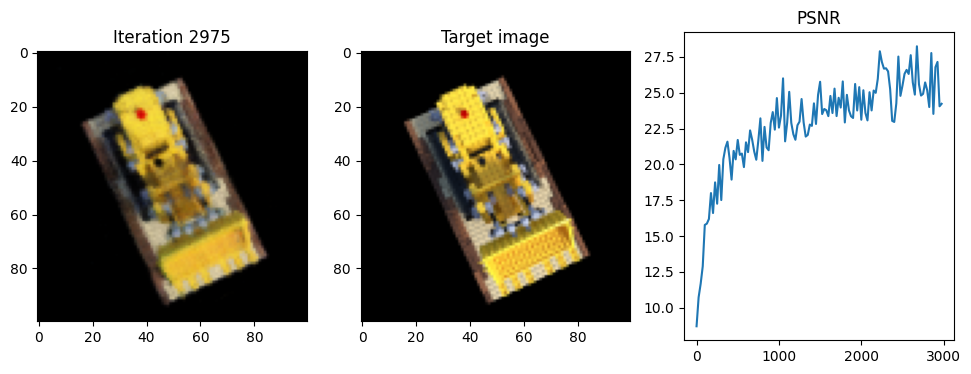

i 2976
i 2977
i 2978
i 2979
i 2980
i 2981
i 2982
i 2983
i 2984
i 2985
i 2986
i 2987
i 2988
i 2989
i 2990
i 2991
i 2992
i 2993
i 2994
i 2995
i 2996
i 2997
i 2998
i 2999
i 3000
Iteration 3000  Loss: 0.0037  PSNR: 24.78  Time: 2.01 secs per iter,  100.04 mins in total


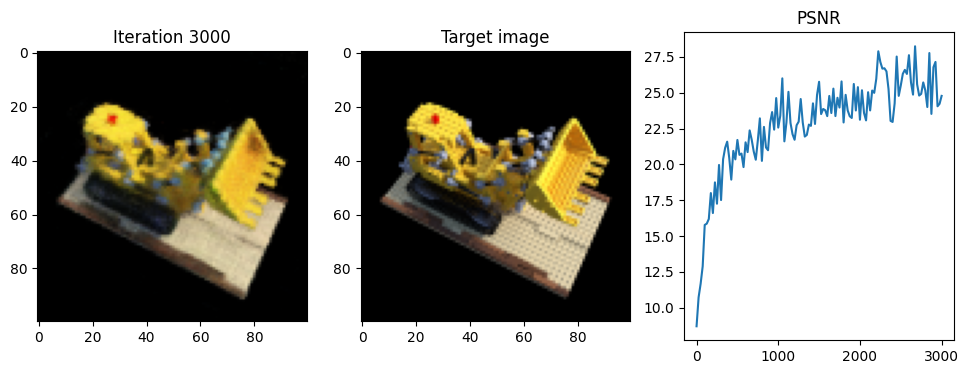

Done!


In [ ]:
for i in range(iterations+1):
    print("i",i)

    #############################  TODO 2.6 BEGIN  ############################
    num_samples=64
    l2_loss = torch.nn.MSELoss(reduction='mean')
     
    #choose randomly a picture for the forward pass
    ind = np.random.randint(images.shape[0])
    image, pose, intrinsics = images[ind], poses[ind], intrinsics
    image, pose, intrinsics = image.to(device), pose.to(device), intrinsics.to(device)
    # print("height image",image.shape[0])
    # print("width image",image.shape[1])





    # Run one iteration of NeRF and get the rendered RGB image.
    rendered_image = one_forward_pass(image.shape[0], image.shape[1], intrinsics, pose, near, far, 
                                           num_samples, model, num_x_frequencies, num_d_frequencies)
        
       



    # Compute mean-squared error between the predicted and target images. Backprop!
    
    loss = l2_loss(rendered_image, image)
    optimizer.zero_grad()
    loss.backward()
    optimizer.step()





    #############################  TODO 2.6 END  ############################

    # Display images/plots/stats
    if i % display == 0:
        with torch.no_grad():
        #############################  TODO 2.6 BEGIN  ############################
            # Render the held-out view    
            test_ind = np.random.randint(images.shape[0])
            test_image, test_pose, test_intrinsics = images[test_ind], poses[test_ind], intrinsics
            test_image, test_pose, test_intrinsics = test_image.to(device), test_pose.to(device), test_intrinsics.to(device)
            test_rec_image = one_forward_pass(test_image.shape[0], test_image.shape[1], test_intrinsics, 
                                               test_pose, near, far, num_samples, model, num_x_frequencies, num_d_frequencies)





        #calculate the loss and the psnr between the original test image and the reconstructed one. 
        test_loss = l2_loss(test_rec_image, test_image)
        psnr = 10 * torch.log10(1. / test_loss)


        #############################  TODO 2.6 END  ############################

        print("Iteration %d " % i, "Loss: %.4f " % loss.item(), "PSNR: %.2f " % psnr.item(), \
                "Time: %.2f secs per iter, " % ((time.time() - t) / display), "%.2f mins in total" % ((time.time() - t0)/60))
        
        t = time.time()    
        psnrs.append(psnr.item())
        iternums.append(i)

        plt.figure(figsize=(16, 4))
        plt.subplot(141)
        plt.imshow(test_rec_image.detach().cpu().numpy())
        plt.title(f"Iteration {i}")
        plt.subplot(142)
        plt.imshow(test_image.detach().cpu().numpy())
        plt.title("Target image")
        plt.subplot(143)
        plt.plot(iternums, psnrs)
        plt.title("PSNR")
        plt.show()

print('Done!') 